# Malaria Detection

This is a malaria detection approach using Keras for CNN

Malaria is a life-threatening disease caused by parasites that are transmitted to people through the bites of infected female Anopheles mosquitoes. It is preventable and curable.

In 2017, there were an estimated 219 million cases of malaria in 90 countries.
Malaria deaths reached 435 000 in 2017.
The WHO African Region carries a disproportionately high share of the global malaria burden. In 2017, the region was home to 92% of malaria cases and 93% of malaria deaths.
Malaria is caused by Plasmodium parasites. The parasites are spread to people through the bites of infected female Anopheles mosquitoes, called "malaria vectors." There are 5 parasite species that cause malaria in humans, and 2 of these species – P. falciparum and P. vivax – pose the greatest threat.

Diagnosis of malaria can be difficult:

Where malaria is not endemic any more (such as in the United States), health-care providers may not be familiar with the disease. Clinicians seeing a malaria patient may forget to consider malaria among the potential diagnoses and not order the needed diagnostic tests. Laboratorians may lack experience with malaria and fail to detect parasites when examining blood smears under the microscope.

Malaria is an acute febrile illness. In a non-immune individual, symptoms usually appear 10–15 days after the infective mosquito bite. The first symptoms – fever, headache, and chills – may be mild and difficult to recognize as malaria. If not treated within 24 hours, P. falciparum malaria can progress to severe illness, often leading to death.

Microscopic Diagnosis
Malaria parasites can be identified by examining under the microscope a drop of the patient’s blood, spread out as a “blood smear” on a microscope slide. Prior to examination, the specimen is stained to give the parasites a distinctive appearance. This technique remains the gold standard for laboratory confirmation of malaria. However, it depends on the quality of the reagents, of the microscope, and on the experience of the laboratorian.


references :
[1] https://www.who.int/news-room/fact-sheets/detail/malaria
[2] https://www.cdc.gov/malaria/diagnosis_treatment/diagnosis.html

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import shutil
import os

In [2]:
print(os.listdir("cell_images/cell_images/"))

['Uninfected', 'Parasitized']


In [3]:
base_dir='cell_images/cell_images/'
work_dir=  "work/"
os.mkdir(work_dir)

In [4]:
base_dir_A ='cell_images/cell_images/Parasitized/'
base_dir_B ='cell_images/cell_images/Uninfected/'

work_dir_A = "work/A/"
os.mkdir(work_dir_A)
work_dir_B = "work/B/"
os.mkdir(work_dir_B)

In [5]:
train_dir = os.path.join(work_dir, 'train')
os.mkdir(train_dir)

validation_dir = os.path.join(work_dir, 'validation')
os.mkdir(validation_dir)

test_dir = os.path.join(work_dir, 'test')
os.mkdir(test_dir)

print("New directories for train, validation, and test created")
train_pos_dir = os.path.join(train_dir, 'pos')
os.mkdir(train_pos_dir)
train_neg_dir = os.path.join(train_dir, 'neg')
os.mkdir(train_neg_dir)

validation_pos_dir = os.path.join(validation_dir, 'pos')
os.mkdir(validation_pos_dir)
validation_neg_dir = os.path.join(validation_dir, 'neg')
os.mkdir(validation_neg_dir)

test_pos_dir = os.path.join(test_dir, 'pos')
os.mkdir(test_pos_dir)
test_neg_dir = os.path.join(test_dir, 'neg')
os.mkdir(test_neg_dir)

print("Train, Validation, and Test folders made for both A and B datasets")

New directories for train, validation, and test created
Train, Validation, and Test folders made for both A and B datasets


In [6]:
i = 0
      
for filename in os.listdir(base_dir_A): 
       dst ="pos" + str(i) + ".jpg"
       src =base_dir_A + filename 
       dst =work_dir_A + dst 
       shutil.copy(src, dst) 
       i += 1


       
j = 0
      
for filename in os.listdir(base_dir_B): 
       dst ="neg" + str(j) + ".jpg"
       src =base_dir_B + filename 
       dst =work_dir_B + dst  
       shutil.copy(src, dst) 
       j += 1       
        
print("Images for both categories have been copied to working directories, renamed to A & B + num")

Images for both categories have been copied to working directories, renamed to A & B + num


In [7]:
fnames = ['pos{}.jpg'.format(i) for i in range(3000)]
for fname in fnames:
    src = os.path.join(work_dir_A, fname)
    dst = os.path.join(train_pos_dir, fname)
    shutil.copyfile(src, dst)

fnames = ['pos{}.jpg'.format(i) for i in range(3000, 4000)]
for fname in fnames:
    src = os.path.join(work_dir_A, fname)
    dst = os.path.join(validation_pos_dir, fname)
    shutil.copyfile(src, dst)

fnames = ['pos{}.jpg'.format(i) for i in range(4000, 4500)]
for fname in fnames:
    src = os.path.join(work_dir_A, fname)
    dst = os.path.join(test_pos_dir, fname)
    shutil.copyfile(src, dst)
    


fnames = ['neg{}.jpg'.format(i) for i in range(3000)]
for fname in fnames:
    src = os.path.join(work_dir_B, fname)
    dst = os.path.join(train_neg_dir, fname)
    shutil.copyfile(src, dst)

fnames = ['neg{}.jpg'.format(i) for i in range(3000, 4000)]
for fname in fnames:
    src = os.path.join(work_dir_B, fname)
    dst = os.path.join(validation_neg_dir, fname)
    shutil.copyfile(src, dst)

fnames = ['neg{}.jpg'.format(i) for i in range(4000, 4500)]
for fname in fnames:
    src = os.path.join(work_dir_B, fname)
    dst = os.path.join(test_neg_dir, fname)
    shutil.copyfile(src, dst)
    
print("Train, validation, and test datasets split and ready for use")
print('total training pos images:', len(os.listdir(train_pos_dir)))
print('total training neg images:', len(os.listdir(train_neg_dir)))
print('total validation pos images:', len(os.listdir(validation_pos_dir)))
print('total validation neg images:', len(os.listdir(validation_neg_dir)))
print('total test pos images:', len(os.listdir(test_pos_dir)))
print('total test meg images:', len(os.listdir(test_neg_dir)))

Train, validation, and test datasets split and ready for use
total training pos images: 3000
total training neg images: 3000
total validation pos images: 1000
total validation neg images: 1000
total test pos images: 500
total test meg images: 500


In [8]:
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(150, 150),
        batch_size=20,
        class_mode='binary')
validation_generator = test_datagen.flow_from_directory(
        validation_dir,target_size=(150, 150),
        batch_size=20,
        class_mode='binary')

print("Image preprocessing complete")



Using TensorFlow backend.


Found 6000 images belonging to 2 classes.
Found 2000 images belonging to 2 classes.
Image preprocessing complete


In [9]:
from keras import layers
from keras import models

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',
                        input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))
model.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 17, 17, 128)       0         
______________________________________

In [10]:
from keras import optimizers

model.compile(loss='binary_crossentropy',optimizer=optimizers.RMSprop(lr=1e-5),
metrics=['acc'])

print("Model created")

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Model created


In [11]:
history = model.fit_generator(
        train_generator,
        steps_per_epoch=100,
        epochs=30,
        validation_data=validation_generator,
        validation_steps=200)
model.save('basic_malaria_pos_neg_v1.h5')
print("Model saved")


Epoch 1/30
100/100 [==============================] - 72s 722ms/step - loss: 0.6903 - acc: 0.5290 - val_loss: 0.6843 - val_acc: 0.5950
Epoch 2/30
100/100 [==============================] - 73s 727ms/step - loss: 0.6839 - acc: 0.5850 - val_loss: 0.6709 - val_acc: 0.6385
Epoch 3/30
100/100 [==============================] - 73s 726ms/step - loss: 0.6751 - acc: 0.6145 - val_loss: 0.6529 - val_acc: 0.6380
Epoch 4/30
100/100 [==============================] - 74s 739ms/step - loss: 0.6565 - acc: 0.6325 - val_loss: 0.6023 - val_acc: 0.6545
Epoch 5/30
100/100 [==============================] - 69s 690ms/step - loss: 0.6492 - acc: 0.6345 - val_loss: 0.6020 - val_acc: 0.6790
Epoch 6/30
100/100 [==============================] - 74s 744ms/step - loss: 0.6386 - acc: 0.6400 - val_loss: 0.5986 - val_acc: 0.6680
Epoch 7/30
100/100 [==============================] - 77s 766ms/step - loss: 0.6270 - acc: 0.6465 - val_loss: 0.4786 - val_acc: 0.6700
Epoch 8/30
100/100 [==============================] - 

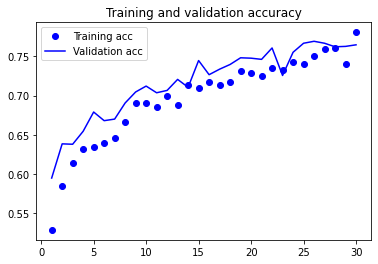

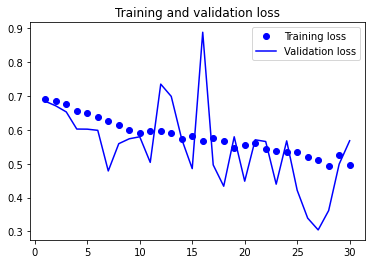

In [12]:
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()


Found 1000 images belonging to 2 classes.
1000/1000 [==============================] - 126s 126ms/step
Predictions finished
neg/neg4000.jpg


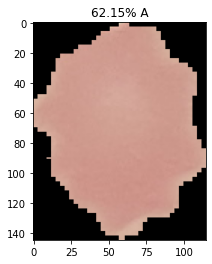

neg/neg4001.jpg


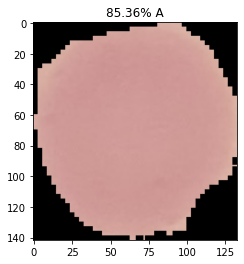

neg/neg4002.jpg


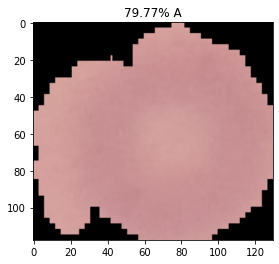

neg/neg4003.jpg


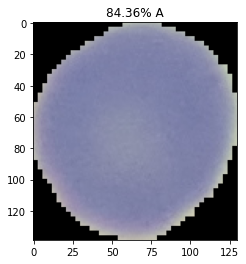

neg/neg4004.jpg


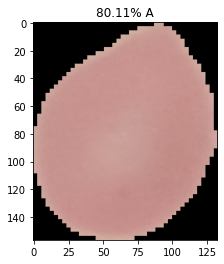

neg/neg4005.jpg


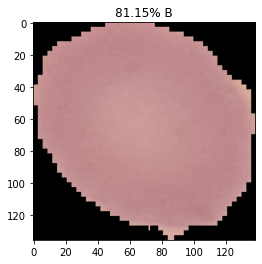

neg/neg4006.jpg


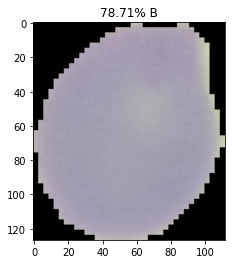

neg/neg4007.jpg


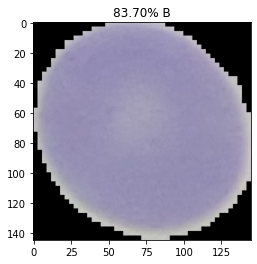

neg/neg4008.jpg


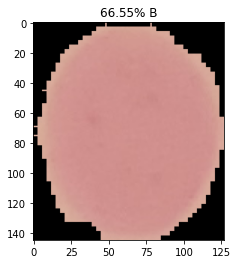

neg/neg4009.jpg


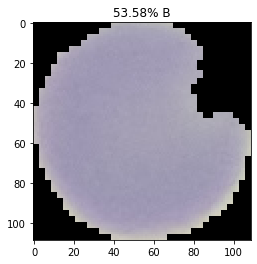

neg/neg4010.jpg


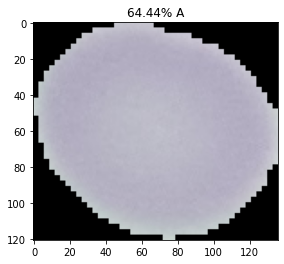

neg/neg4011.jpg


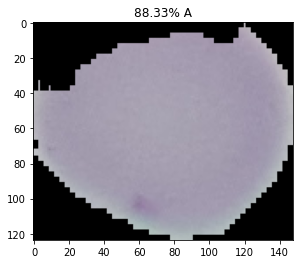

neg/neg4012.jpg


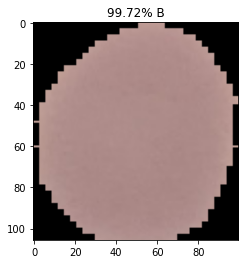

neg/neg4013.jpg


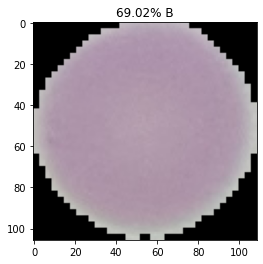

neg/neg4014.jpg


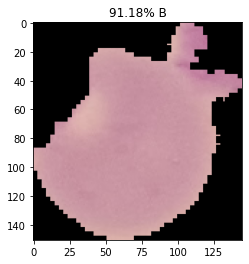

neg/neg4015.jpg


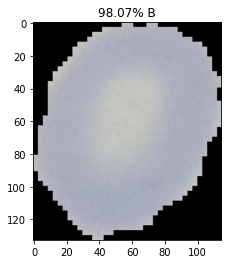

neg/neg4016.jpg


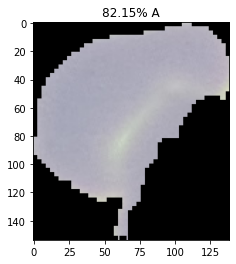

neg/neg4017.jpg


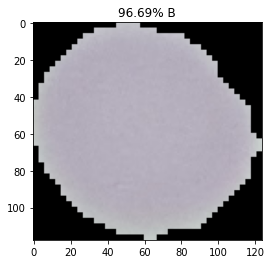

neg/neg4018.jpg


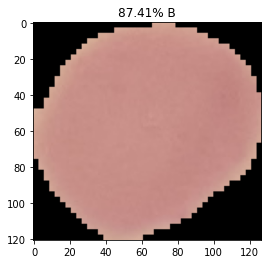

neg/neg4019.jpg


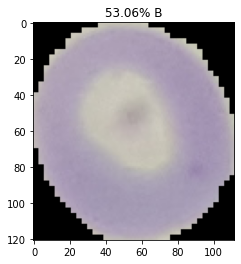

neg/neg4020.jpg


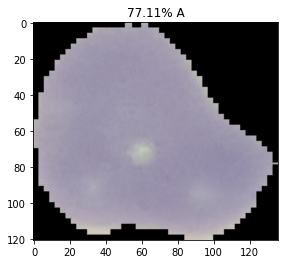

neg/neg4021.jpg


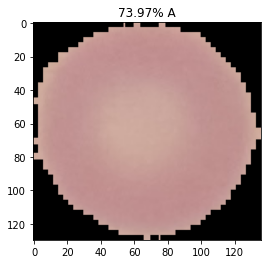

neg/neg4022.jpg


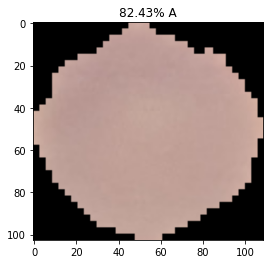

neg/neg4023.jpg


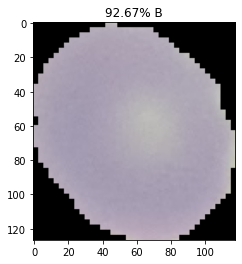

neg/neg4024.jpg


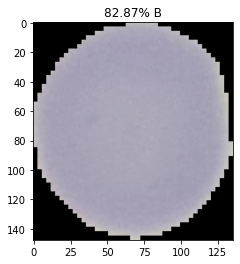

neg/neg4025.jpg


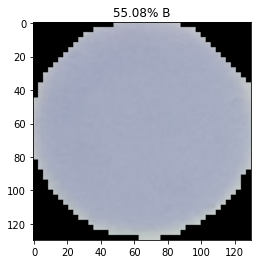

neg/neg4026.jpg


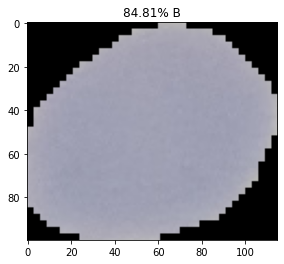

neg/neg4027.jpg


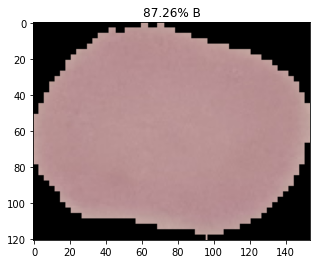

neg/neg4028.jpg


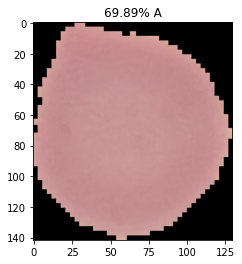

neg/neg4029.jpg


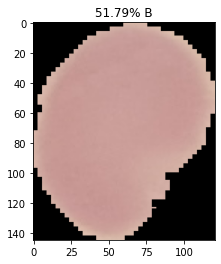

neg/neg4030.jpg


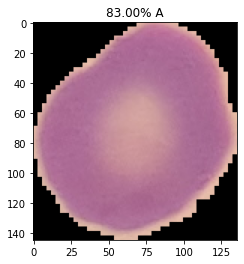

neg/neg4031.jpg


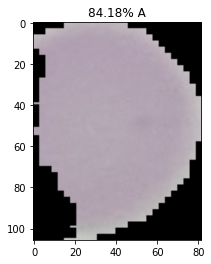

neg/neg4032.jpg


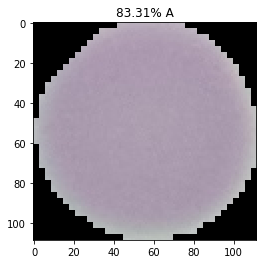

neg/neg4033.jpg


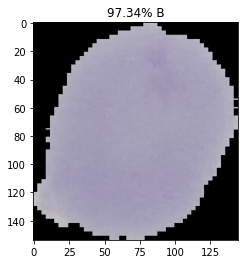

neg/neg4034.jpg


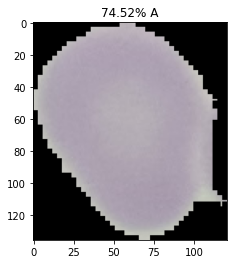

neg/neg4035.jpg


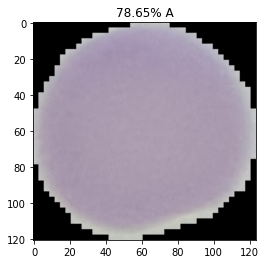

neg/neg4036.jpg


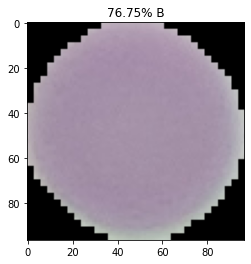

neg/neg4037.jpg


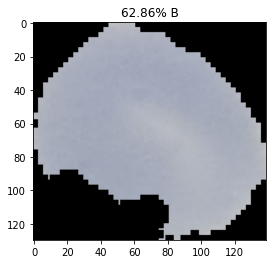

neg/neg4038.jpg


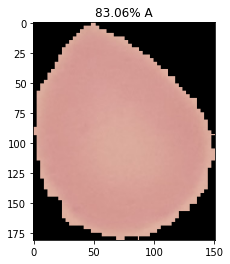

neg/neg4039.jpg


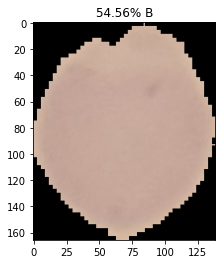

neg/neg4040.jpg


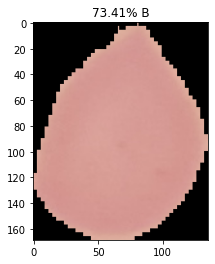

neg/neg4041.jpg


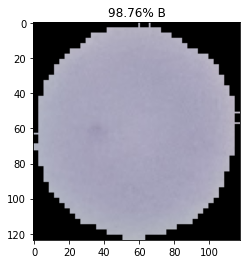

neg/neg4042.jpg


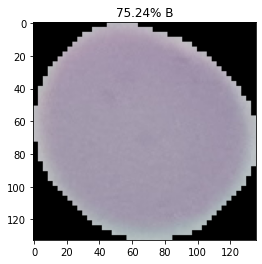

neg/neg4043.jpg


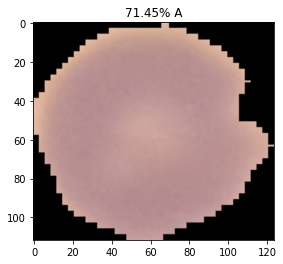

neg/neg4044.jpg


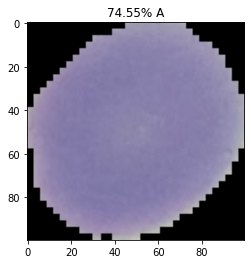

neg/neg4045.jpg


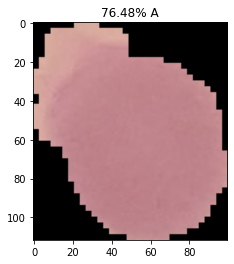

neg/neg4046.jpg


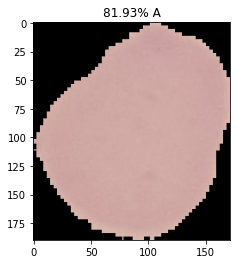

neg/neg4047.jpg


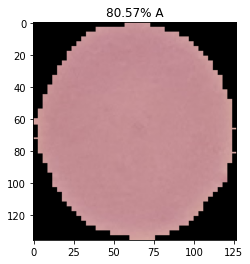

neg/neg4048.jpg


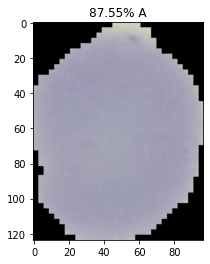

neg/neg4049.jpg


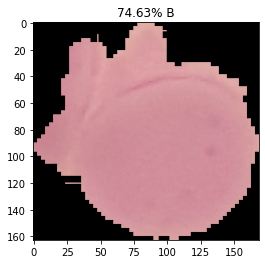

neg/neg4050.jpg


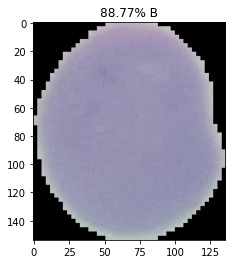

neg/neg4051.jpg


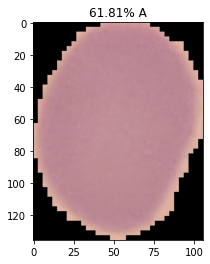

neg/neg4052.jpg


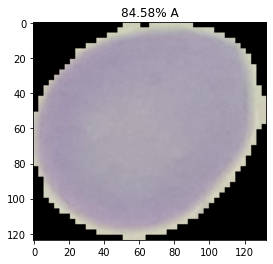

neg/neg4053.jpg


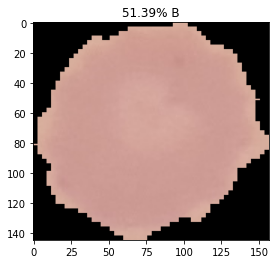

neg/neg4054.jpg


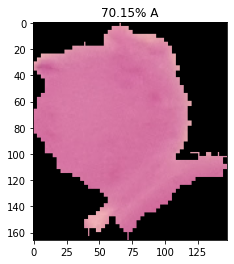

neg/neg4055.jpg


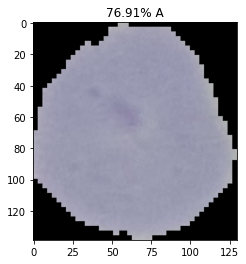

neg/neg4056.jpg


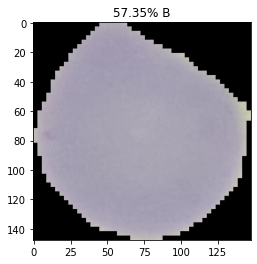

neg/neg4057.jpg


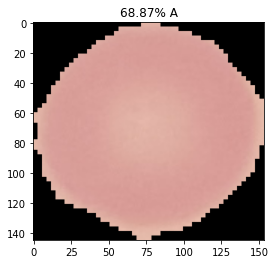

neg/neg4058.jpg


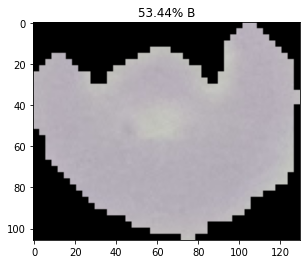

neg/neg4059.jpg


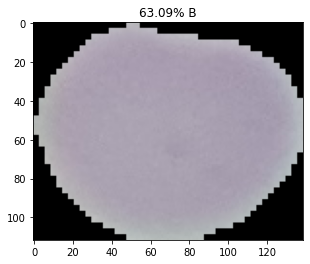

neg/neg4060.jpg


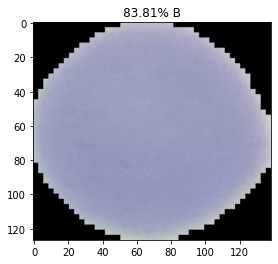

neg/neg4061.jpg


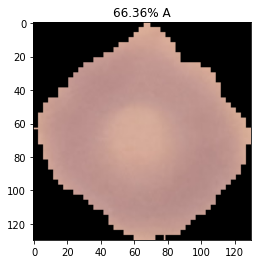

neg/neg4062.jpg


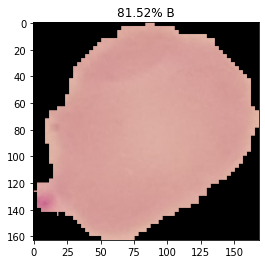

neg/neg4063.jpg


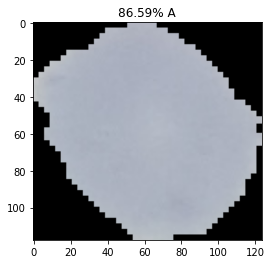

neg/neg4064.jpg


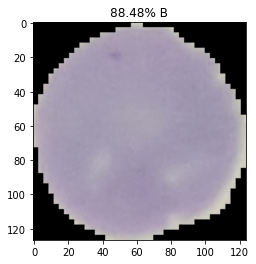

neg/neg4065.jpg


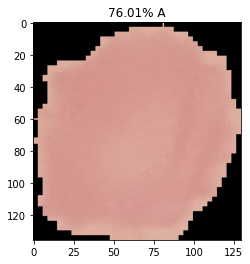

neg/neg4066.jpg


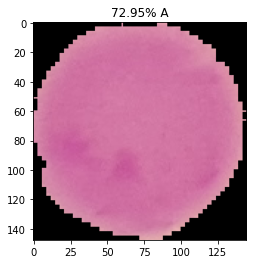

neg/neg4067.jpg


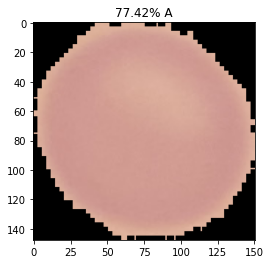

neg/neg4068.jpg


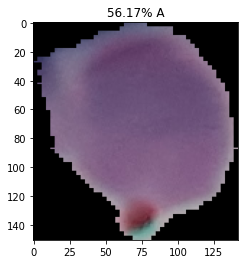

neg/neg4069.jpg


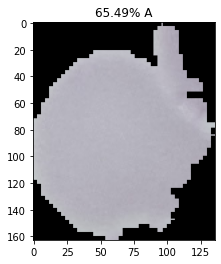

neg/neg4070.jpg


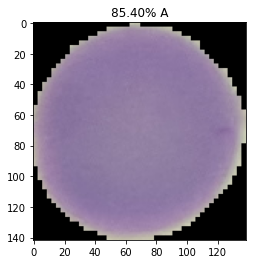

neg/neg4071.jpg


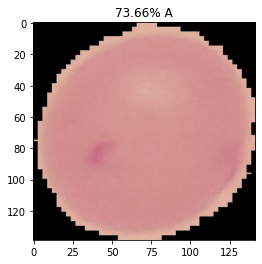

neg/neg4072.jpg


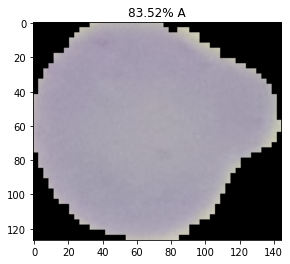

neg/neg4073.jpg


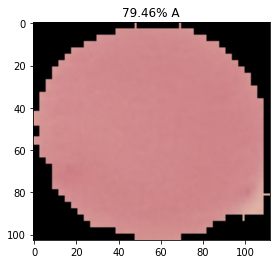

neg/neg4074.jpg


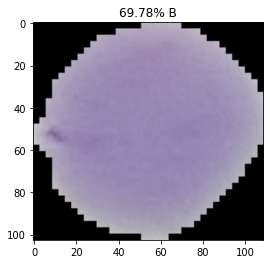

neg/neg4075.jpg


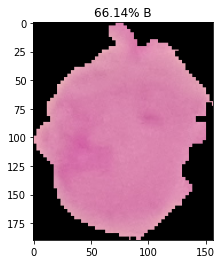

neg/neg4076.jpg


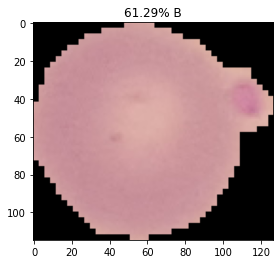

neg/neg4077.jpg


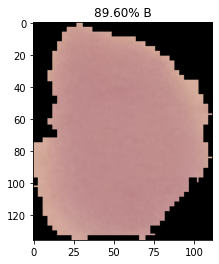

neg/neg4078.jpg


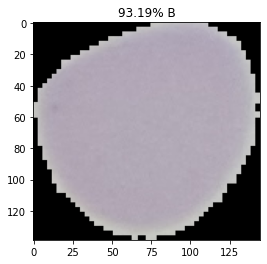

neg/neg4079.jpg


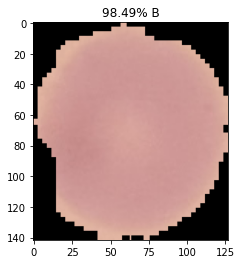

neg/neg4080.jpg


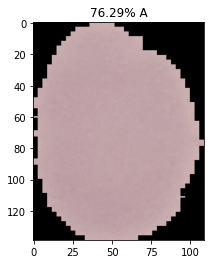

neg/neg4081.jpg


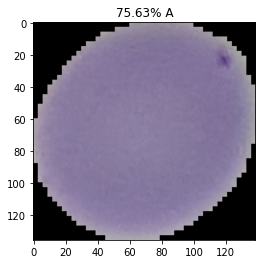

neg/neg4082.jpg


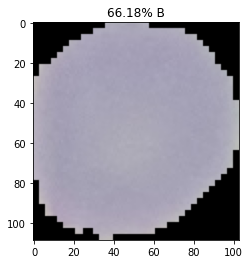

neg/neg4083.jpg


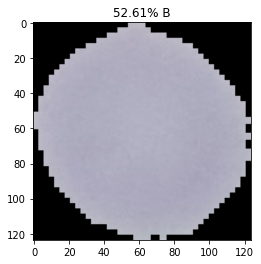

neg/neg4084.jpg


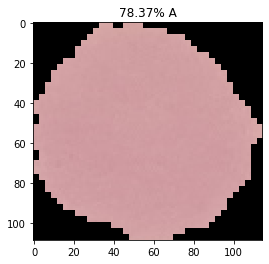

neg/neg4085.jpg


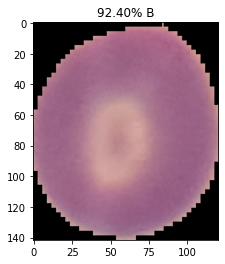

neg/neg4086.jpg


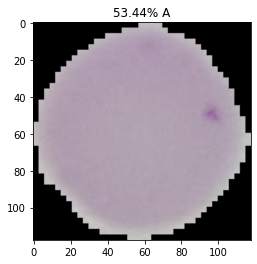

neg/neg4087.jpg


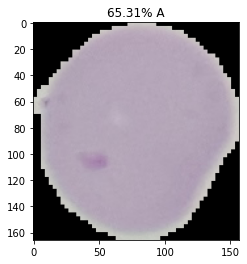

neg/neg4088.jpg


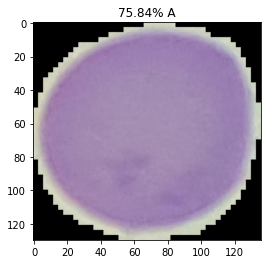

neg/neg4089.jpg


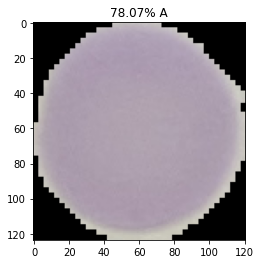

neg/neg4090.jpg


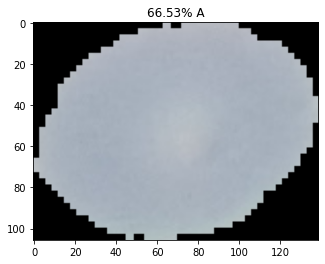

neg/neg4091.jpg


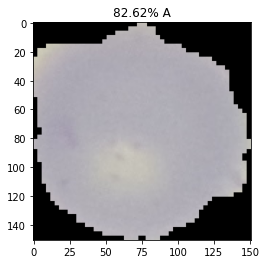

neg/neg4092.jpg


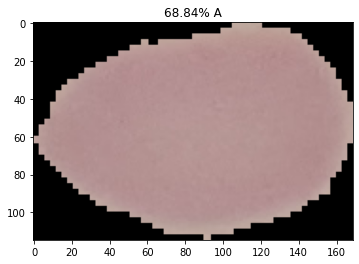

neg/neg4093.jpg


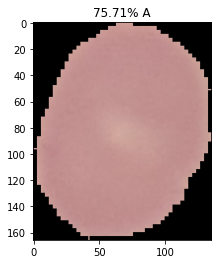

neg/neg4094.jpg


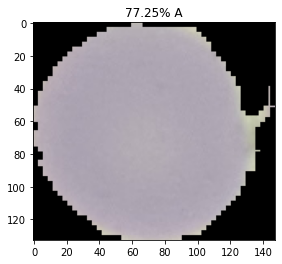

neg/neg4095.jpg


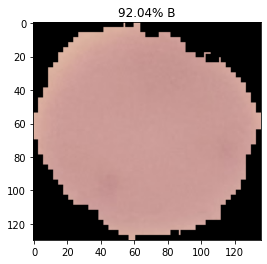

neg/neg4096.jpg


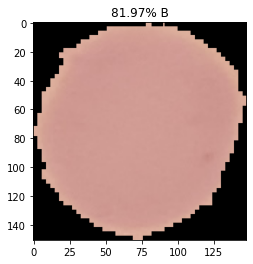

neg/neg4097.jpg


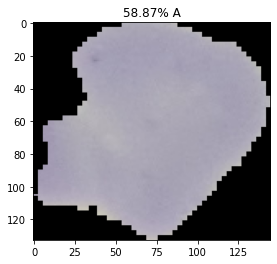

neg/neg4098.jpg


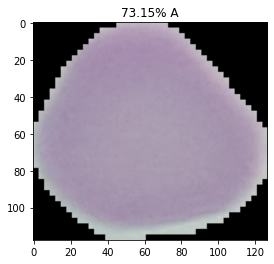

neg/neg4099.jpg


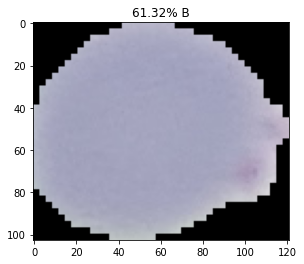

neg/neg4100.jpg


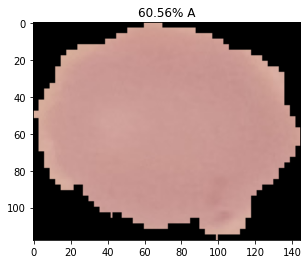

neg/neg4101.jpg


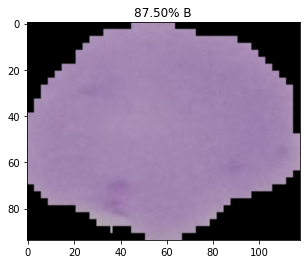

neg/neg4102.jpg


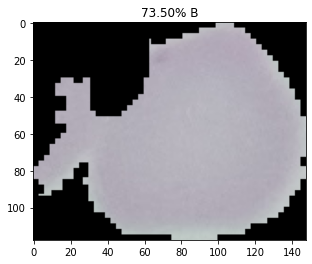

neg/neg4103.jpg


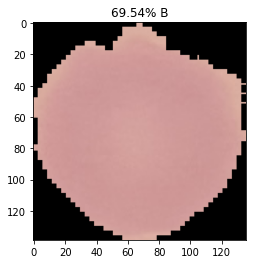

neg/neg4104.jpg


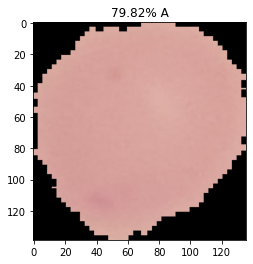

neg/neg4105.jpg


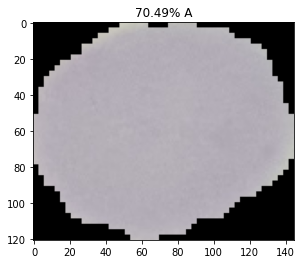

neg/neg4106.jpg


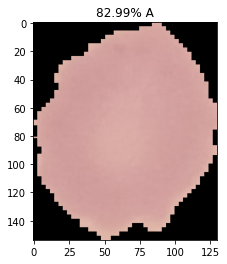

neg/neg4107.jpg


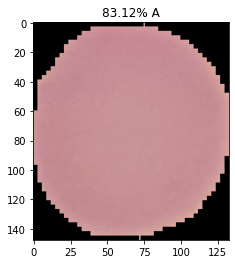

neg/neg4108.jpg


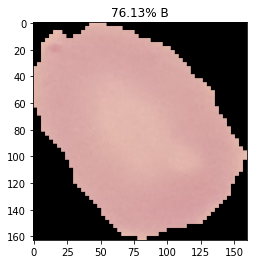

neg/neg4109.jpg


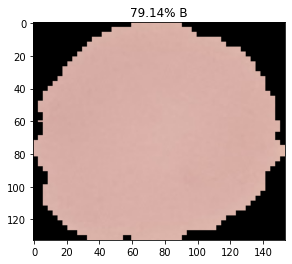

neg/neg4110.jpg


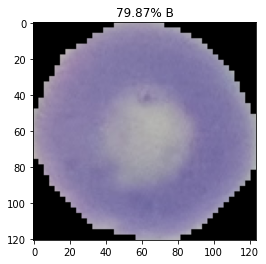

neg/neg4111.jpg


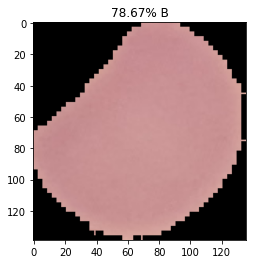

neg/neg4112.jpg


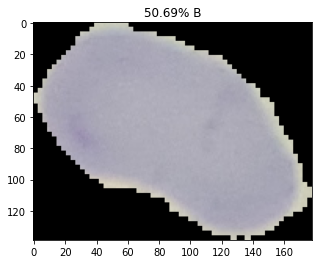

neg/neg4113.jpg


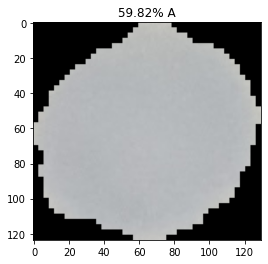

neg/neg4114.jpg


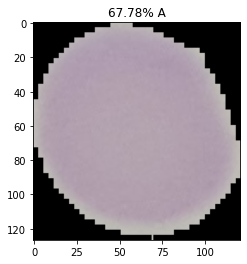

neg/neg4115.jpg


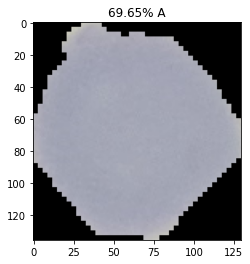

neg/neg4116.jpg


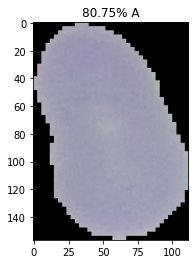

neg/neg4117.jpg


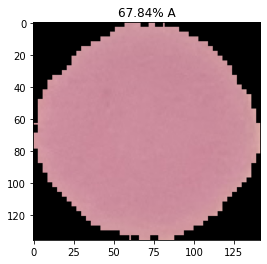

neg/neg4118.jpg


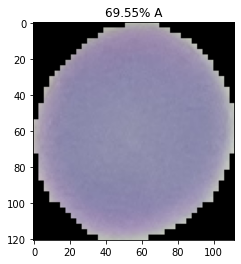

neg/neg4119.jpg


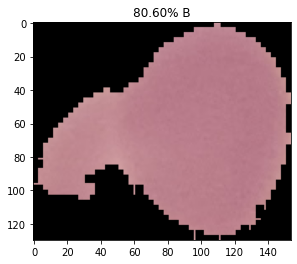

neg/neg4120.jpg


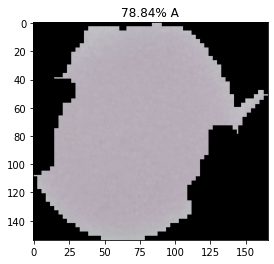

neg/neg4121.jpg


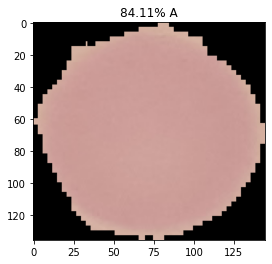

neg/neg4122.jpg


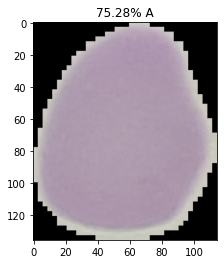

neg/neg4123.jpg


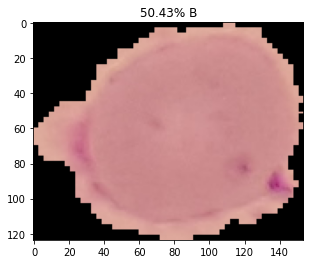

neg/neg4124.jpg


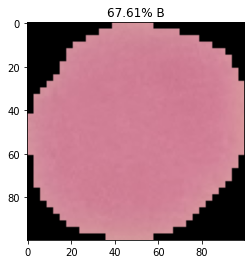

neg/neg4125.jpg


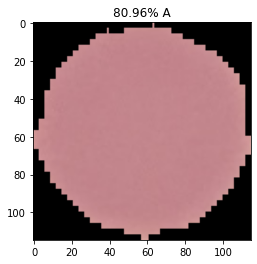

neg/neg4126.jpg


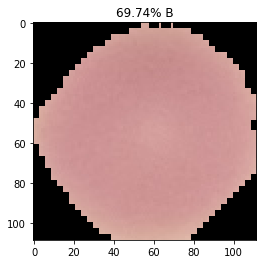

neg/neg4127.jpg


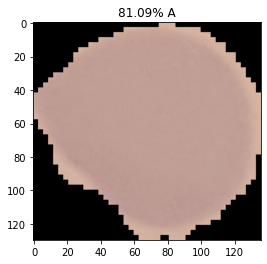

neg/neg4128.jpg


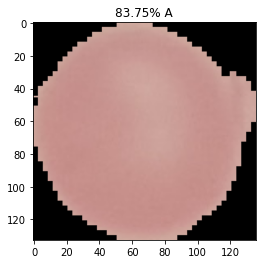

neg/neg4129.jpg


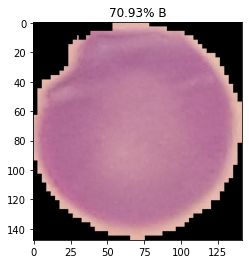

neg/neg4130.jpg


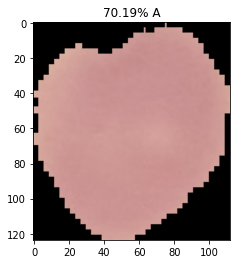

neg/neg4131.jpg


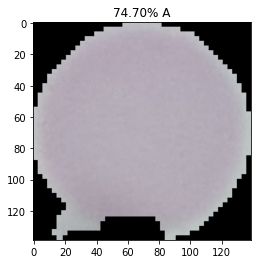

neg/neg4132.jpg


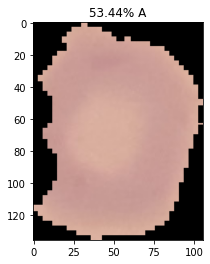

neg/neg4133.jpg


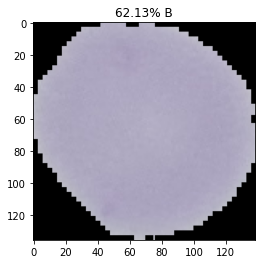

neg/neg4134.jpg


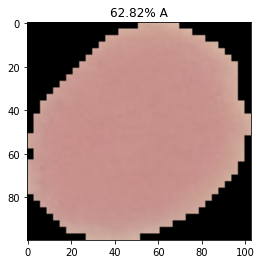

neg/neg4135.jpg


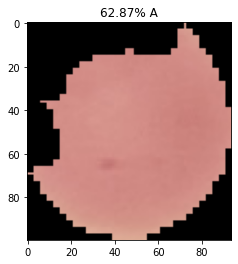

neg/neg4136.jpg


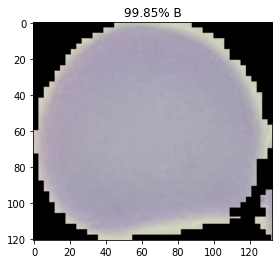

neg/neg4137.jpg


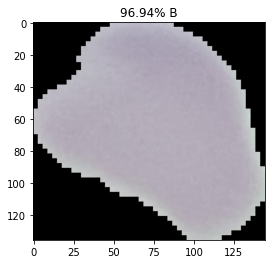

neg/neg4138.jpg


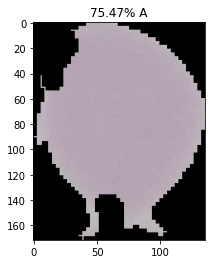

neg/neg4139.jpg


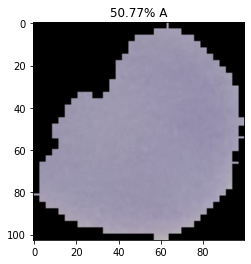

neg/neg4140.jpg


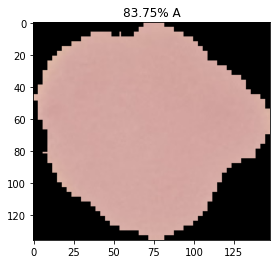

neg/neg4141.jpg


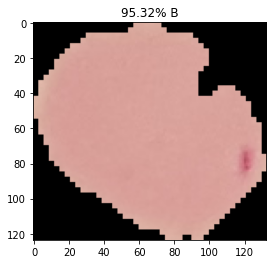

neg/neg4142.jpg


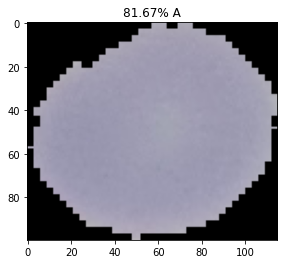

neg/neg4143.jpg


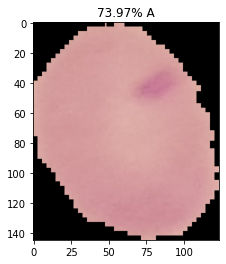

neg/neg4144.jpg


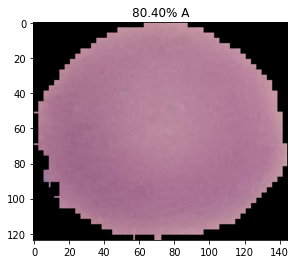

neg/neg4145.jpg


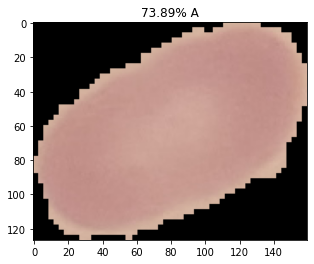

neg/neg4146.jpg


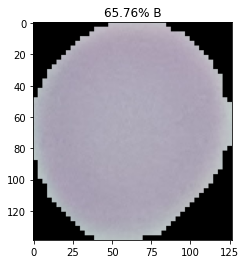

neg/neg4147.jpg


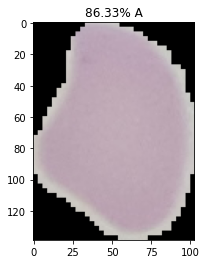

neg/neg4148.jpg


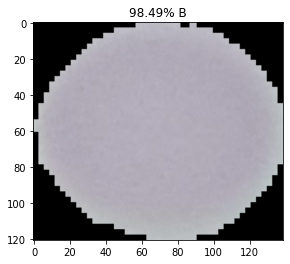

neg/neg4149.jpg


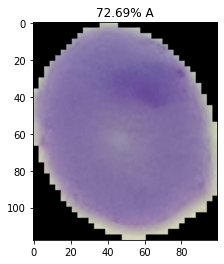

neg/neg4150.jpg


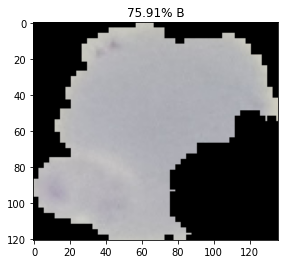

neg/neg4151.jpg


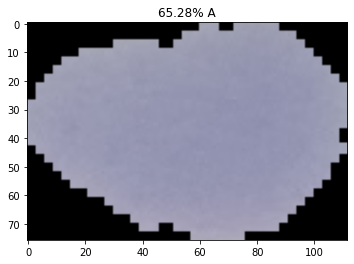

neg/neg4152.jpg


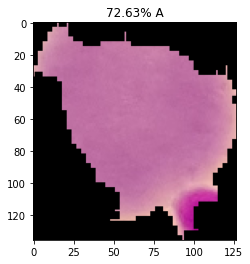

neg/neg4153.jpg


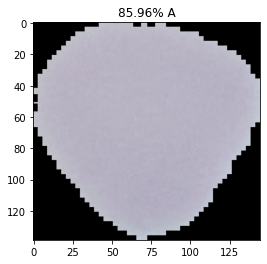

neg/neg4154.jpg


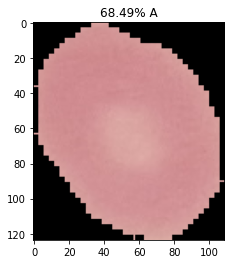

neg/neg4155.jpg


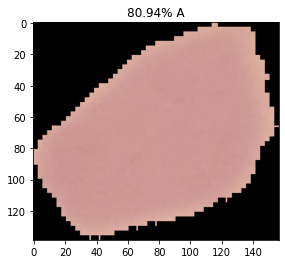

neg/neg4156.jpg


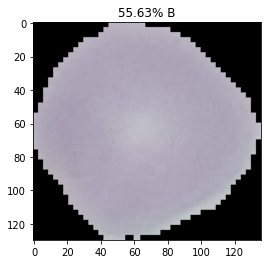

neg/neg4157.jpg


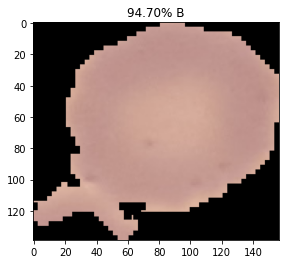

neg/neg4158.jpg


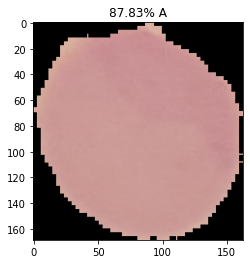

neg/neg4159.jpg


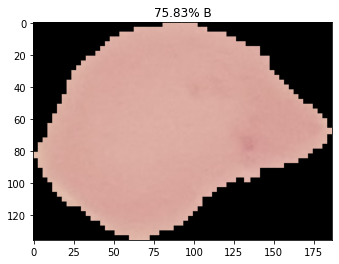

neg/neg4160.jpg


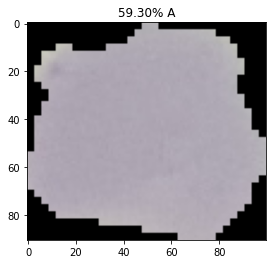

neg/neg4161.jpg


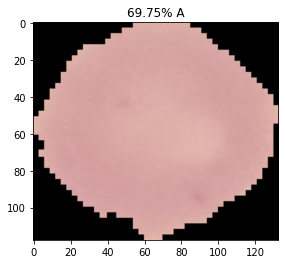

neg/neg4162.jpg


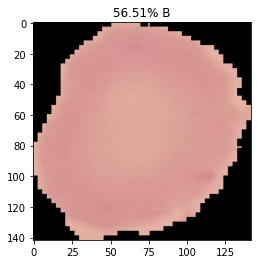

neg/neg4163.jpg


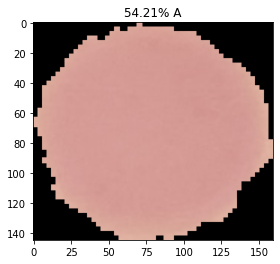

neg/neg4164.jpg


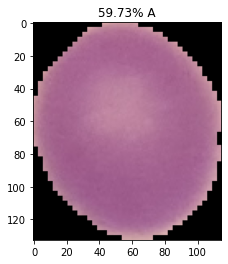

neg/neg4165.jpg


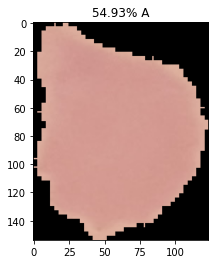

neg/neg4166.jpg


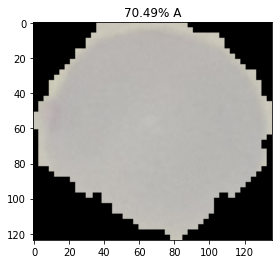

neg/neg4167.jpg


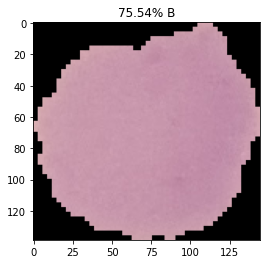

neg/neg4168.jpg


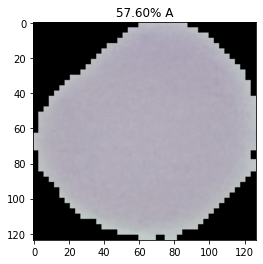

neg/neg4169.jpg


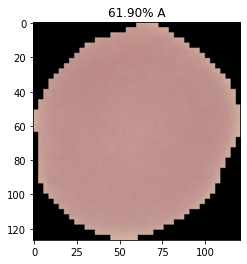

neg/neg4170.jpg


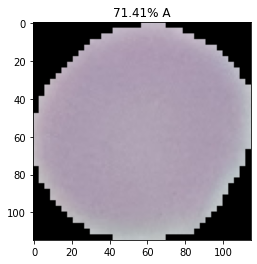

neg/neg4171.jpg


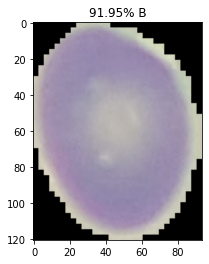

neg/neg4172.jpg


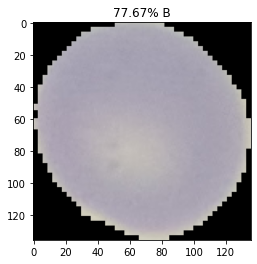

neg/neg4173.jpg


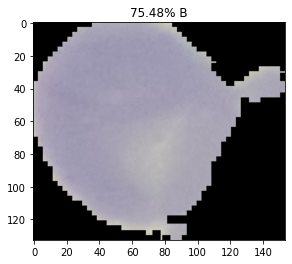

neg/neg4174.jpg


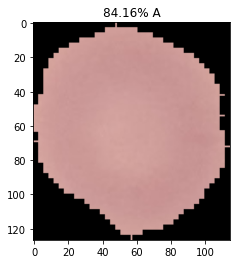

neg/neg4175.jpg


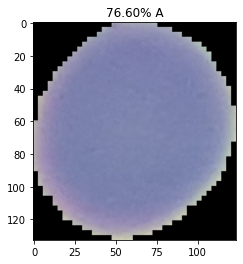

neg/neg4176.jpg


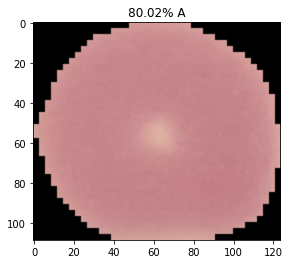

neg/neg4177.jpg


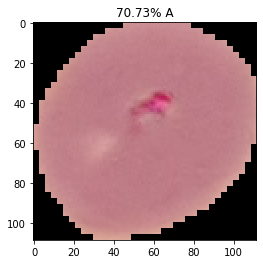

neg/neg4178.jpg


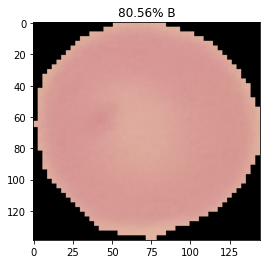

neg/neg4179.jpg


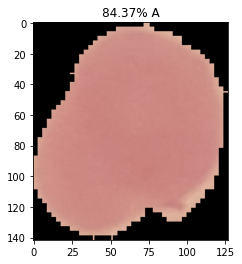

neg/neg4180.jpg


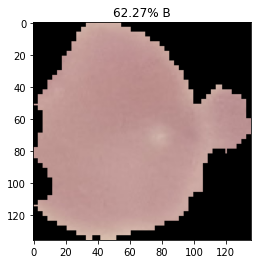

neg/neg4181.jpg


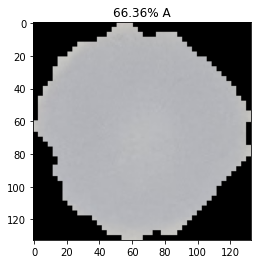

neg/neg4182.jpg


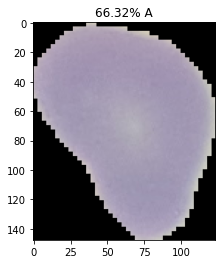

neg/neg4183.jpg


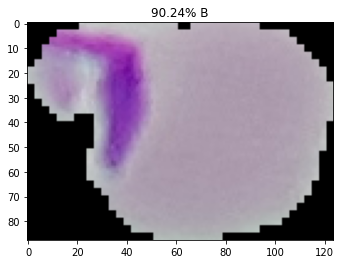

neg/neg4184.jpg


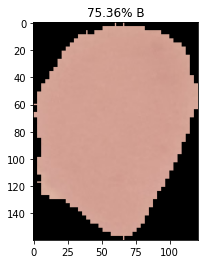

neg/neg4185.jpg


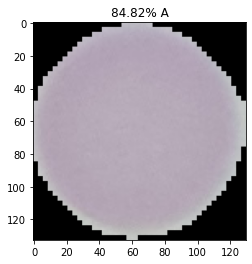

neg/neg4186.jpg


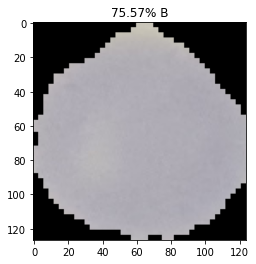

neg/neg4187.jpg


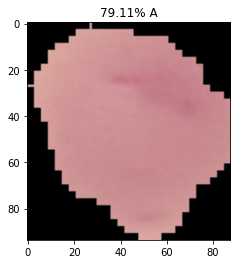

neg/neg4188.jpg


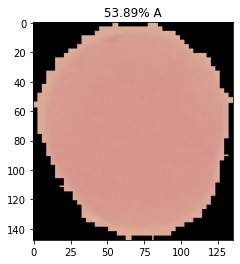

neg/neg4189.jpg


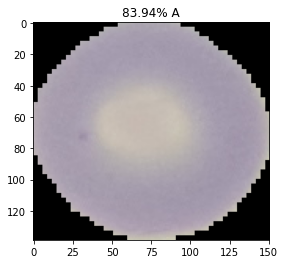

neg/neg4190.jpg


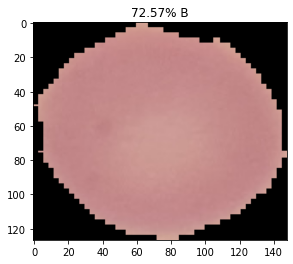

neg/neg4191.jpg


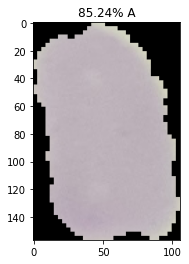

neg/neg4192.jpg


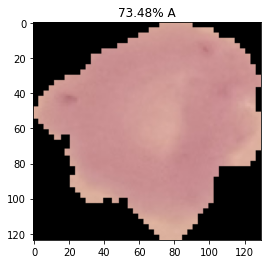

neg/neg4193.jpg


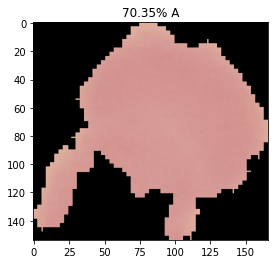

neg/neg4194.jpg


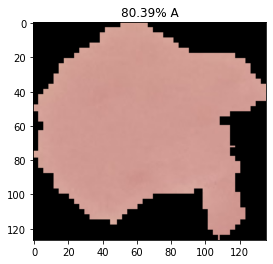

neg/neg4195.jpg


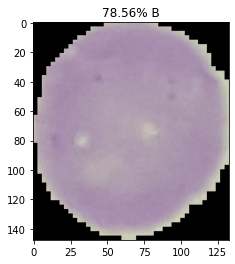

neg/neg4196.jpg


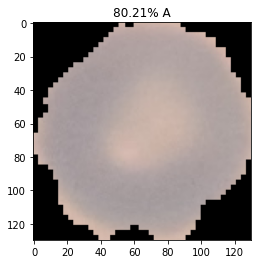

neg/neg4197.jpg


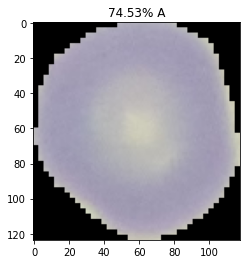

neg/neg4198.jpg


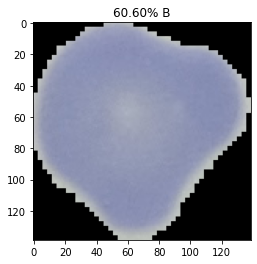

neg/neg4199.jpg


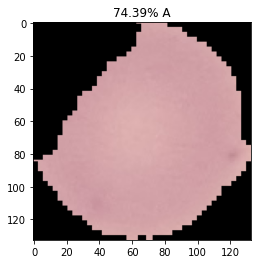

neg/neg4200.jpg


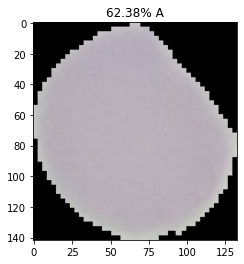

neg/neg4201.jpg


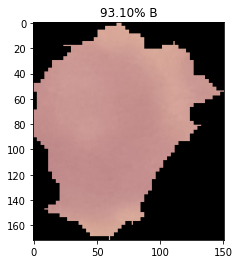

neg/neg4202.jpg


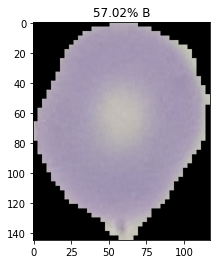

neg/neg4203.jpg


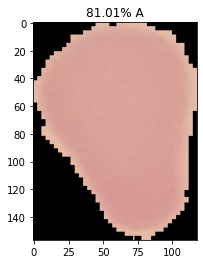

neg/neg4204.jpg


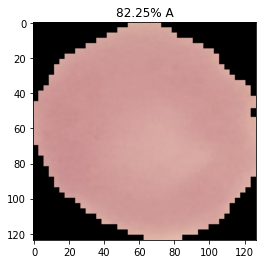

neg/neg4205.jpg


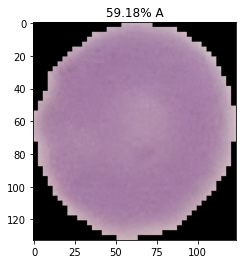

neg/neg4206.jpg


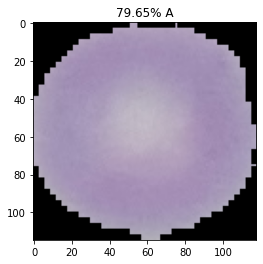

neg/neg4207.jpg


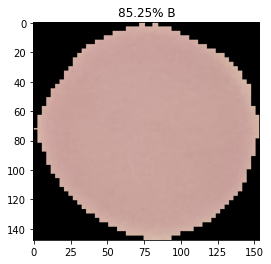

neg/neg4208.jpg


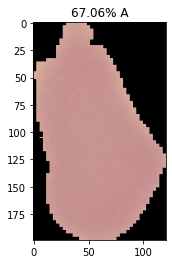

neg/neg4209.jpg


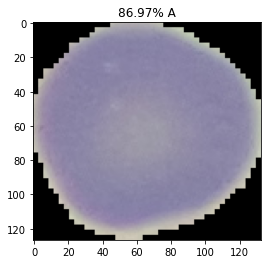

neg/neg4210.jpg


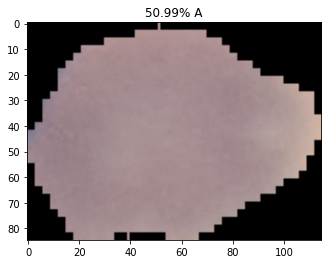

neg/neg4211.jpg


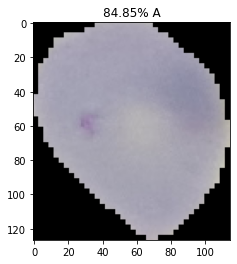

neg/neg4212.jpg


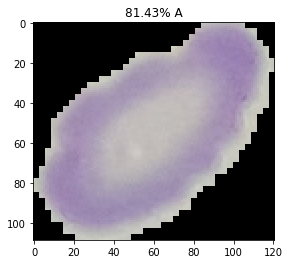

neg/neg4213.jpg


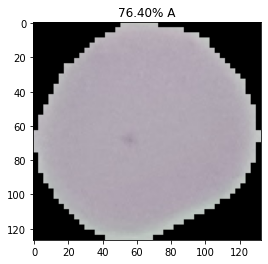

neg/neg4214.jpg


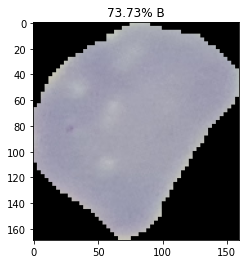

neg/neg4215.jpg


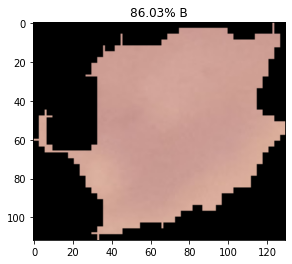

neg/neg4216.jpg


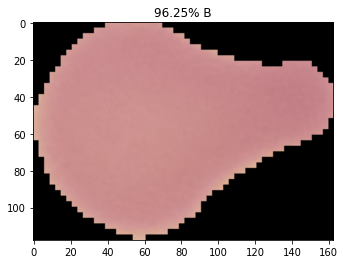

neg/neg4217.jpg


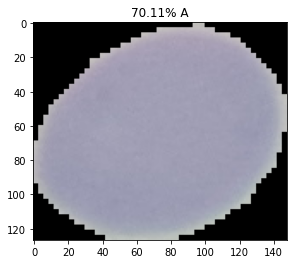

neg/neg4218.jpg


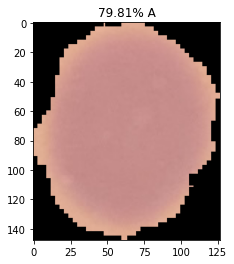

neg/neg4219.jpg


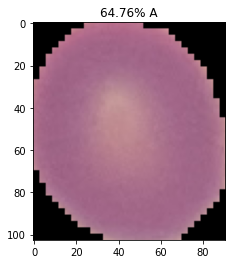

neg/neg4220.jpg


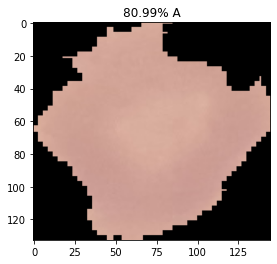

neg/neg4221.jpg


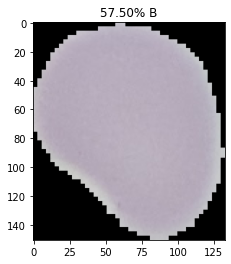

neg/neg4222.jpg


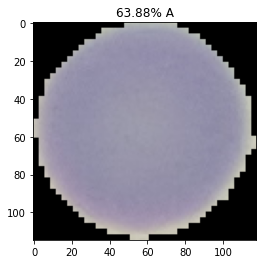

neg/neg4223.jpg


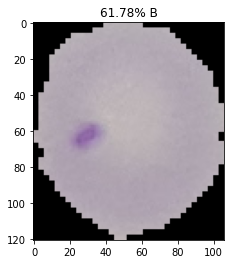

neg/neg4224.jpg


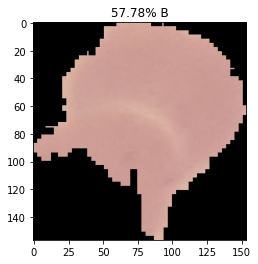

neg/neg4225.jpg


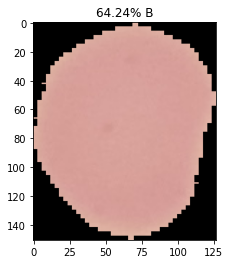

neg/neg4226.jpg


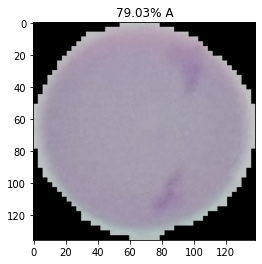

neg/neg4227.jpg


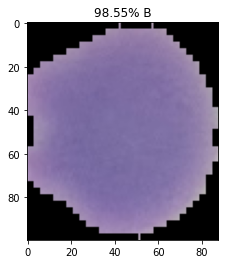

neg/neg4228.jpg


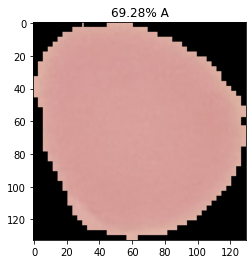

neg/neg4229.jpg


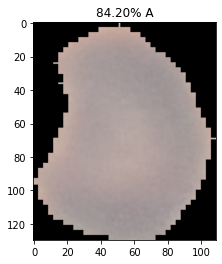

neg/neg4230.jpg


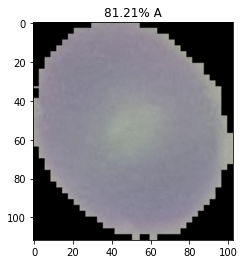

neg/neg4231.jpg


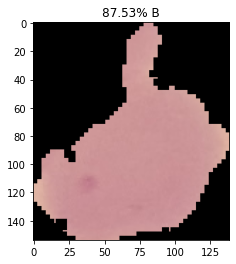

neg/neg4232.jpg


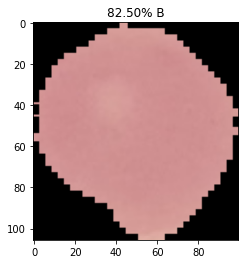

neg/neg4233.jpg


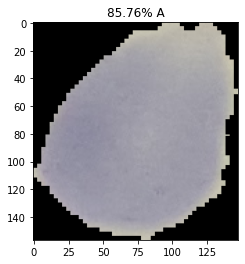

neg/neg4234.jpg


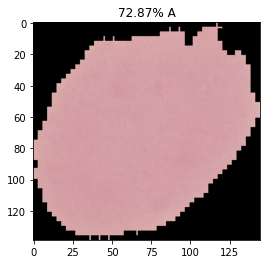

neg/neg4235.jpg


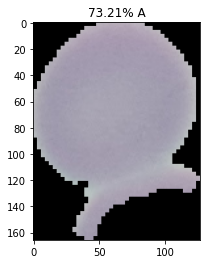

neg/neg4236.jpg


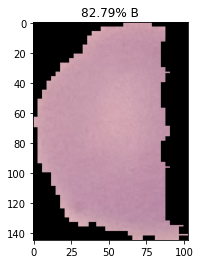

neg/neg4237.jpg


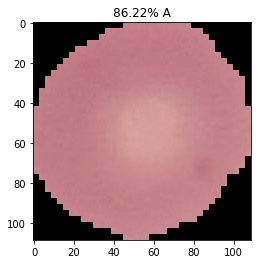

neg/neg4238.jpg


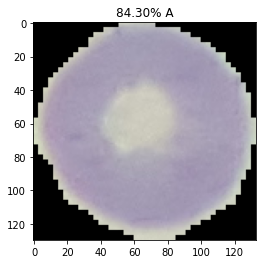

neg/neg4239.jpg


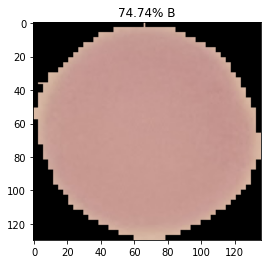

neg/neg4240.jpg


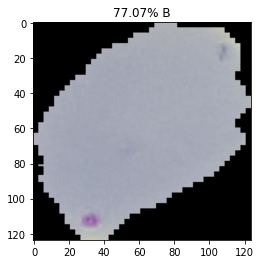

neg/neg4241.jpg


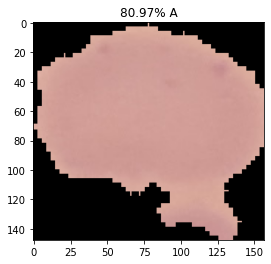

neg/neg4242.jpg


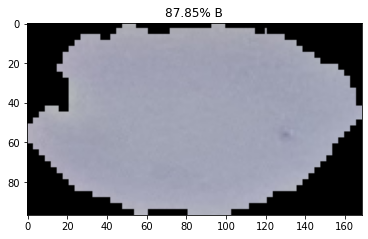

neg/neg4243.jpg


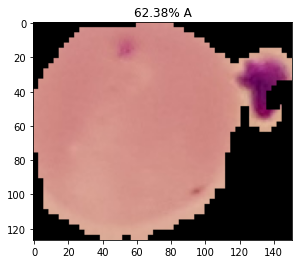

neg/neg4244.jpg


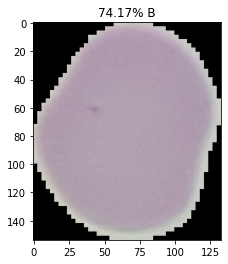

neg/neg4245.jpg


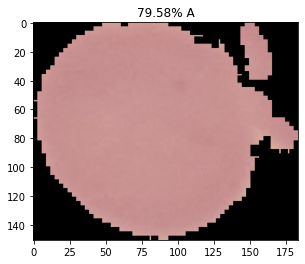

neg/neg4246.jpg


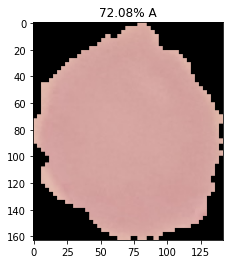

neg/neg4247.jpg


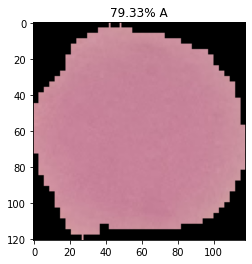

neg/neg4248.jpg


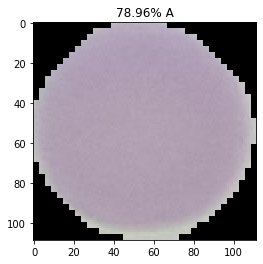

neg/neg4249.jpg


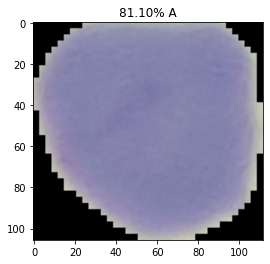

neg/neg4250.jpg


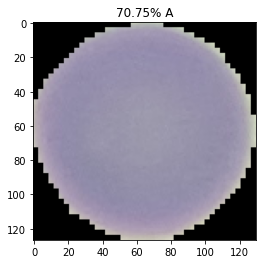

neg/neg4251.jpg


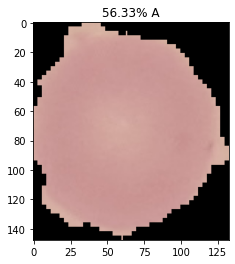

neg/neg4252.jpg


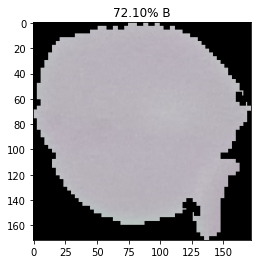

neg/neg4253.jpg


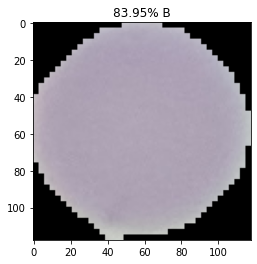

neg/neg4254.jpg


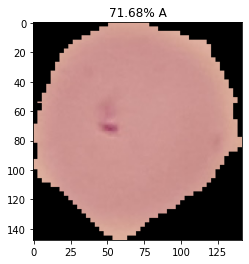

neg/neg4255.jpg


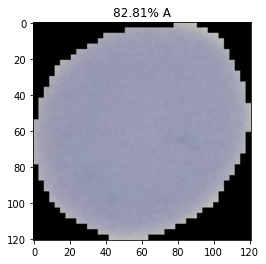

neg/neg4256.jpg


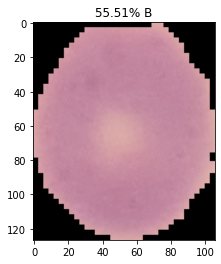

neg/neg4257.jpg


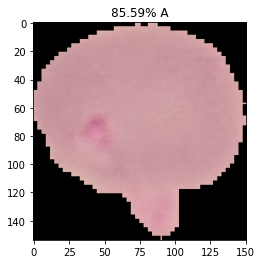

neg/neg4258.jpg


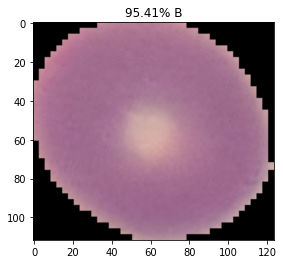

neg/neg4259.jpg


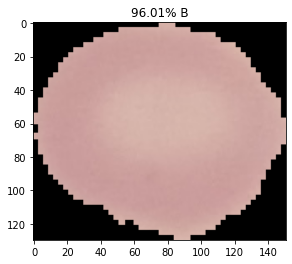

neg/neg4260.jpg


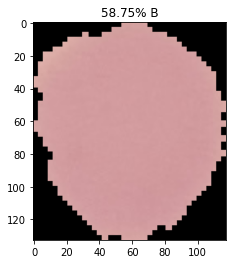

neg/neg4261.jpg


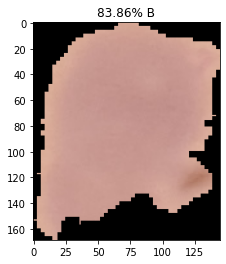

neg/neg4262.jpg


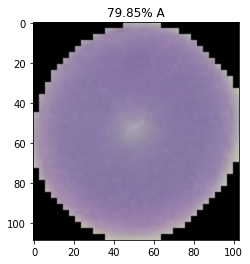

neg/neg4263.jpg


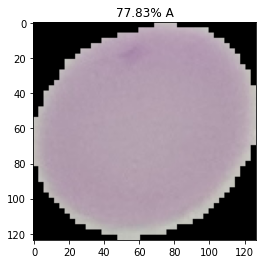

neg/neg4264.jpg


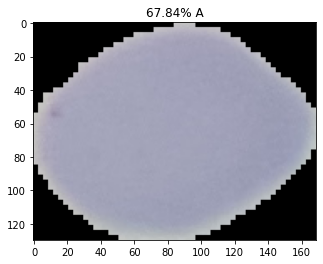

neg/neg4265.jpg


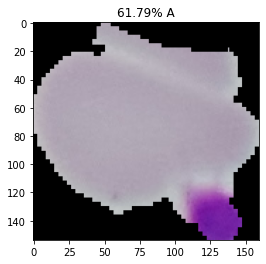

neg/neg4266.jpg


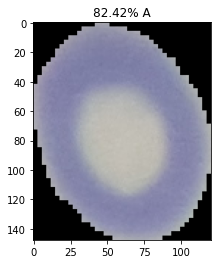

neg/neg4267.jpg


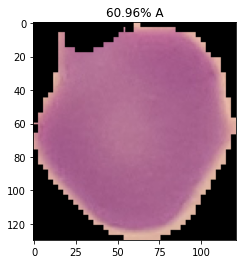

neg/neg4268.jpg


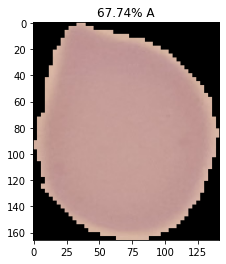

neg/neg4269.jpg


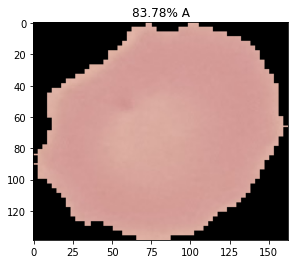

neg/neg4270.jpg


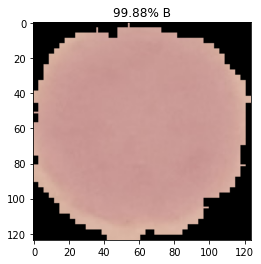

neg/neg4271.jpg


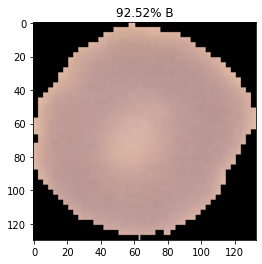

neg/neg4272.jpg


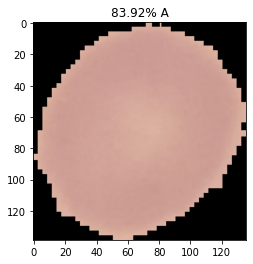

neg/neg4273.jpg


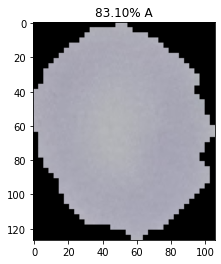

neg/neg4274.jpg


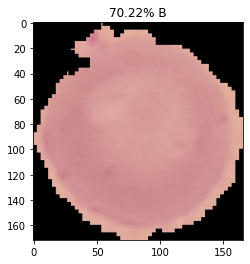

neg/neg4275.jpg


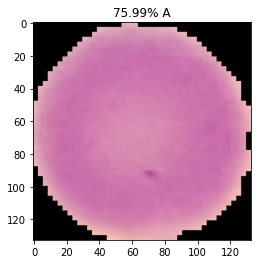

neg/neg4276.jpg


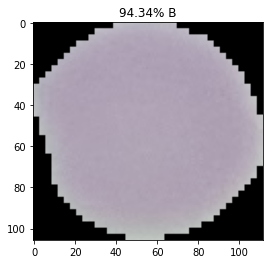

neg/neg4277.jpg


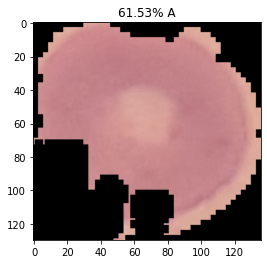

neg/neg4278.jpg


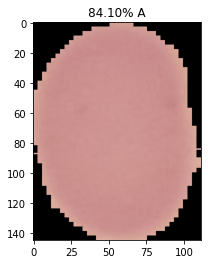

neg/neg4279.jpg


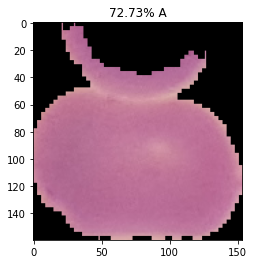

neg/neg4280.jpg


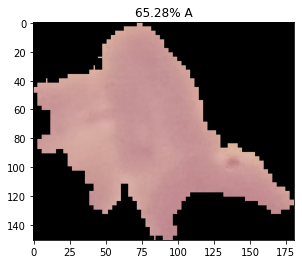

neg/neg4281.jpg


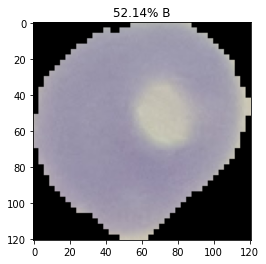

neg/neg4282.jpg


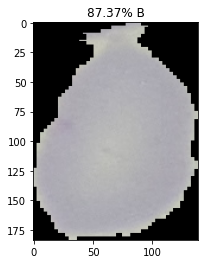

neg/neg4283.jpg


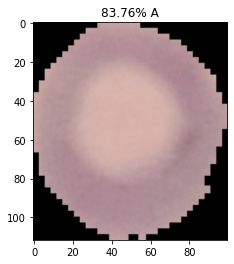

neg/neg4284.jpg


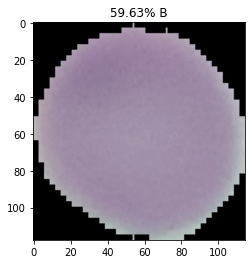

neg/neg4285.jpg


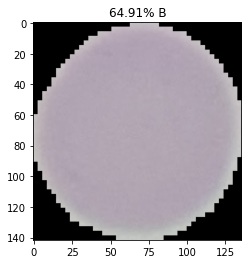

neg/neg4286.jpg


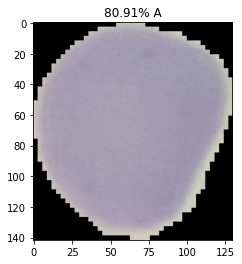

neg/neg4287.jpg


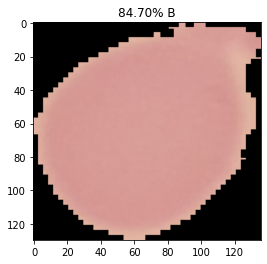

neg/neg4288.jpg


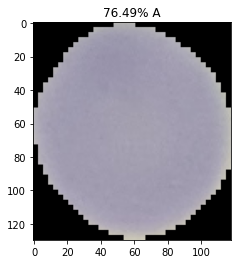

neg/neg4289.jpg


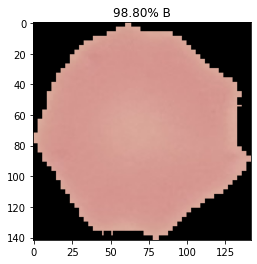

neg/neg4290.jpg


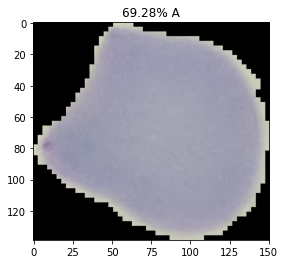

neg/neg4291.jpg


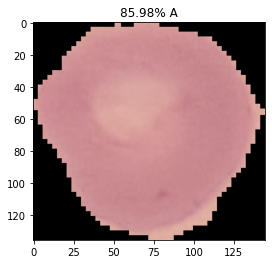

neg/neg4292.jpg


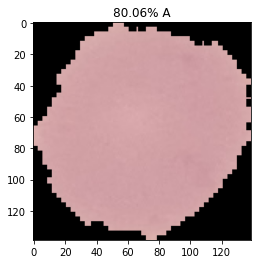

neg/neg4293.jpg


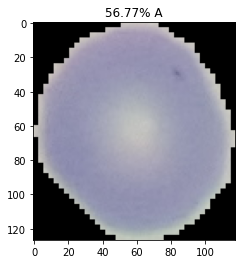

neg/neg4294.jpg


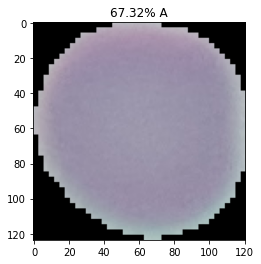

neg/neg4295.jpg


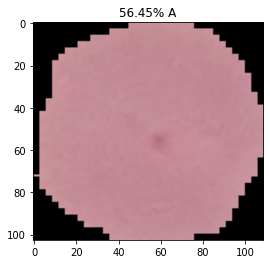

neg/neg4296.jpg


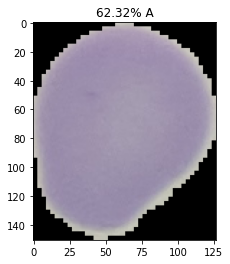

neg/neg4297.jpg


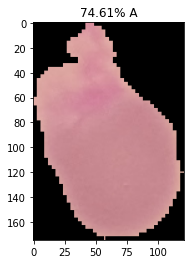

neg/neg4298.jpg


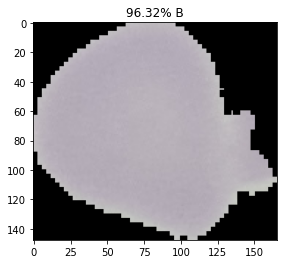

neg/neg4299.jpg


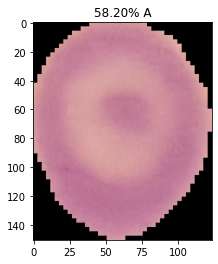

neg/neg4300.jpg


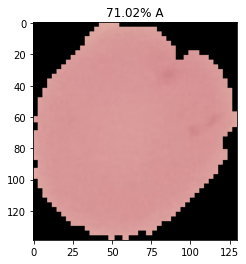

neg/neg4301.jpg


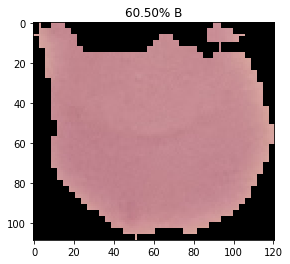

neg/neg4302.jpg


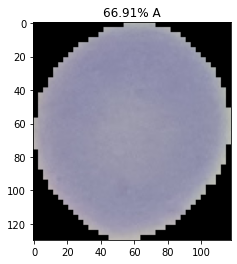

neg/neg4303.jpg


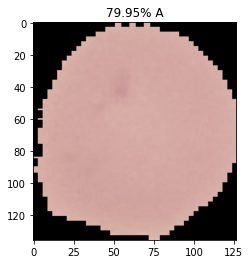

neg/neg4304.jpg


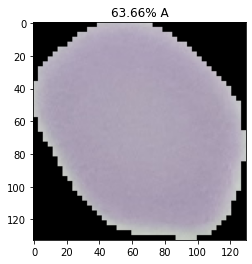

neg/neg4305.jpg


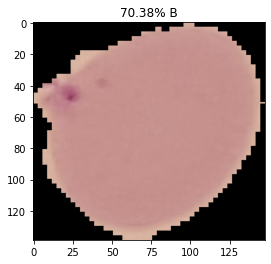

neg/neg4306.jpg


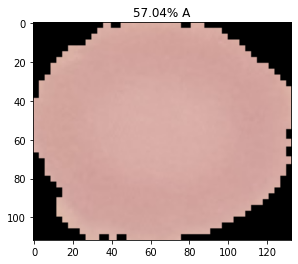

neg/neg4307.jpg


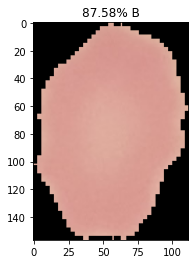

neg/neg4308.jpg


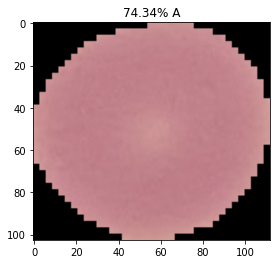

neg/neg4309.jpg


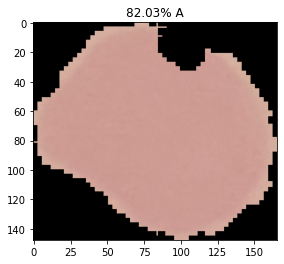

neg/neg4310.jpg


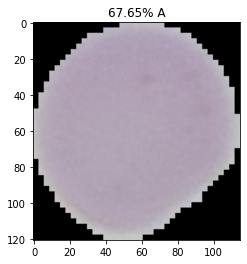

neg/neg4311.jpg


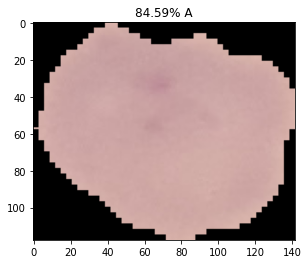

neg/neg4312.jpg


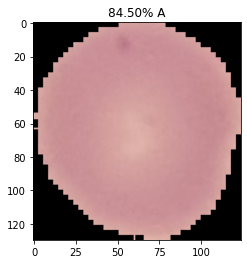

neg/neg4313.jpg


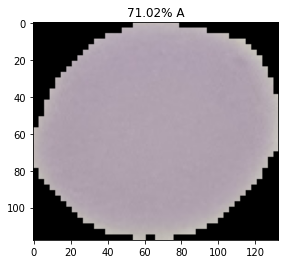

neg/neg4314.jpg


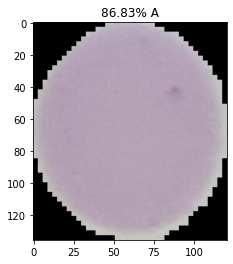

neg/neg4315.jpg


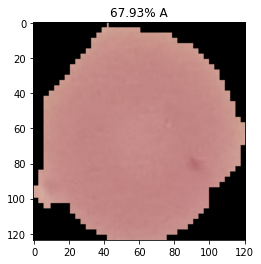

neg/neg4316.jpg


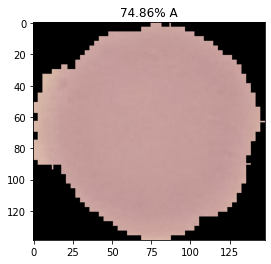

neg/neg4317.jpg


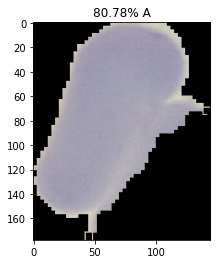

neg/neg4318.jpg


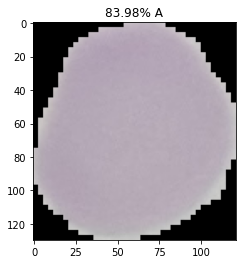

neg/neg4319.jpg


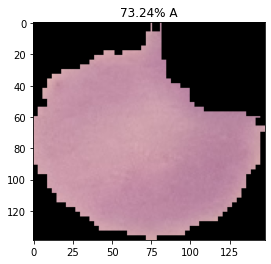

neg/neg4320.jpg


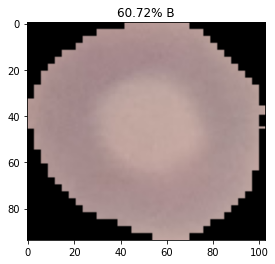

neg/neg4321.jpg


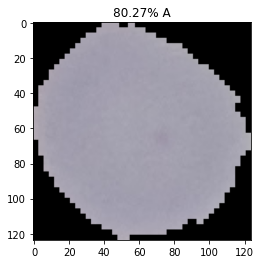

neg/neg4322.jpg


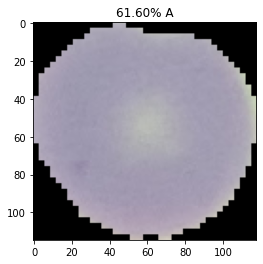

neg/neg4323.jpg


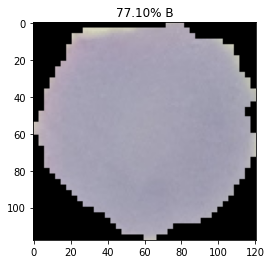

neg/neg4324.jpg


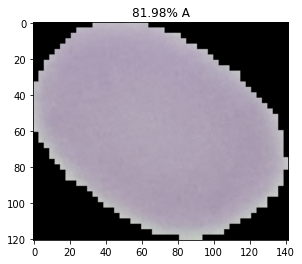

neg/neg4325.jpg


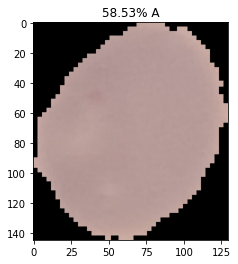

neg/neg4326.jpg


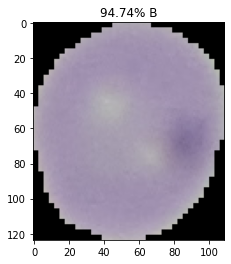

neg/neg4327.jpg


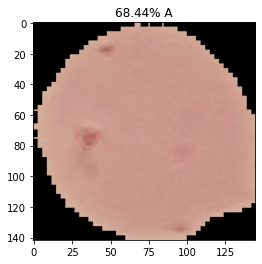

neg/neg4328.jpg


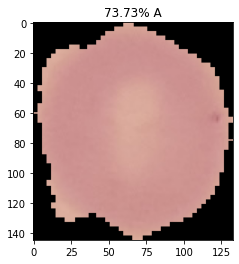

neg/neg4329.jpg


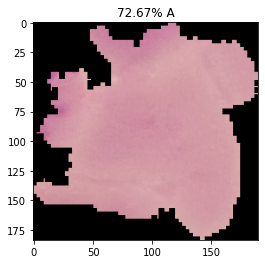

neg/neg4330.jpg


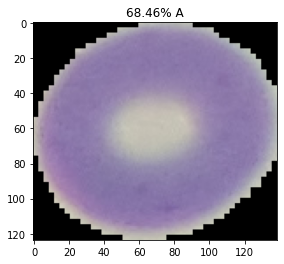

neg/neg4331.jpg


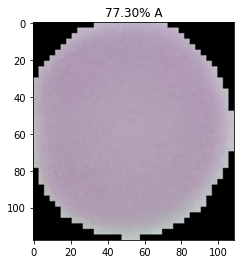

neg/neg4332.jpg


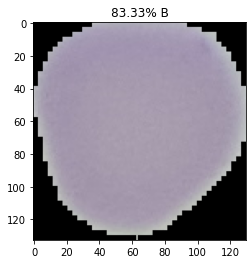

neg/neg4333.jpg


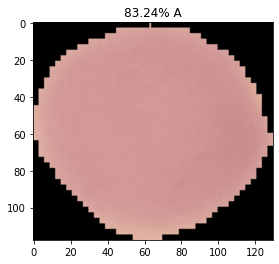

neg/neg4334.jpg


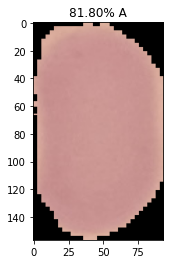

neg/neg4335.jpg


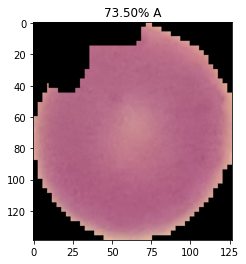

neg/neg4336.jpg


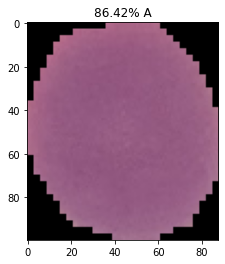

neg/neg4337.jpg


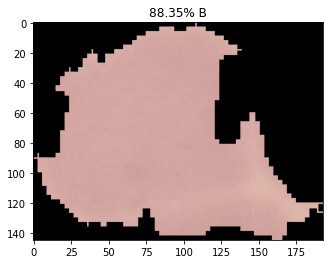

neg/neg4338.jpg


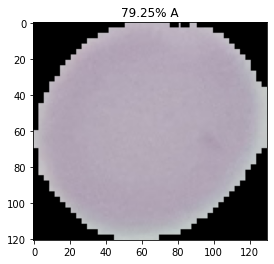

neg/neg4339.jpg


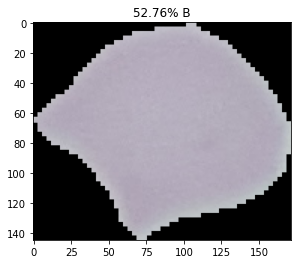

neg/neg4340.jpg


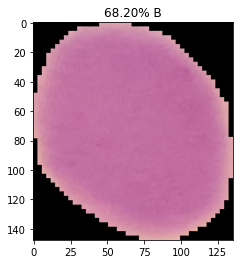

neg/neg4341.jpg


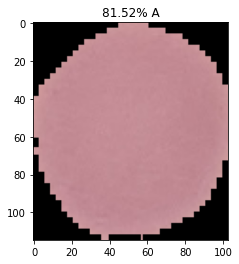

neg/neg4342.jpg


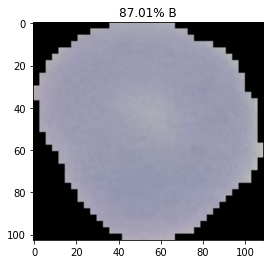

neg/neg4343.jpg


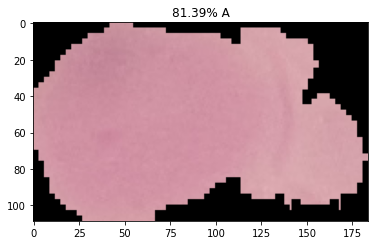

neg/neg4344.jpg


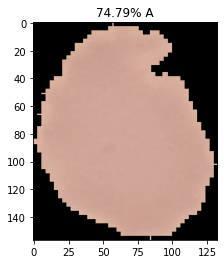

neg/neg4345.jpg


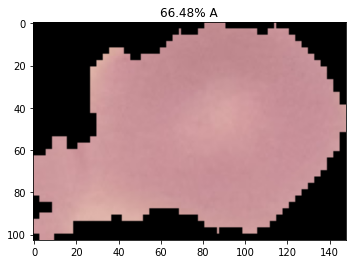

neg/neg4346.jpg


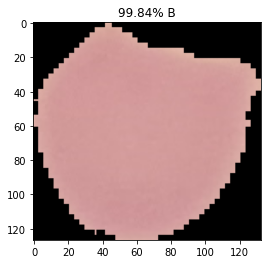

neg/neg4347.jpg


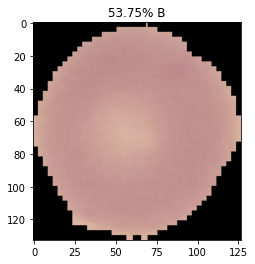

neg/neg4348.jpg


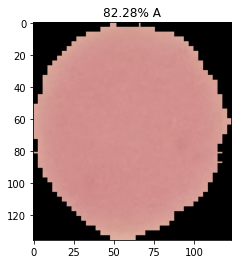

neg/neg4349.jpg


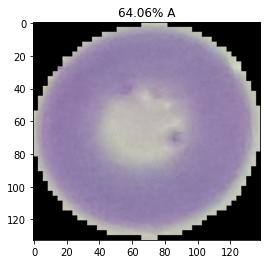

neg/neg4350.jpg


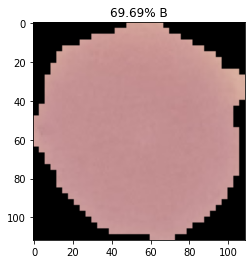

neg/neg4351.jpg


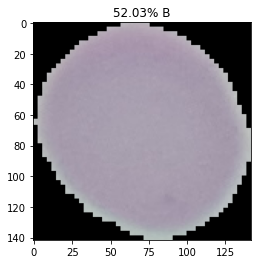

neg/neg4352.jpg


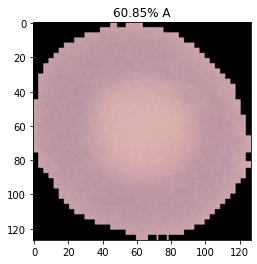

neg/neg4353.jpg


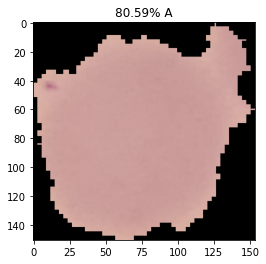

neg/neg4354.jpg


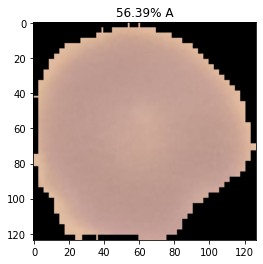

neg/neg4355.jpg


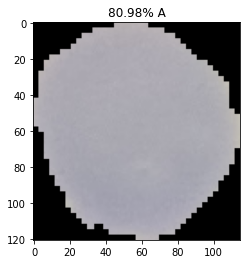

neg/neg4356.jpg


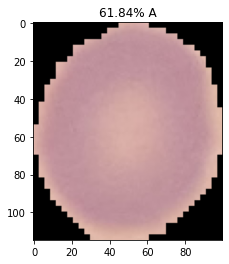

neg/neg4357.jpg


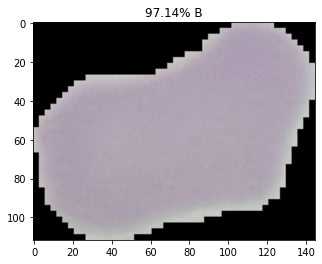

neg/neg4358.jpg


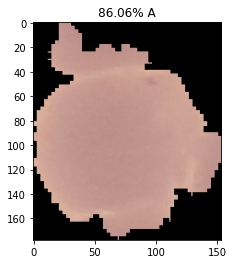

neg/neg4359.jpg


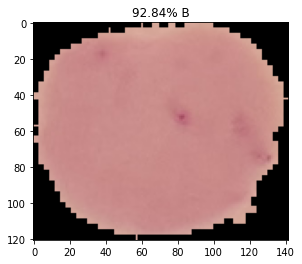

neg/neg4360.jpg


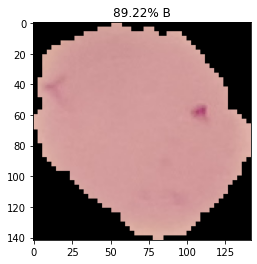

neg/neg4361.jpg


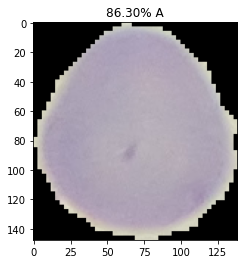

neg/neg4362.jpg


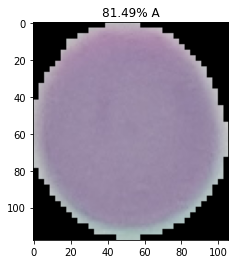

neg/neg4363.jpg


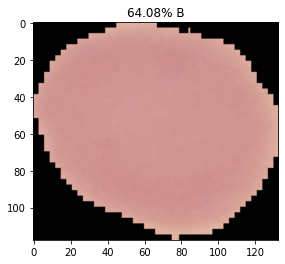

neg/neg4364.jpg


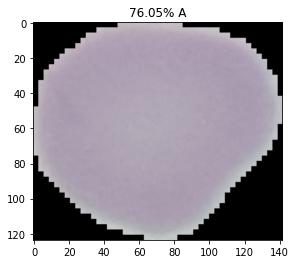

neg/neg4365.jpg


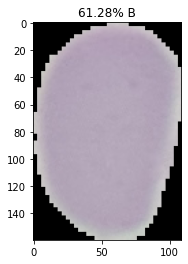

neg/neg4366.jpg


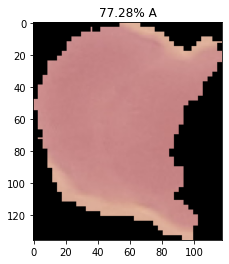

neg/neg4367.jpg


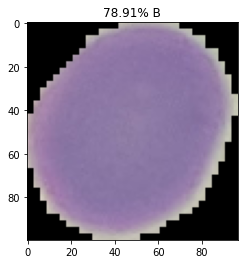

neg/neg4368.jpg


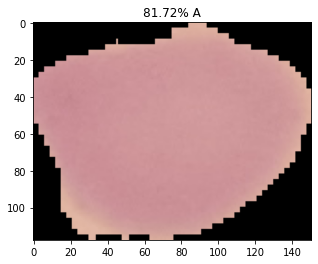

neg/neg4369.jpg


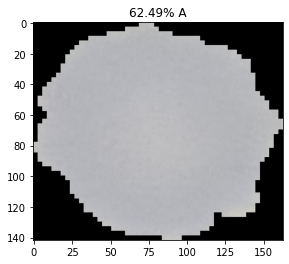

neg/neg4370.jpg


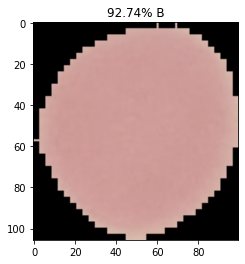

neg/neg4371.jpg


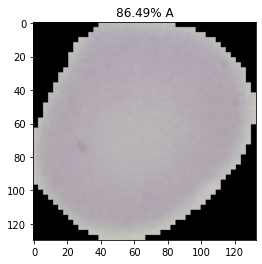

neg/neg4372.jpg


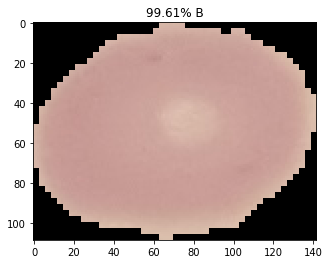

neg/neg4373.jpg


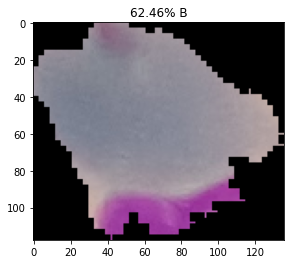

neg/neg4374.jpg


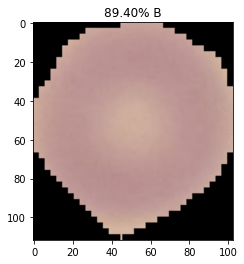

neg/neg4375.jpg


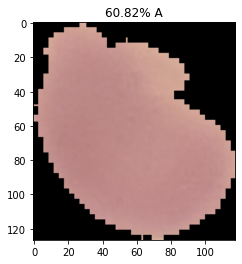

neg/neg4376.jpg


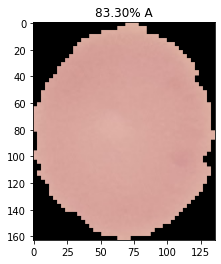

neg/neg4377.jpg


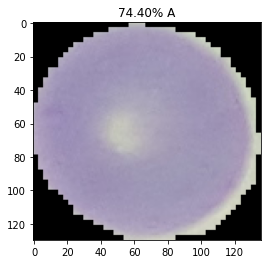

neg/neg4378.jpg


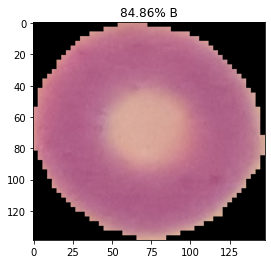

neg/neg4379.jpg


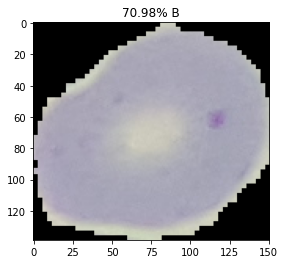

neg/neg4380.jpg


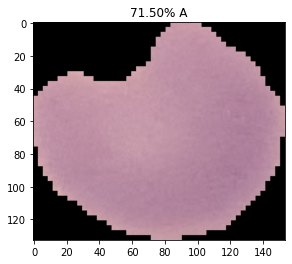

neg/neg4381.jpg


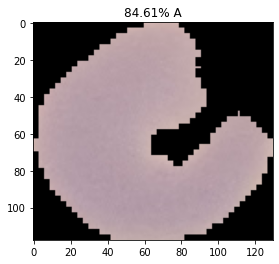

neg/neg4382.jpg


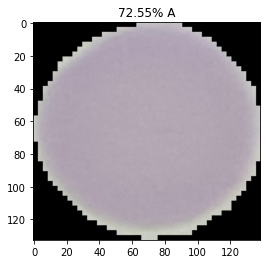

neg/neg4383.jpg


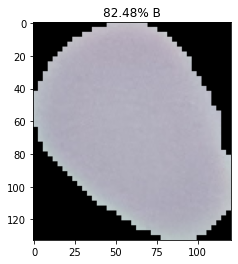

neg/neg4384.jpg


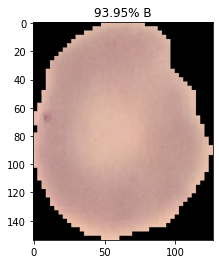

neg/neg4385.jpg


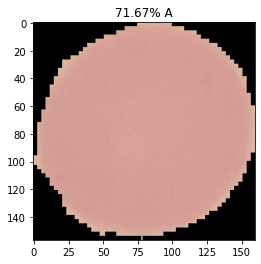

neg/neg4386.jpg


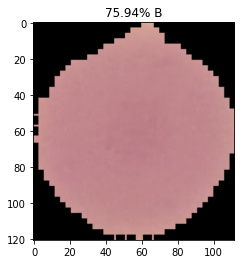

neg/neg4387.jpg


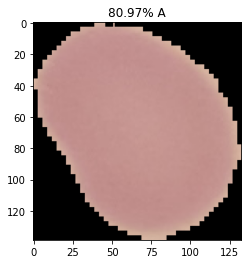

neg/neg4388.jpg


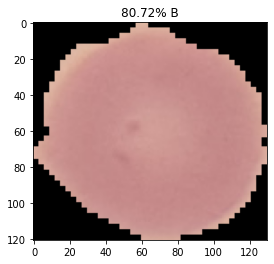

neg/neg4389.jpg


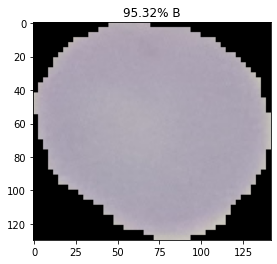

neg/neg4390.jpg


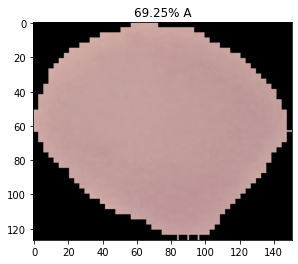

neg/neg4391.jpg


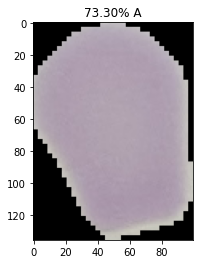

neg/neg4392.jpg


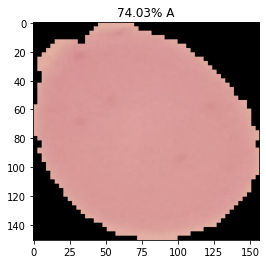

neg/neg4393.jpg


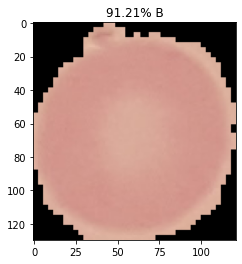

neg/neg4394.jpg


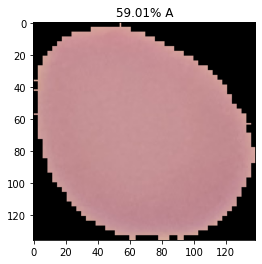

neg/neg4395.jpg


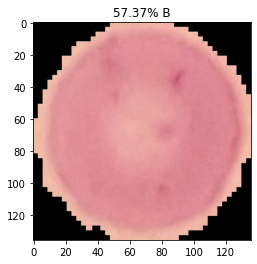

neg/neg4396.jpg


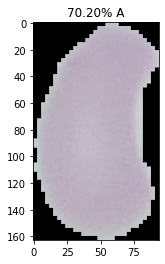

neg/neg4397.jpg


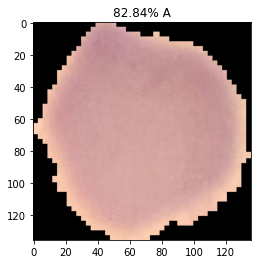

neg/neg4398.jpg


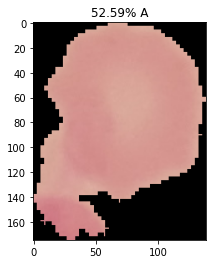

neg/neg4399.jpg


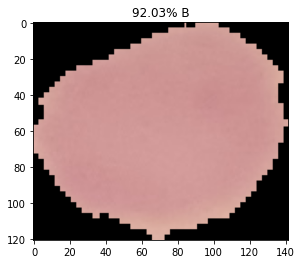

neg/neg4400.jpg


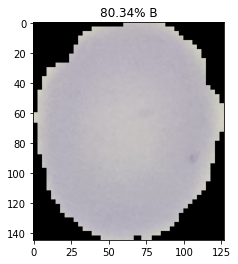

neg/neg4401.jpg


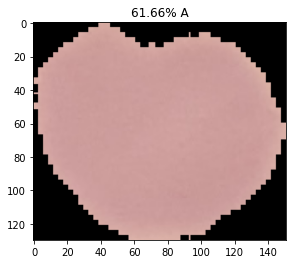

neg/neg4402.jpg


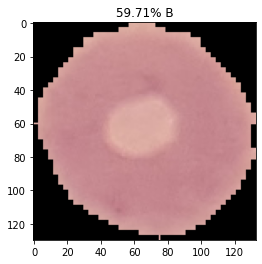

neg/neg4403.jpg


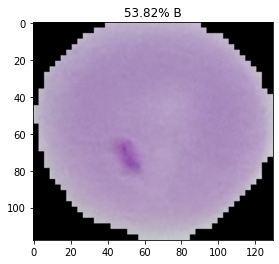

neg/neg4404.jpg


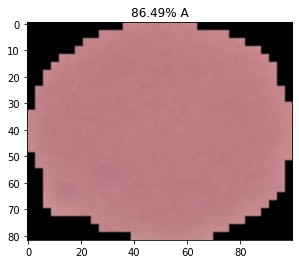

neg/neg4405.jpg


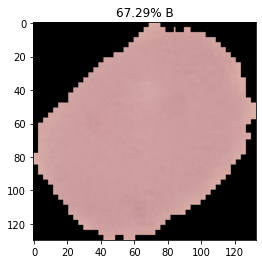

neg/neg4406.jpg


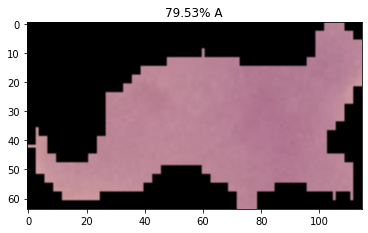

neg/neg4407.jpg


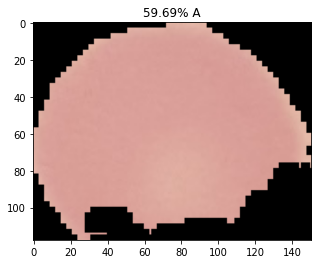

neg/neg4408.jpg


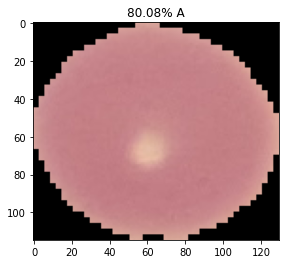

neg/neg4409.jpg


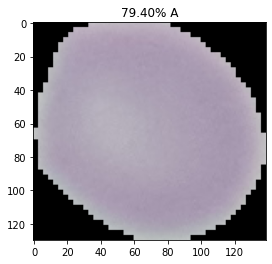

neg/neg4410.jpg


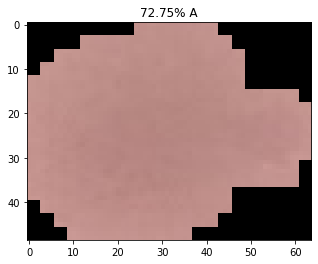

neg/neg4411.jpg


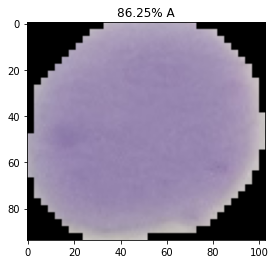

neg/neg4412.jpg


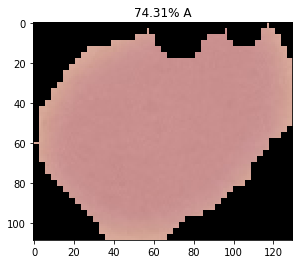

neg/neg4413.jpg


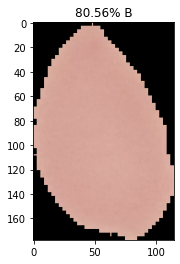

neg/neg4414.jpg


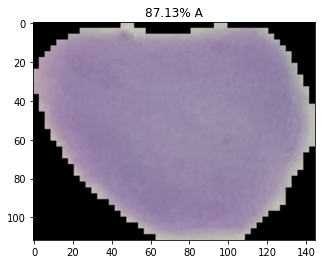

neg/neg4415.jpg


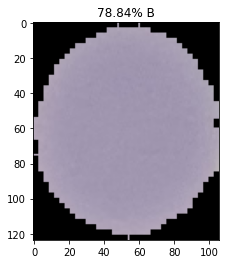

neg/neg4416.jpg


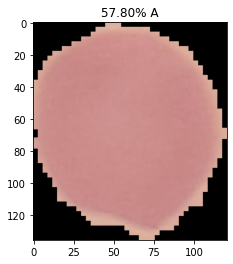

neg/neg4417.jpg


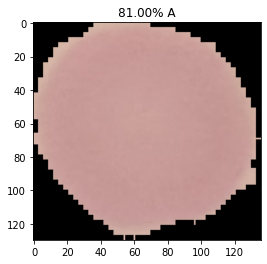

neg/neg4418.jpg


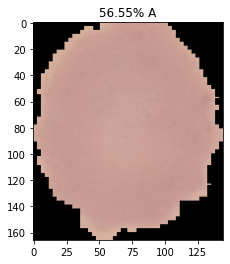

neg/neg4419.jpg


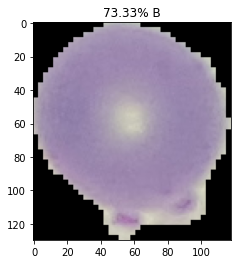

neg/neg4420.jpg


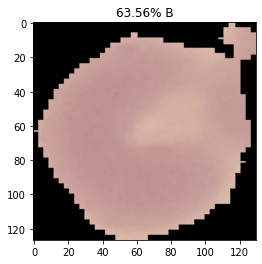

neg/neg4421.jpg


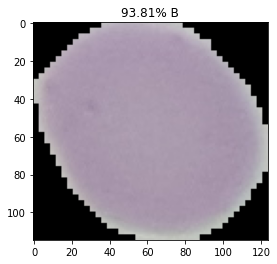

neg/neg4422.jpg


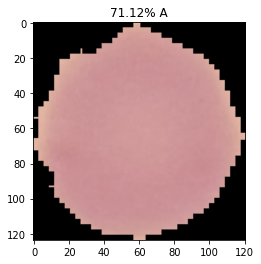

neg/neg4423.jpg


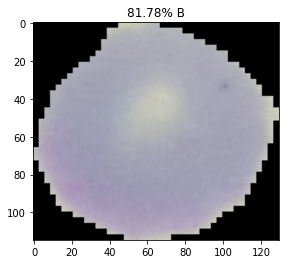

neg/neg4424.jpg


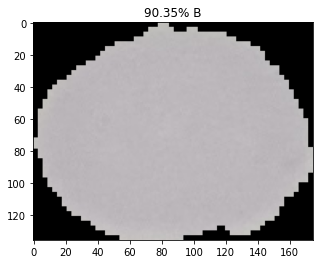

neg/neg4425.jpg


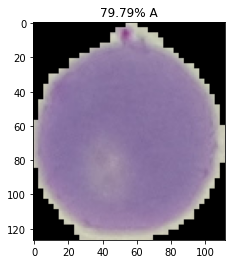

neg/neg4426.jpg


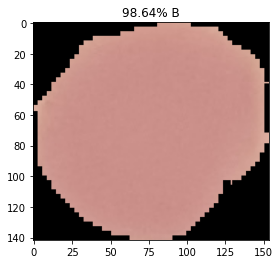

neg/neg4427.jpg


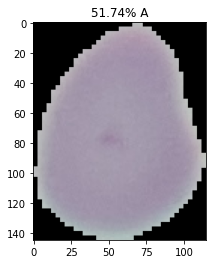

neg/neg4428.jpg


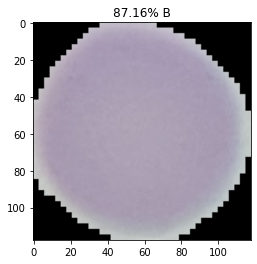

neg/neg4429.jpg


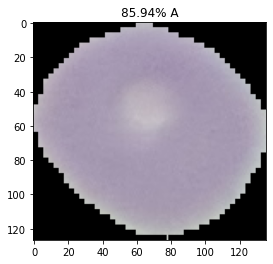

neg/neg4430.jpg


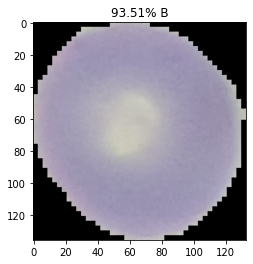

neg/neg4431.jpg


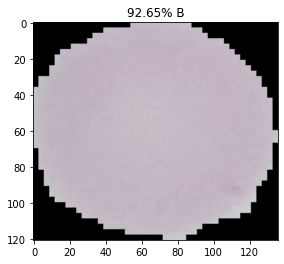

neg/neg4432.jpg


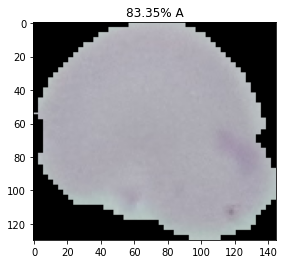

neg/neg4433.jpg


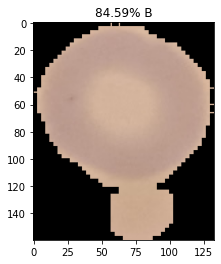

neg/neg4434.jpg


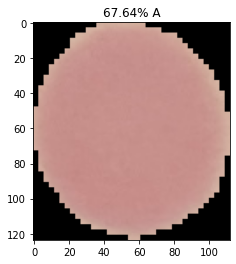

neg/neg4435.jpg


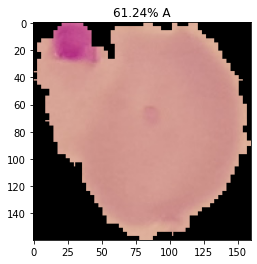

neg/neg4436.jpg


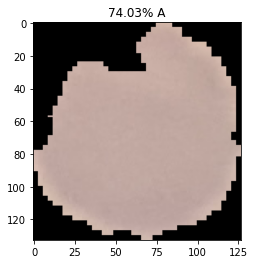

neg/neg4437.jpg


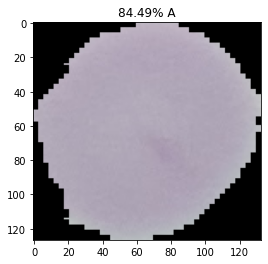

neg/neg4438.jpg


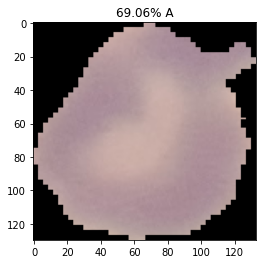

neg/neg4439.jpg


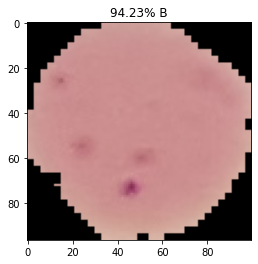

neg/neg4440.jpg


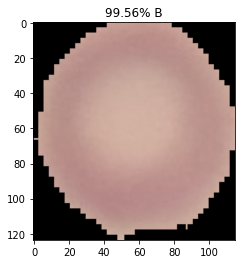

neg/neg4441.jpg


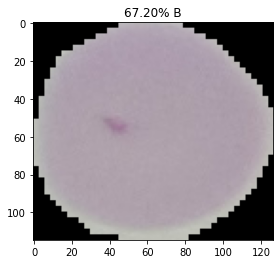

neg/neg4442.jpg


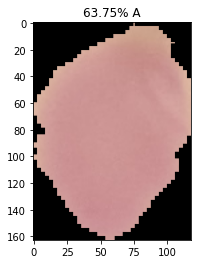

neg/neg4443.jpg


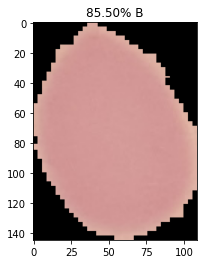

neg/neg4444.jpg


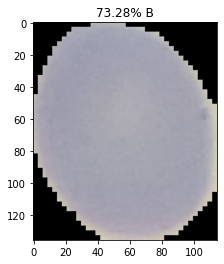

neg/neg4445.jpg


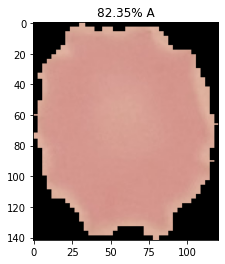

neg/neg4446.jpg


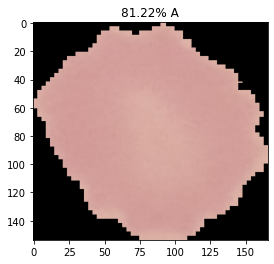

neg/neg4447.jpg


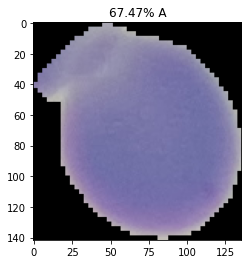

neg/neg4448.jpg


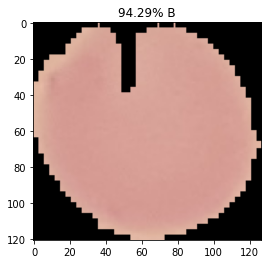

neg/neg4449.jpg


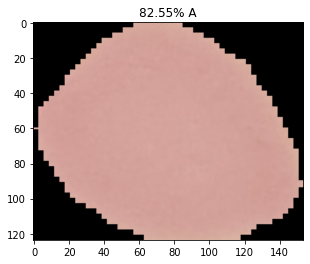

neg/neg4450.jpg


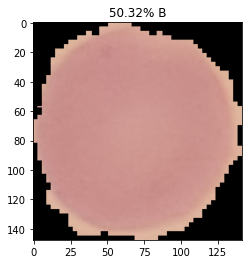

neg/neg4451.jpg


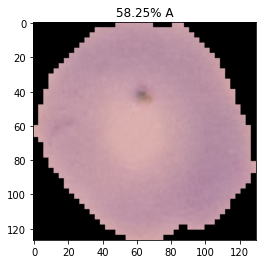

neg/neg4452.jpg


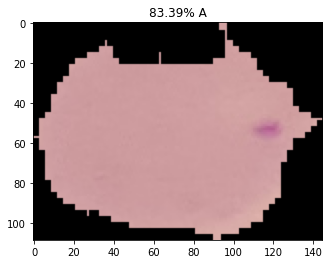

neg/neg4453.jpg


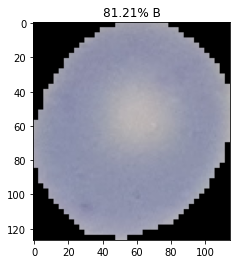

neg/neg4454.jpg


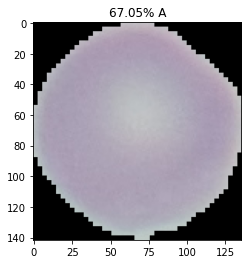

neg/neg4455.jpg


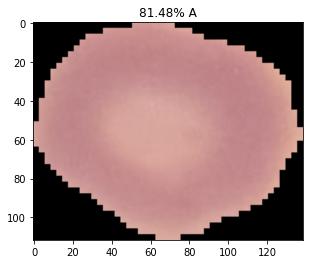

neg/neg4456.jpg


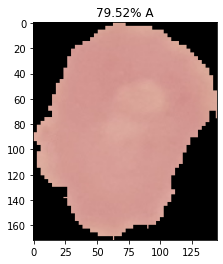

neg/neg4457.jpg


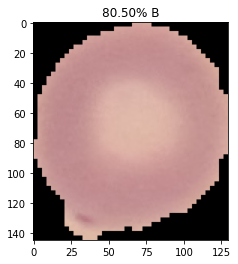

neg/neg4458.jpg


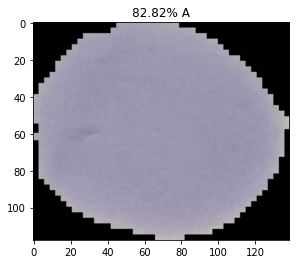

neg/neg4459.jpg


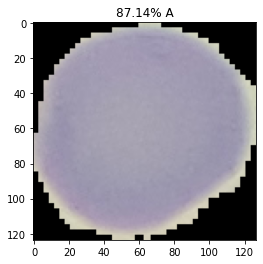

neg/neg4460.jpg


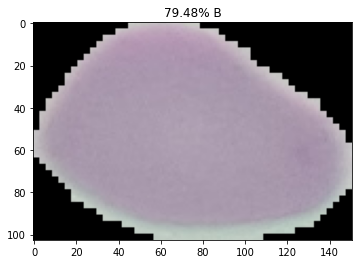

neg/neg4461.jpg


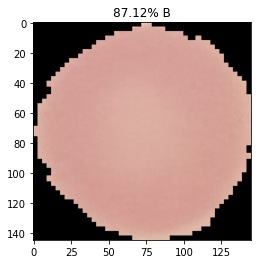

neg/neg4462.jpg


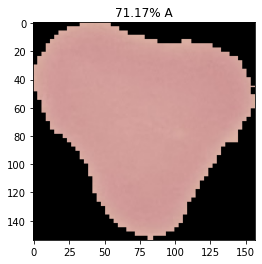

neg/neg4463.jpg


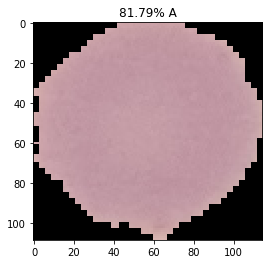

neg/neg4464.jpg


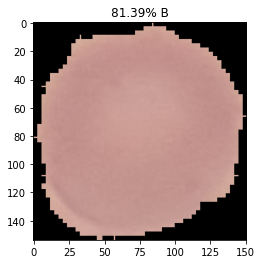

neg/neg4465.jpg


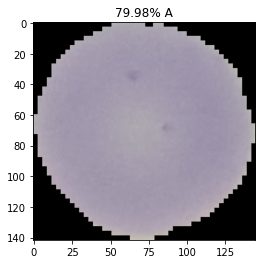

neg/neg4466.jpg


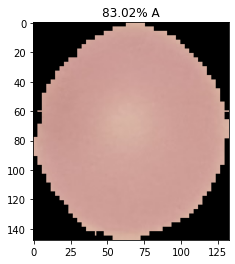

neg/neg4467.jpg


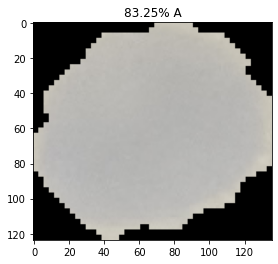

neg/neg4468.jpg


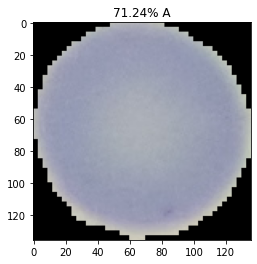

neg/neg4469.jpg


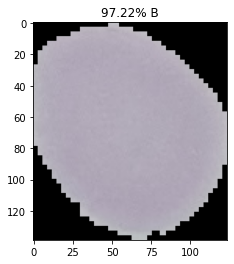

neg/neg4470.jpg


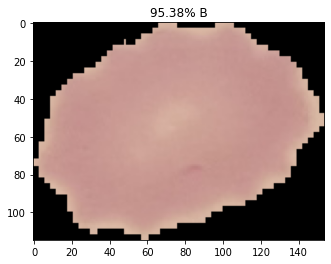

neg/neg4471.jpg


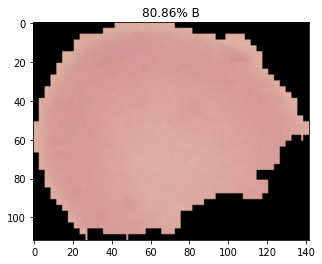

neg/neg4472.jpg


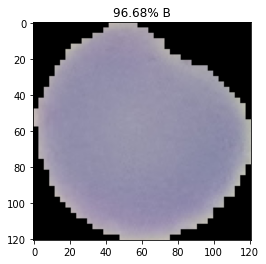

neg/neg4473.jpg


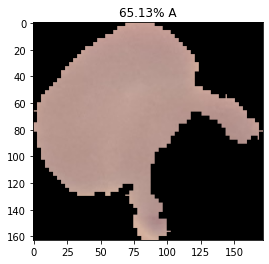

neg/neg4474.jpg


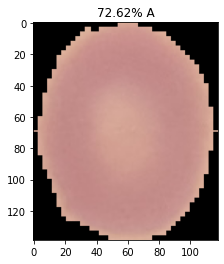

neg/neg4475.jpg


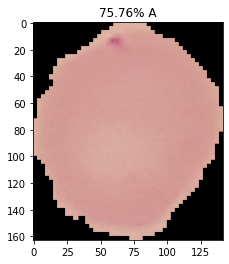

neg/neg4476.jpg


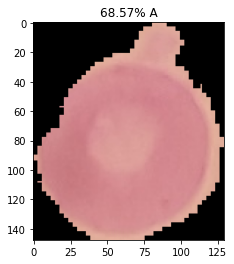

neg/neg4477.jpg


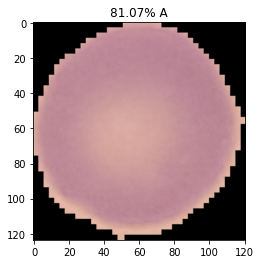

neg/neg4478.jpg


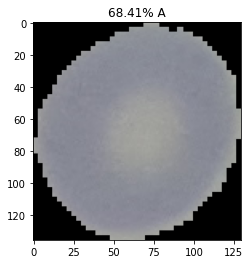

neg/neg4479.jpg


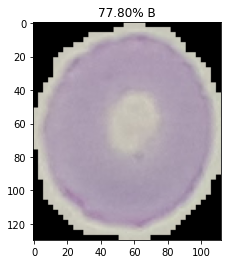

neg/neg4480.jpg


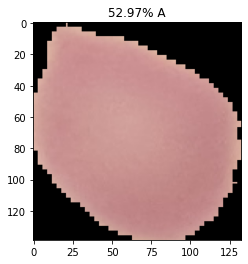

neg/neg4481.jpg


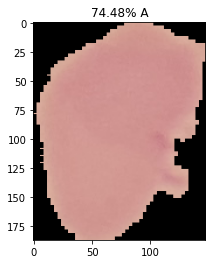

neg/neg4482.jpg


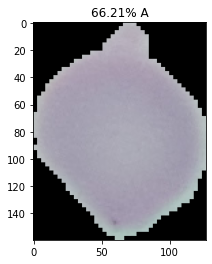

neg/neg4483.jpg


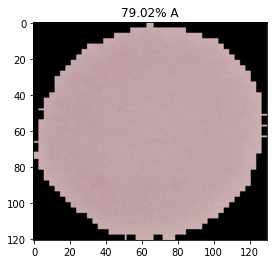

neg/neg4484.jpg


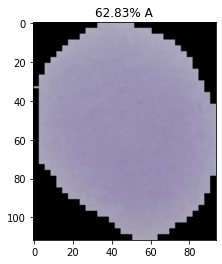

neg/neg4485.jpg


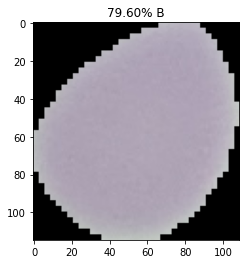

neg/neg4486.jpg


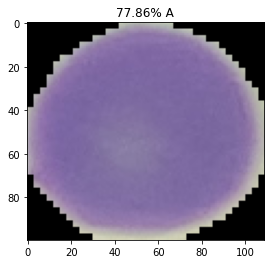

neg/neg4487.jpg


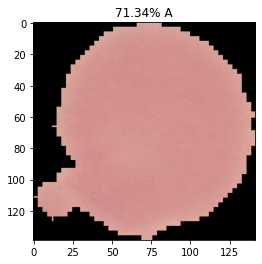

neg/neg4488.jpg


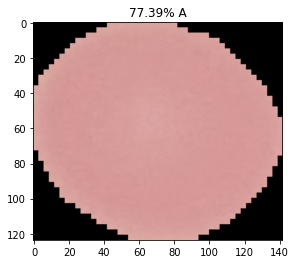

neg/neg4489.jpg


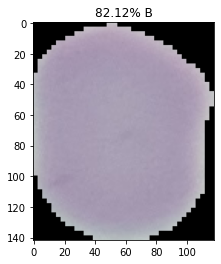

neg/neg4490.jpg


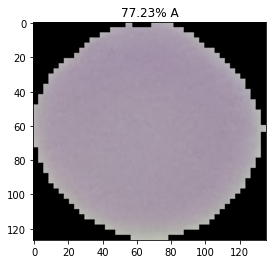

neg/neg4491.jpg


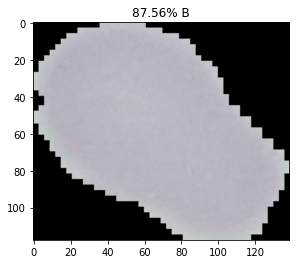

neg/neg4492.jpg


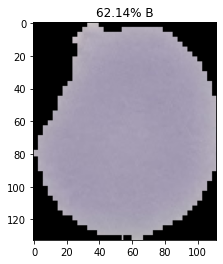

neg/neg4493.jpg


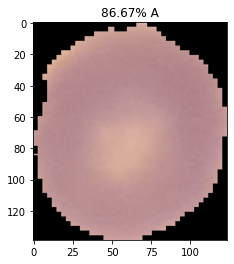

neg/neg4494.jpg


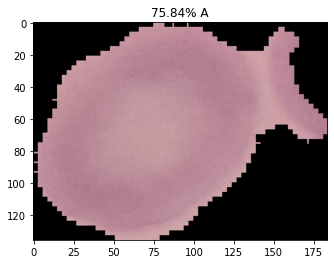

neg/neg4495.jpg


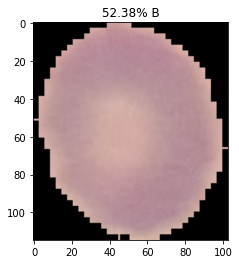

neg/neg4496.jpg


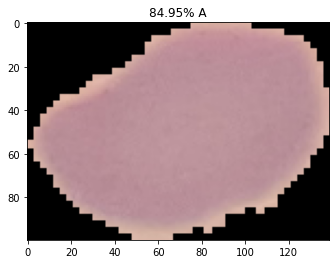

neg/neg4497.jpg


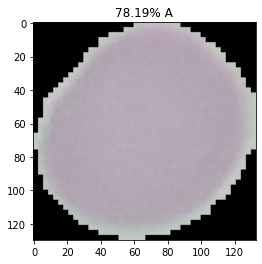

neg/neg4498.jpg


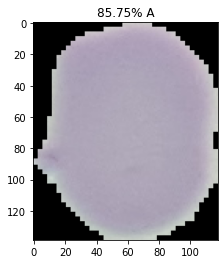

neg/neg4499.jpg


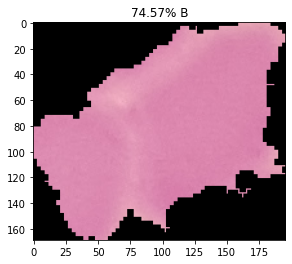

pos/pos4000.jpg


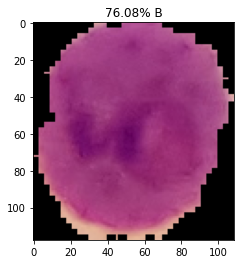

pos/pos4001.jpg


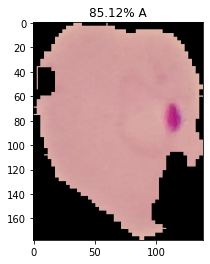

pos/pos4002.jpg


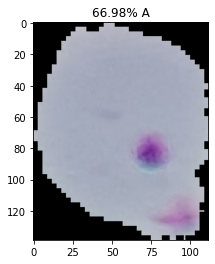

pos/pos4003.jpg


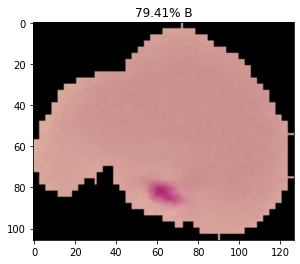

pos/pos4004.jpg


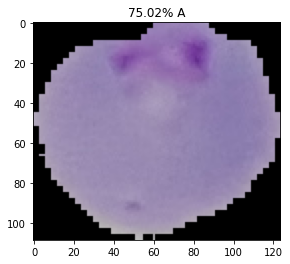

pos/pos4005.jpg


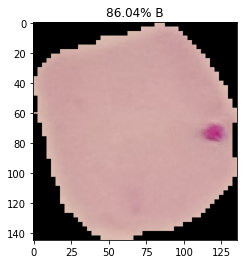

pos/pos4006.jpg


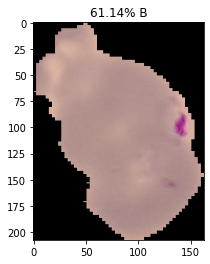

pos/pos4007.jpg


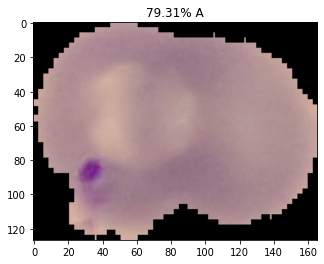

pos/pos4008.jpg


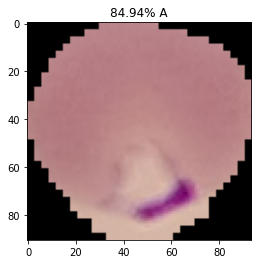

pos/pos4009.jpg


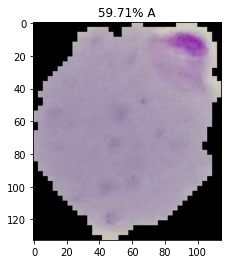

pos/pos4010.jpg


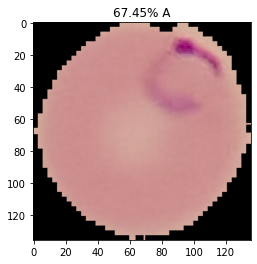

pos/pos4011.jpg


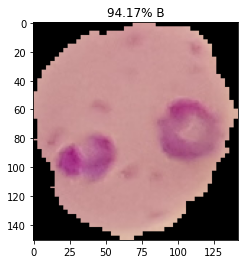

pos/pos4012.jpg


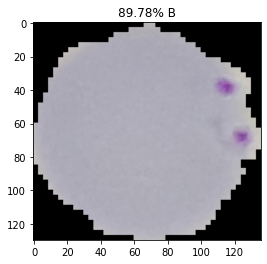

pos/pos4013.jpg


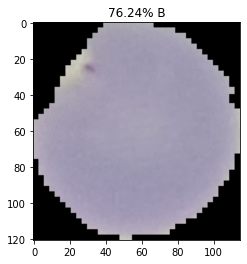

pos/pos4014.jpg


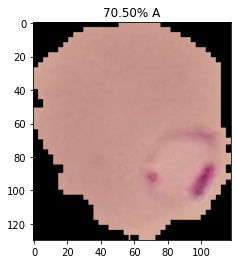

pos/pos4015.jpg


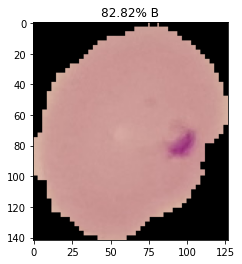

pos/pos4016.jpg


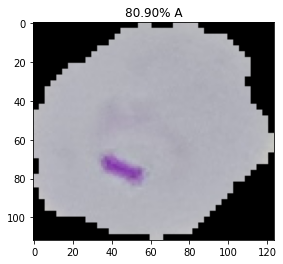

pos/pos4017.jpg


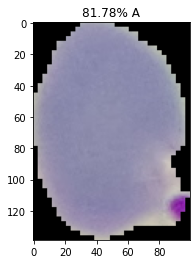

pos/pos4018.jpg


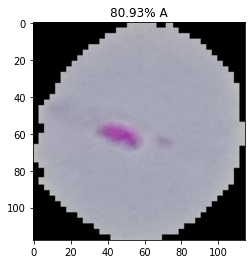

pos/pos4019.jpg


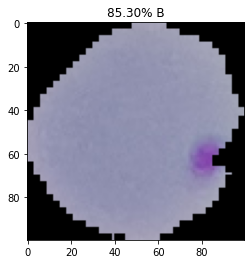

pos/pos4020.jpg


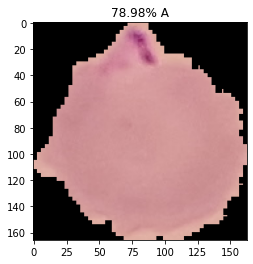

pos/pos4021.jpg


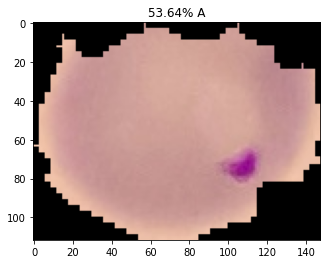

pos/pos4022.jpg


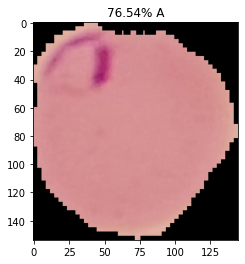

pos/pos4023.jpg


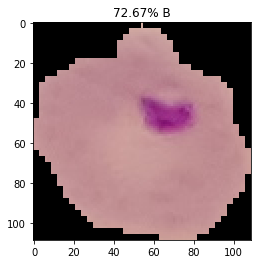

pos/pos4024.jpg


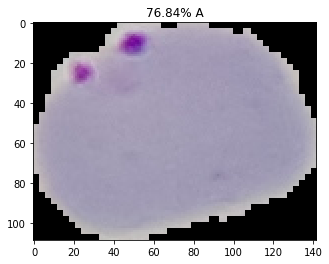

pos/pos4025.jpg


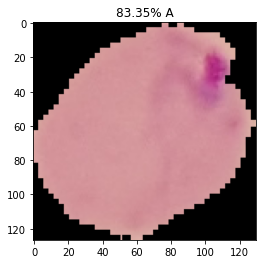

pos/pos4026.jpg


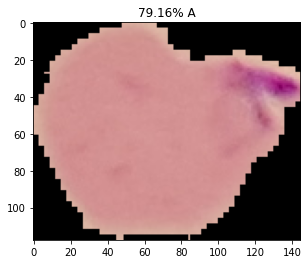

pos/pos4027.jpg


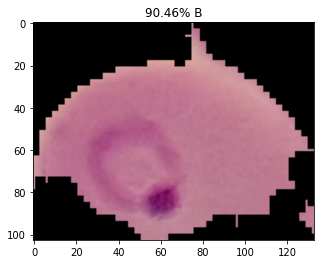

pos/pos4028.jpg


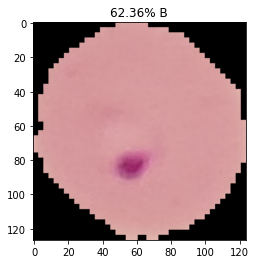

pos/pos4029.jpg


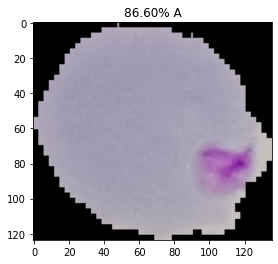

pos/pos4030.jpg


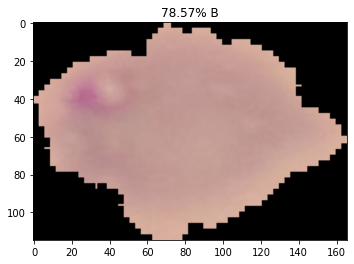

pos/pos4031.jpg


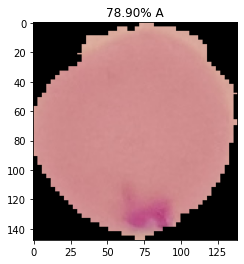

pos/pos4032.jpg


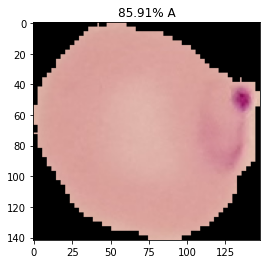

pos/pos4033.jpg


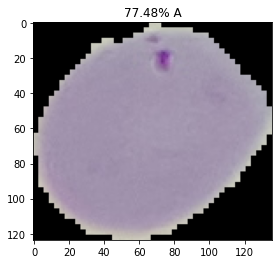

pos/pos4034.jpg


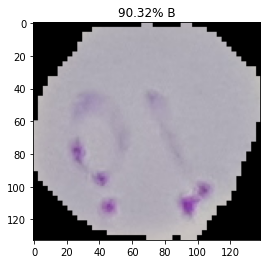

pos/pos4035.jpg


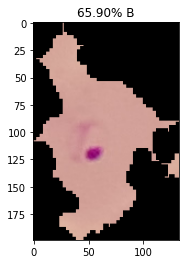

pos/pos4036.jpg


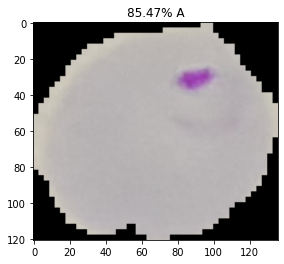

pos/pos4037.jpg


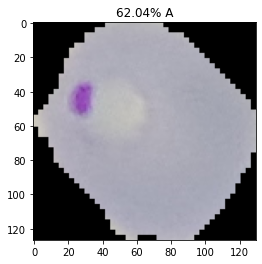

pos/pos4038.jpg


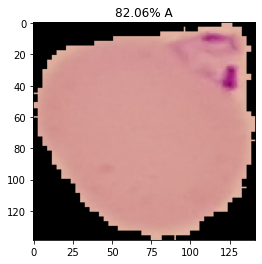

pos/pos4039.jpg


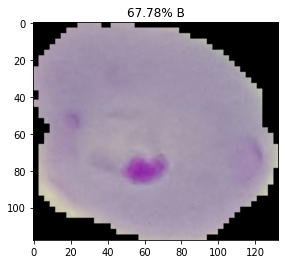

pos/pos4040.jpg


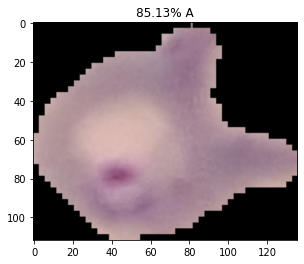

pos/pos4041.jpg


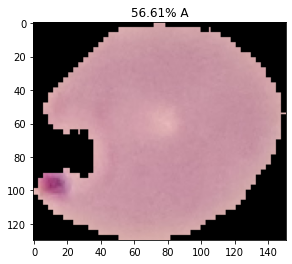

pos/pos4042.jpg


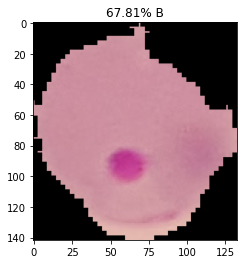

pos/pos4043.jpg


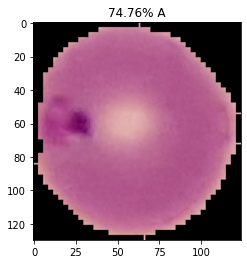

pos/pos4044.jpg


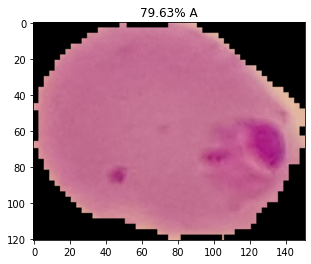

pos/pos4045.jpg


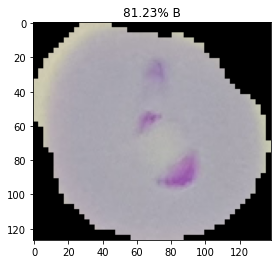

pos/pos4046.jpg


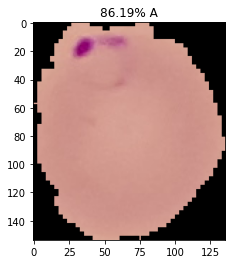

pos/pos4047.jpg


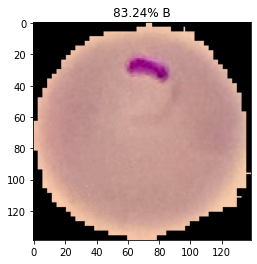

pos/pos4048.jpg


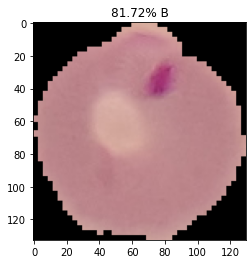

pos/pos4049.jpg


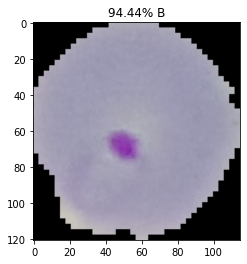

pos/pos4050.jpg


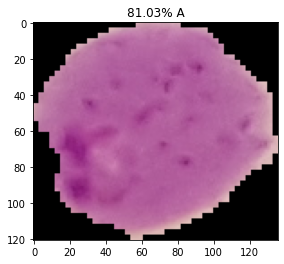

pos/pos4051.jpg


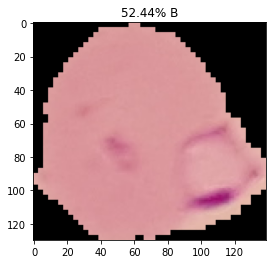

pos/pos4052.jpg


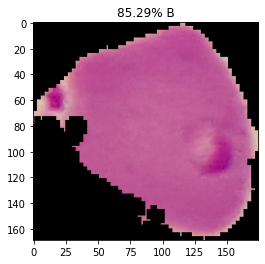

pos/pos4053.jpg


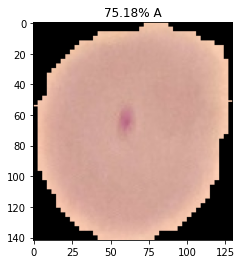

pos/pos4054.jpg


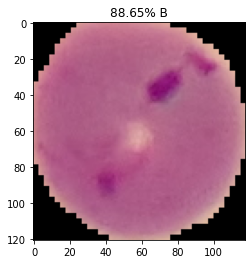

pos/pos4055.jpg


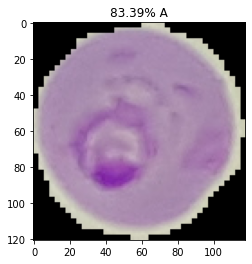

pos/pos4056.jpg


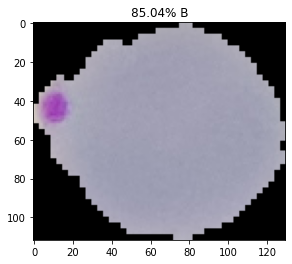

pos/pos4057.jpg


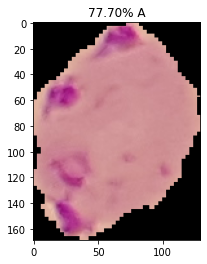

pos/pos4058.jpg


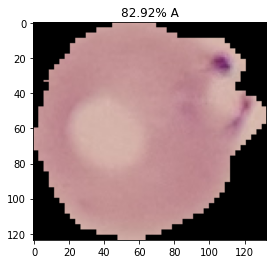

pos/pos4059.jpg


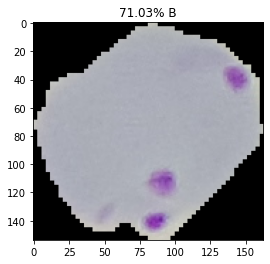

pos/pos4060.jpg


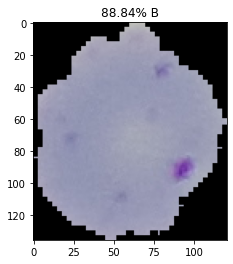

pos/pos4061.jpg


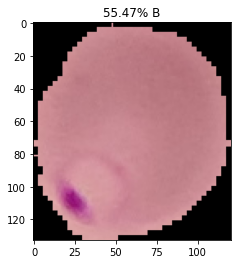

pos/pos4062.jpg


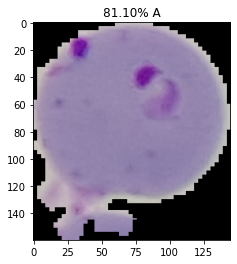

pos/pos4063.jpg


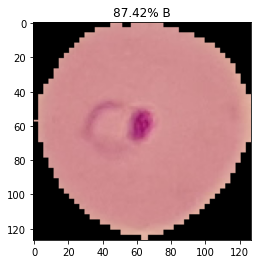

pos/pos4064.jpg


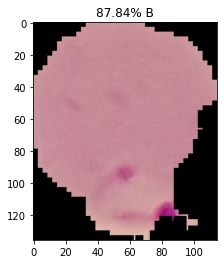

pos/pos4065.jpg


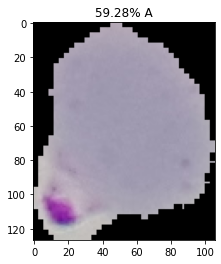

pos/pos4066.jpg


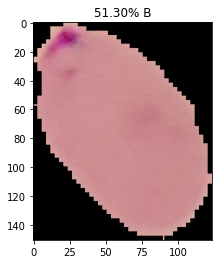

pos/pos4067.jpg


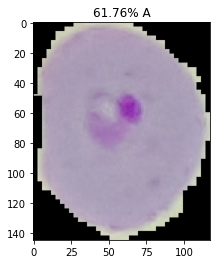

pos/pos4068.jpg


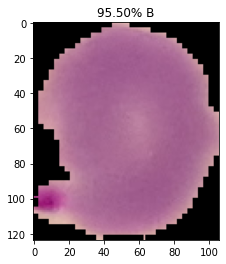

pos/pos4069.jpg


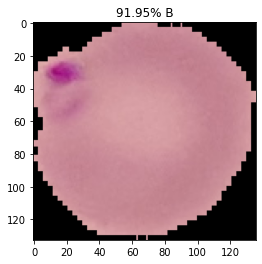

pos/pos4070.jpg


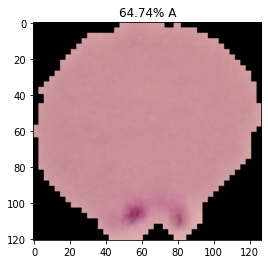

pos/pos4071.jpg


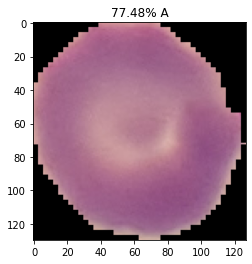

pos/pos4072.jpg


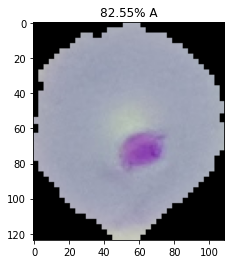

pos/pos4073.jpg


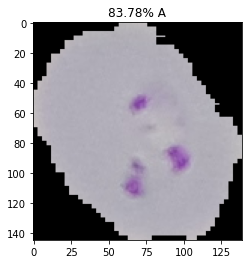

pos/pos4074.jpg


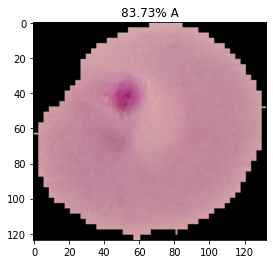

pos/pos4075.jpg


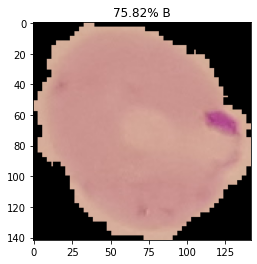

pos/pos4076.jpg


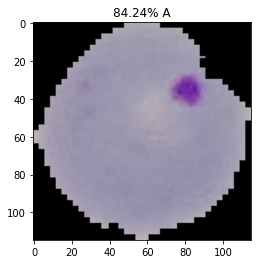

pos/pos4077.jpg


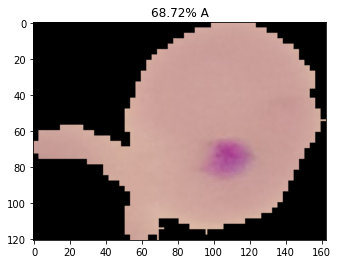

pos/pos4078.jpg


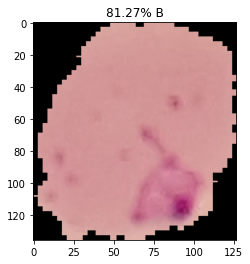

pos/pos4079.jpg


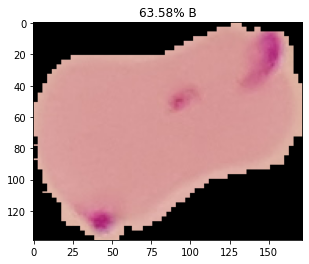

pos/pos4080.jpg


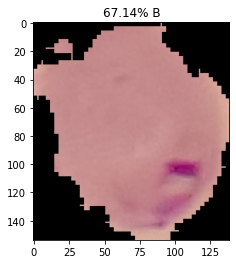

pos/pos4081.jpg


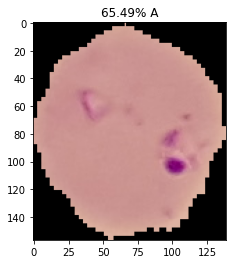

pos/pos4082.jpg


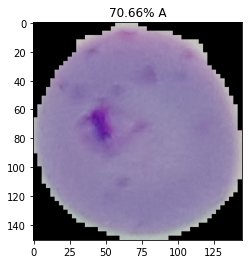

pos/pos4083.jpg


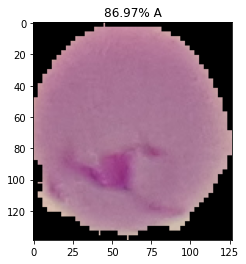

pos/pos4084.jpg


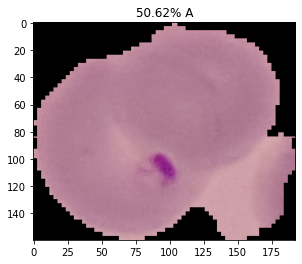

pos/pos4085.jpg


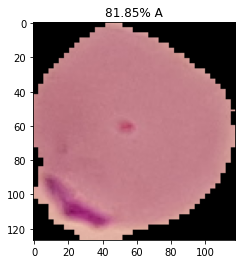

pos/pos4086.jpg


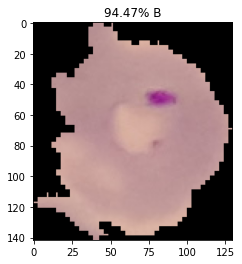

pos/pos4087.jpg


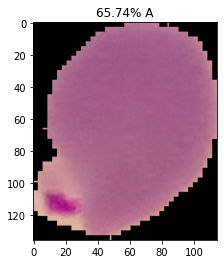

pos/pos4088.jpg


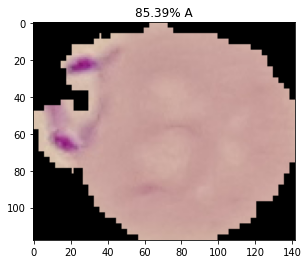

pos/pos4089.jpg


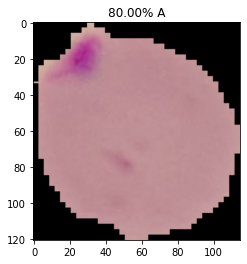

pos/pos4090.jpg


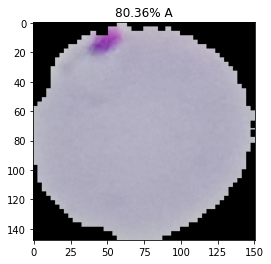

pos/pos4091.jpg


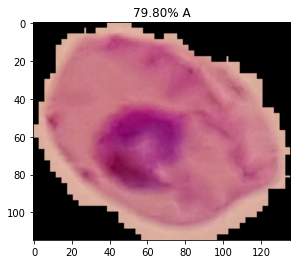

pos/pos4092.jpg


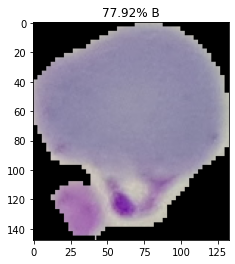

pos/pos4093.jpg


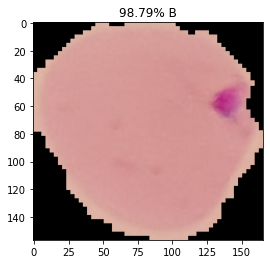

pos/pos4094.jpg


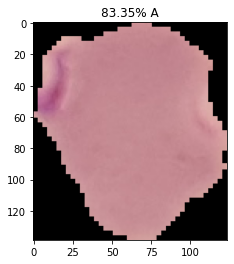

pos/pos4095.jpg


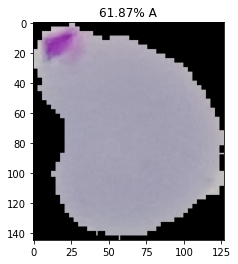

pos/pos4096.jpg


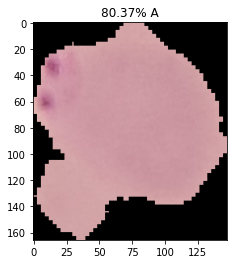

pos/pos4097.jpg


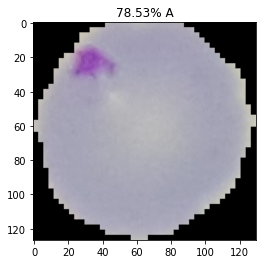

pos/pos4098.jpg


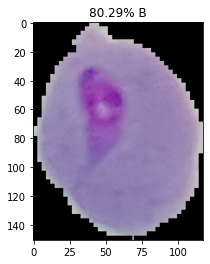

pos/pos4099.jpg


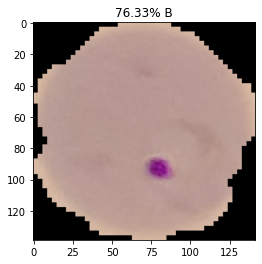

pos/pos4100.jpg


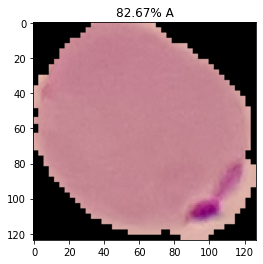

pos/pos4101.jpg


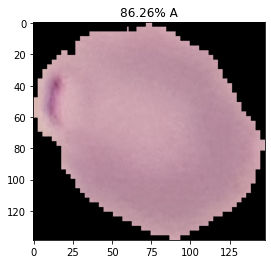

pos/pos4102.jpg


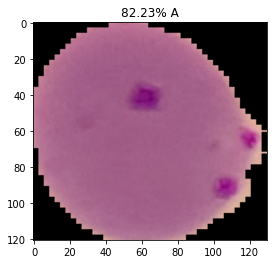

pos/pos4103.jpg


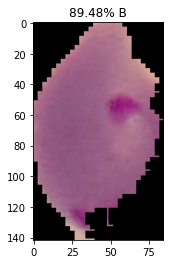

pos/pos4104.jpg


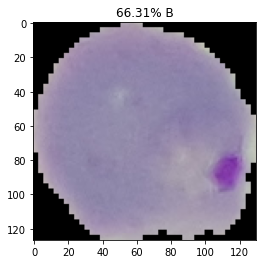

pos/pos4105.jpg


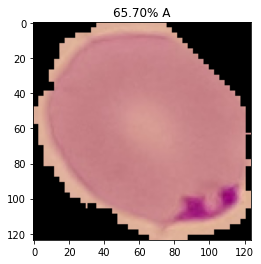

pos/pos4106.jpg


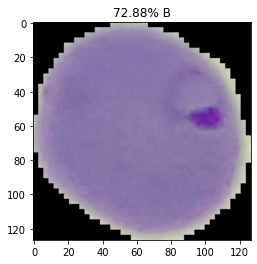

pos/pos4107.jpg


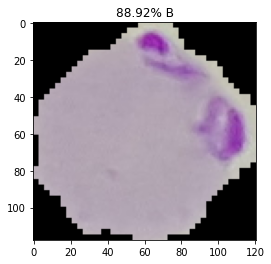

pos/pos4108.jpg


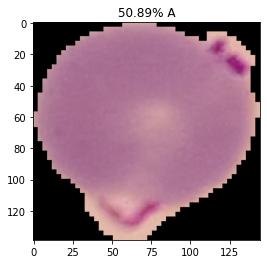

pos/pos4109.jpg


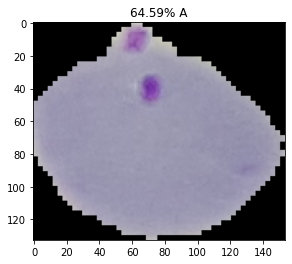

pos/pos4110.jpg


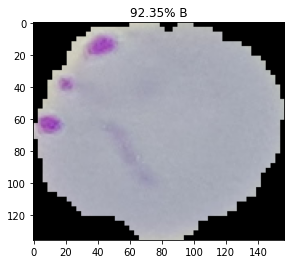

pos/pos4111.jpg


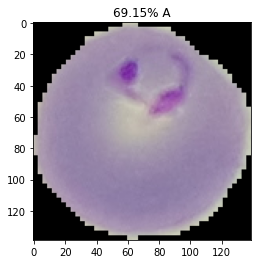

pos/pos4112.jpg


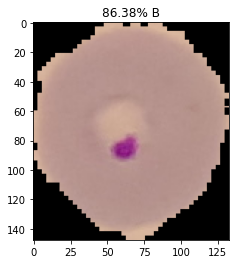

pos/pos4113.jpg


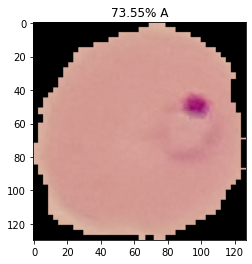

pos/pos4114.jpg


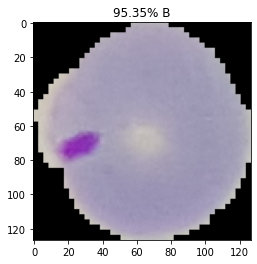

pos/pos4115.jpg


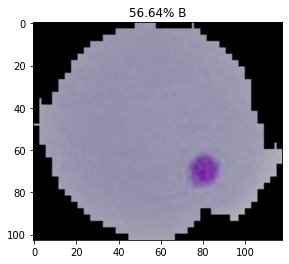

pos/pos4116.jpg


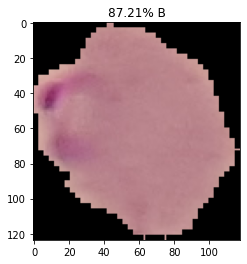

pos/pos4117.jpg


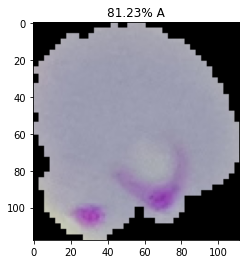

pos/pos4118.jpg


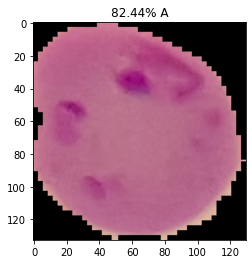

pos/pos4119.jpg


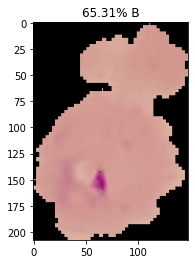

pos/pos4120.jpg


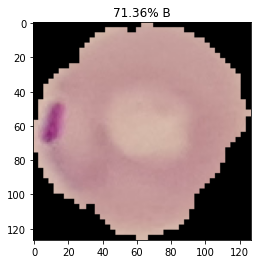

pos/pos4121.jpg


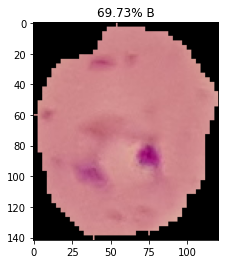

pos/pos4122.jpg


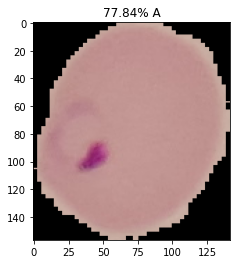

pos/pos4123.jpg


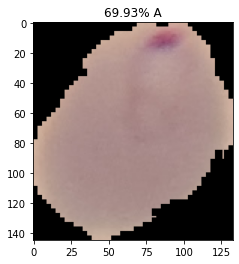

pos/pos4124.jpg


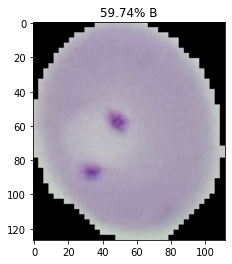

pos/pos4125.jpg


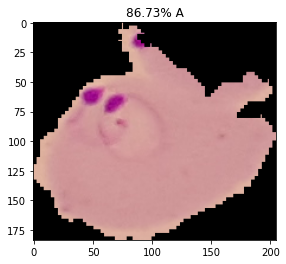

pos/pos4126.jpg


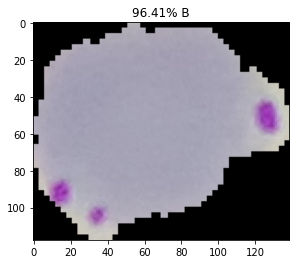

pos/pos4127.jpg


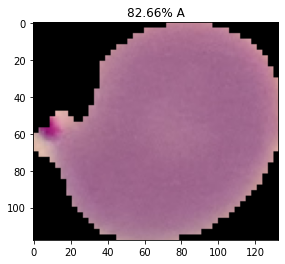

pos/pos4128.jpg


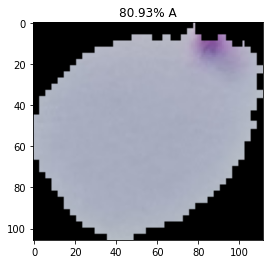

pos/pos4129.jpg


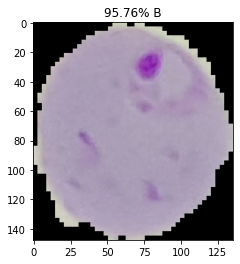

pos/pos4130.jpg


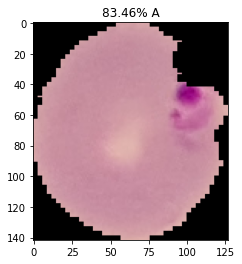

pos/pos4131.jpg


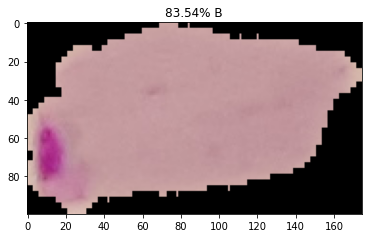

pos/pos4132.jpg


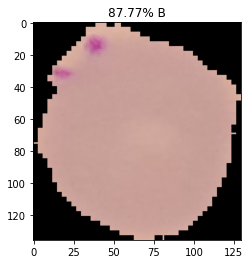

pos/pos4133.jpg


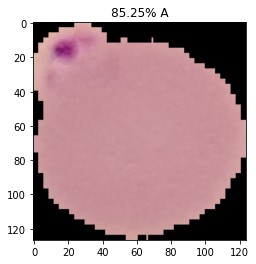

pos/pos4134.jpg


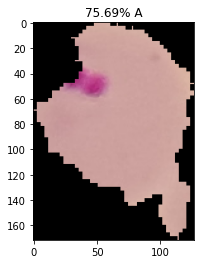

pos/pos4135.jpg


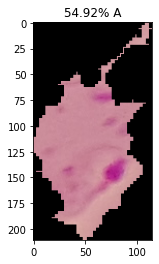

pos/pos4136.jpg


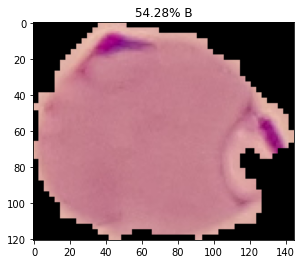

pos/pos4137.jpg


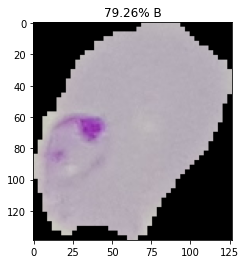

pos/pos4138.jpg


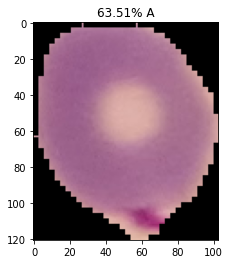

pos/pos4139.jpg


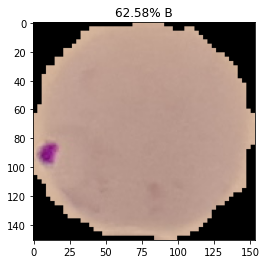

pos/pos4140.jpg


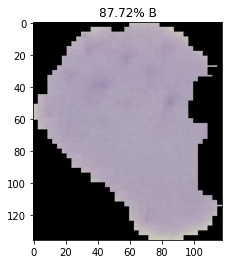

pos/pos4141.jpg


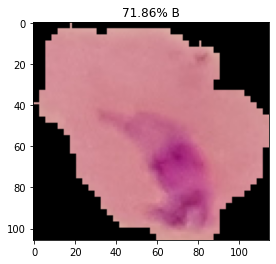

pos/pos4142.jpg


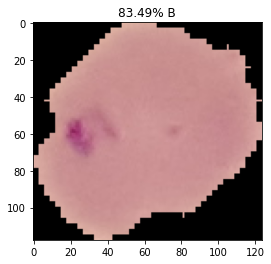

pos/pos4143.jpg


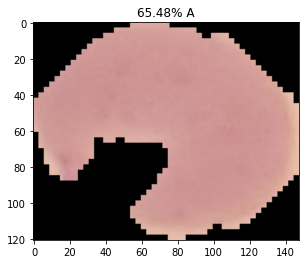

pos/pos4144.jpg


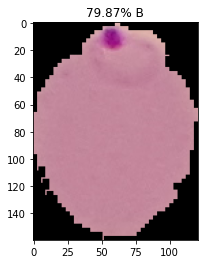

pos/pos4145.jpg


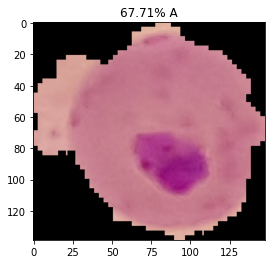

pos/pos4146.jpg


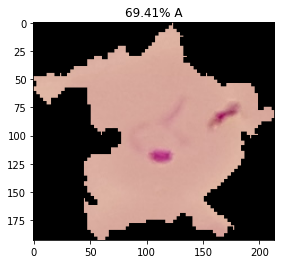

pos/pos4147.jpg


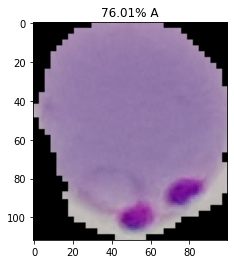

pos/pos4148.jpg


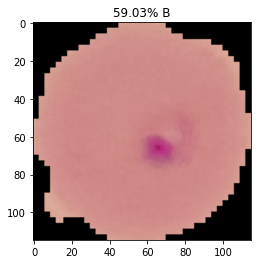

pos/pos4149.jpg


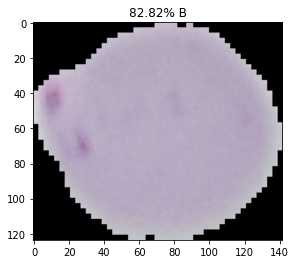

pos/pos4150.jpg


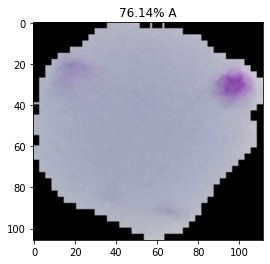

pos/pos4151.jpg


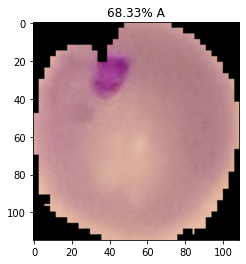

pos/pos4152.jpg


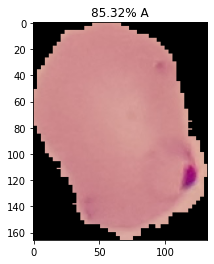

pos/pos4153.jpg


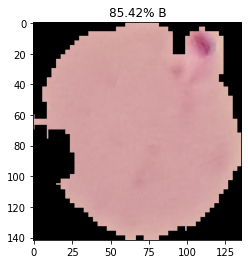

pos/pos4154.jpg


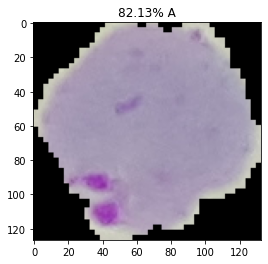

pos/pos4155.jpg


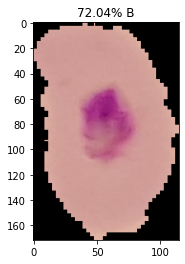

pos/pos4156.jpg


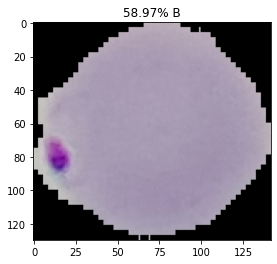

pos/pos4157.jpg


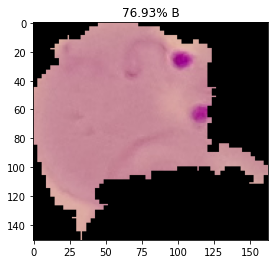

pos/pos4158.jpg


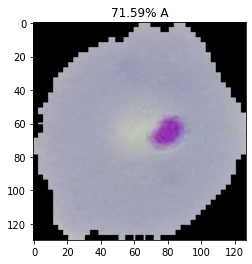

pos/pos4159.jpg


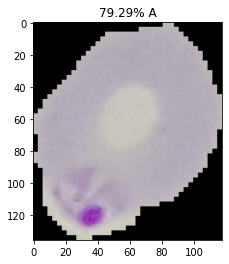

pos/pos4160.jpg


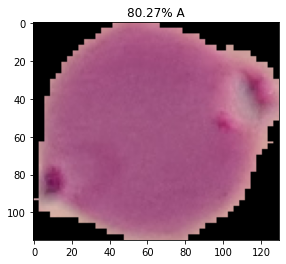

pos/pos4161.jpg


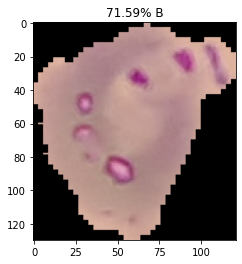

pos/pos4162.jpg


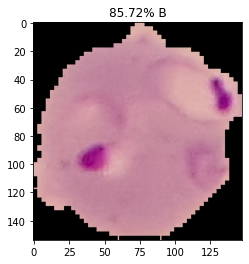

pos/pos4163.jpg


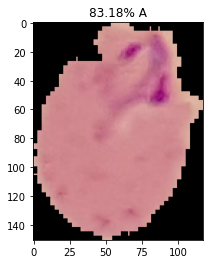

pos/pos4164.jpg


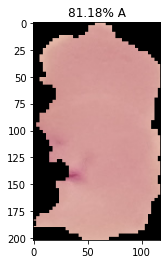

pos/pos4165.jpg


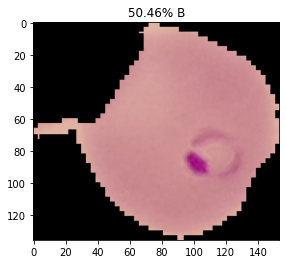

pos/pos4166.jpg


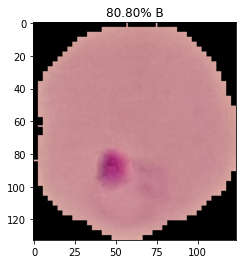

pos/pos4167.jpg


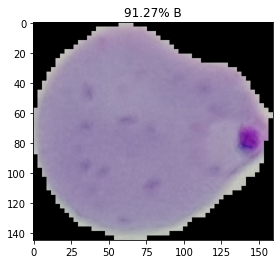

pos/pos4168.jpg


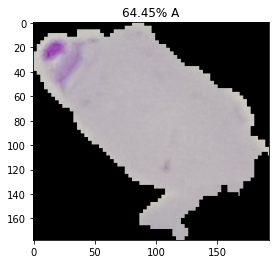

pos/pos4169.jpg


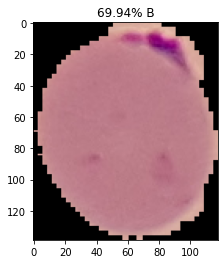

pos/pos4170.jpg


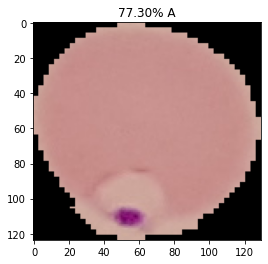

pos/pos4171.jpg


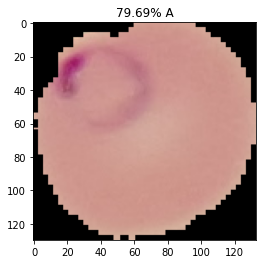

pos/pos4172.jpg


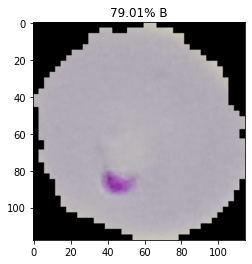

pos/pos4173.jpg


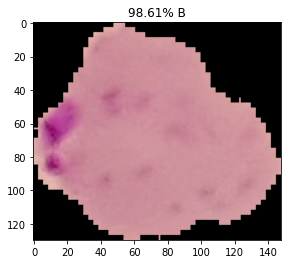

pos/pos4174.jpg


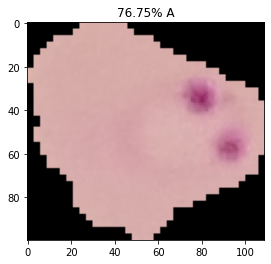

pos/pos4175.jpg


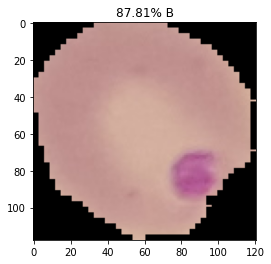

pos/pos4176.jpg


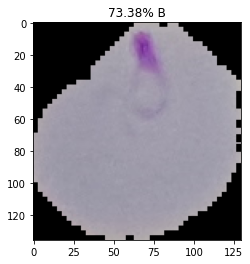

pos/pos4177.jpg


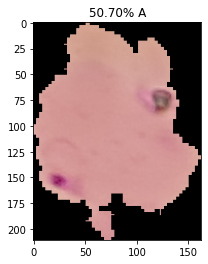

pos/pos4178.jpg


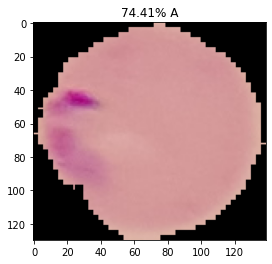

pos/pos4179.jpg


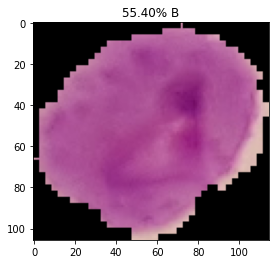

pos/pos4180.jpg


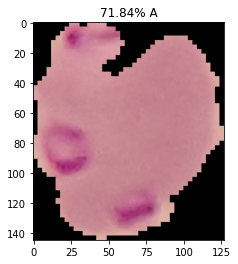

pos/pos4181.jpg


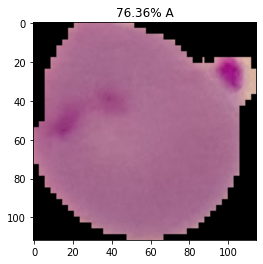

pos/pos4182.jpg


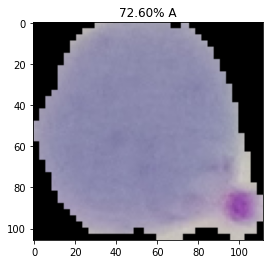

pos/pos4183.jpg


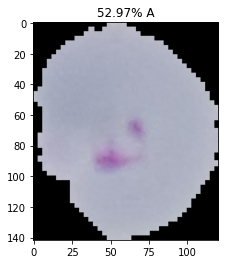

pos/pos4184.jpg


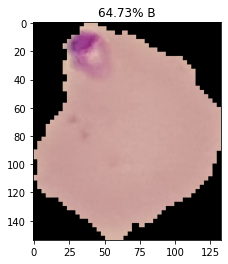

pos/pos4185.jpg


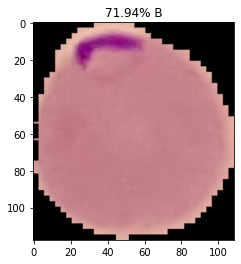

pos/pos4186.jpg


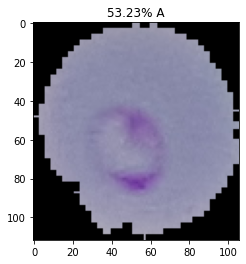

pos/pos4187.jpg


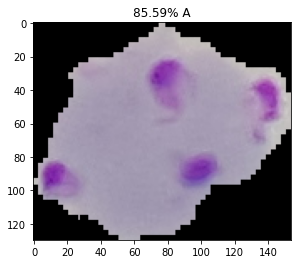

pos/pos4188.jpg


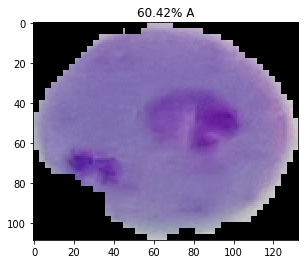

pos/pos4189.jpg


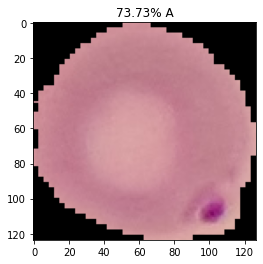

pos/pos4190.jpg


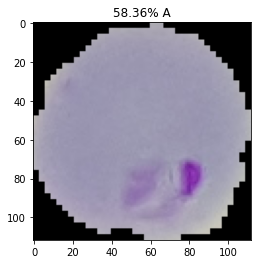

pos/pos4191.jpg


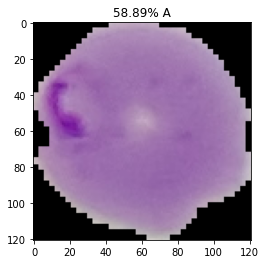

pos/pos4192.jpg


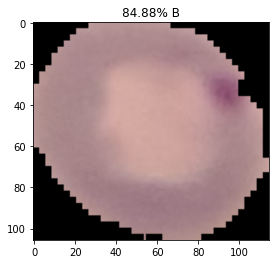

pos/pos4193.jpg


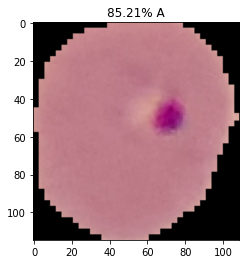

pos/pos4194.jpg


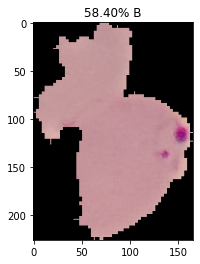

pos/pos4195.jpg


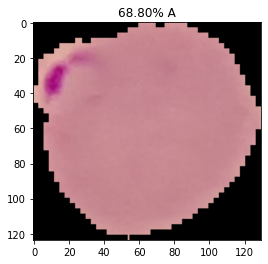

pos/pos4196.jpg


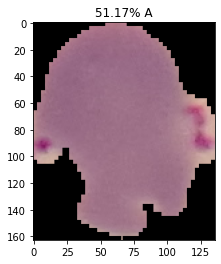

pos/pos4197.jpg


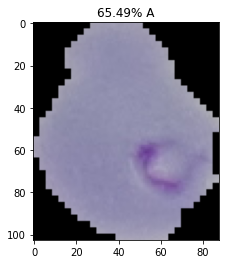

pos/pos4198.jpg


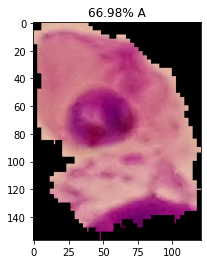

pos/pos4199.jpg


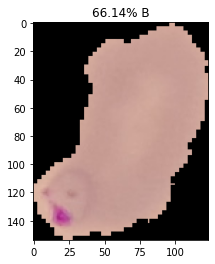

pos/pos4200.jpg


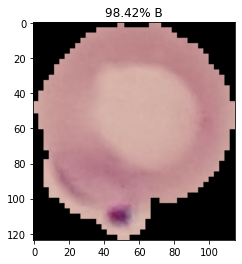

pos/pos4201.jpg


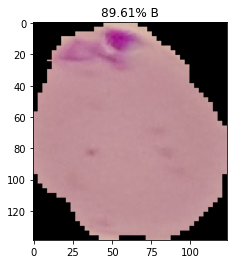

pos/pos4202.jpg


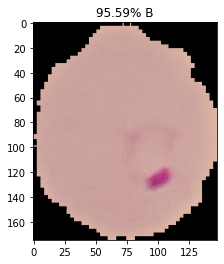

pos/pos4203.jpg


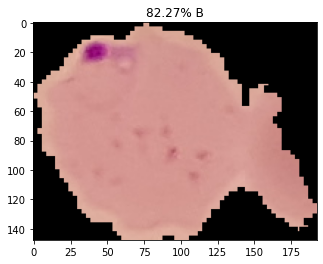

pos/pos4204.jpg


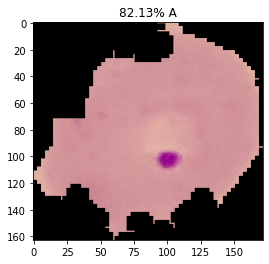

pos/pos4205.jpg


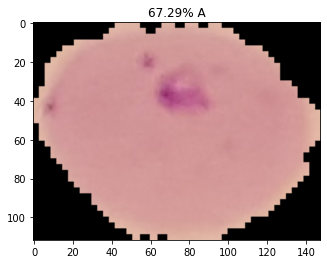

pos/pos4206.jpg


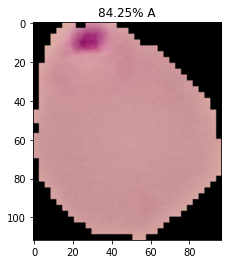

pos/pos4207.jpg


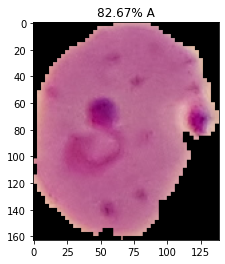

pos/pos4208.jpg


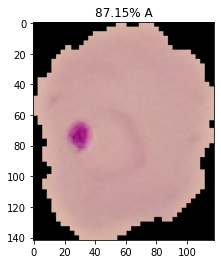

pos/pos4209.jpg


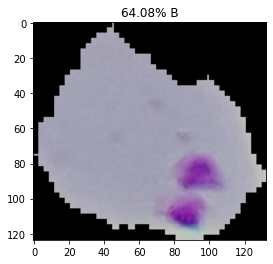

pos/pos4210.jpg


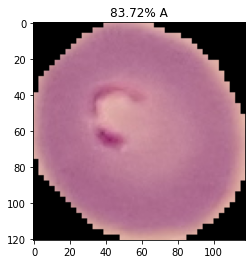

pos/pos4211.jpg


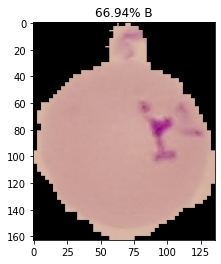

pos/pos4212.jpg


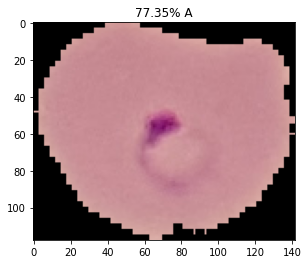

pos/pos4213.jpg


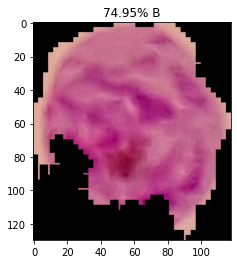

pos/pos4214.jpg


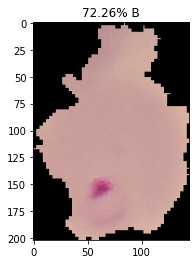

pos/pos4215.jpg


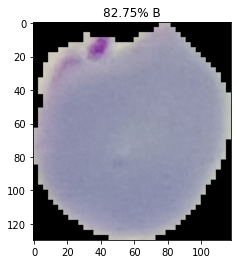

pos/pos4216.jpg


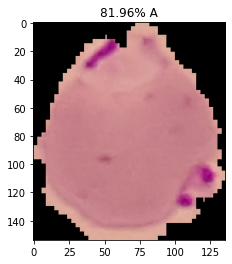

pos/pos4217.jpg


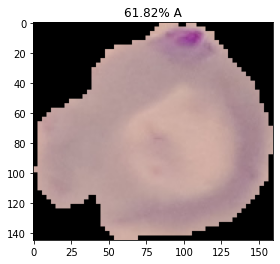

pos/pos4218.jpg


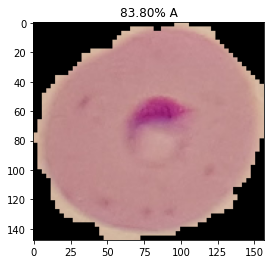

pos/pos4219.jpg


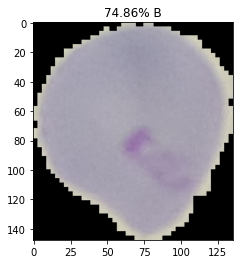

pos/pos4220.jpg


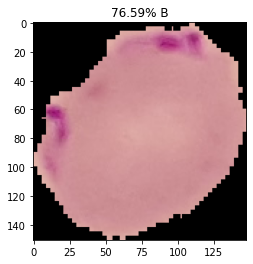

pos/pos4221.jpg


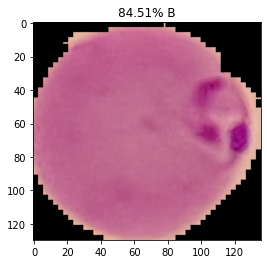

pos/pos4222.jpg


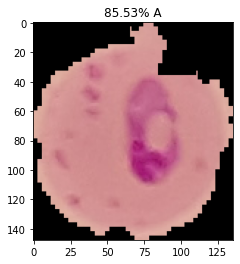

pos/pos4223.jpg


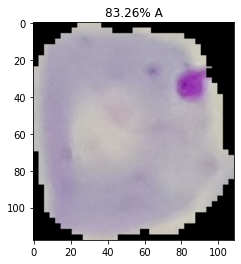

pos/pos4224.jpg


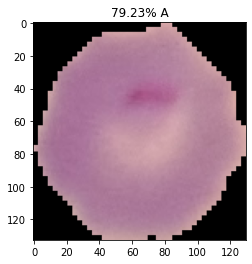

pos/pos4225.jpg


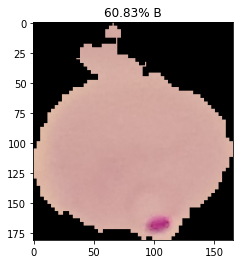

pos/pos4226.jpg


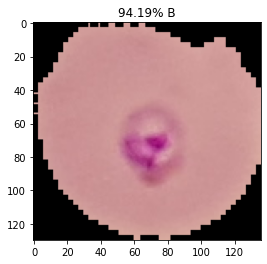

pos/pos4227.jpg


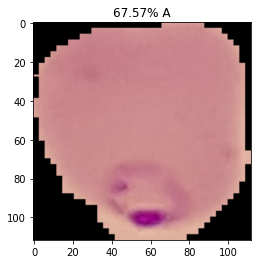

pos/pos4228.jpg


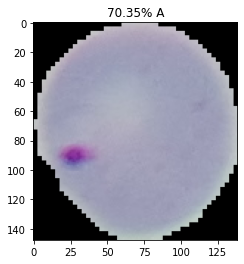

pos/pos4229.jpg


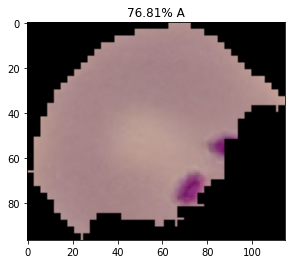

pos/pos4230.jpg


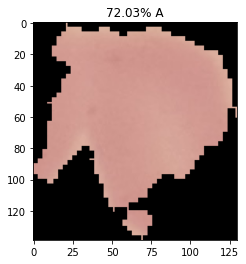

pos/pos4231.jpg


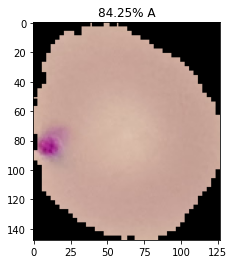

pos/pos4232.jpg


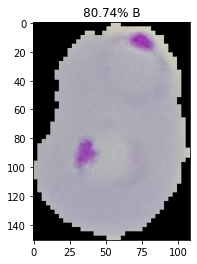

pos/pos4233.jpg


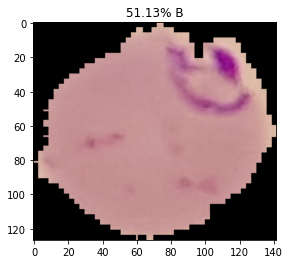

pos/pos4234.jpg


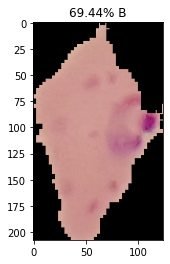

pos/pos4235.jpg


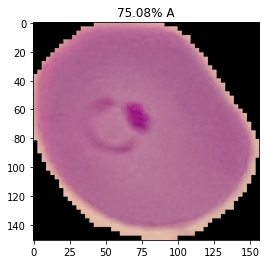

pos/pos4236.jpg


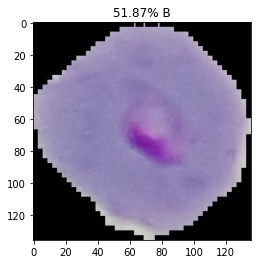

pos/pos4237.jpg


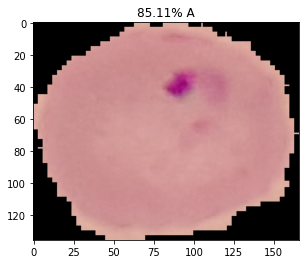

pos/pos4238.jpg


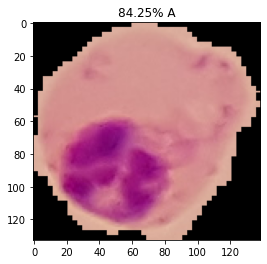

pos/pos4239.jpg


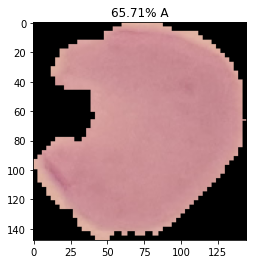

pos/pos4240.jpg


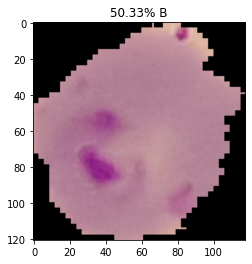

pos/pos4241.jpg


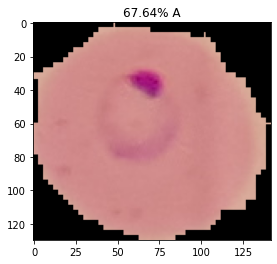

pos/pos4242.jpg


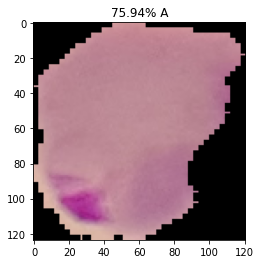

pos/pos4243.jpg


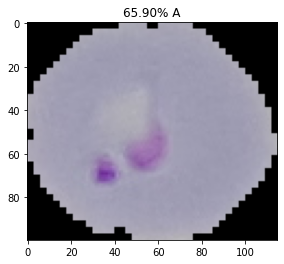

pos/pos4244.jpg


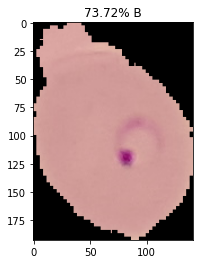

pos/pos4245.jpg


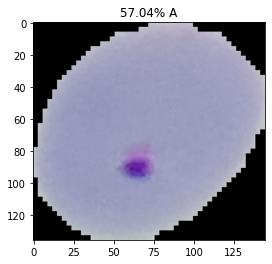

pos/pos4246.jpg


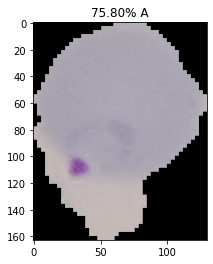

pos/pos4247.jpg


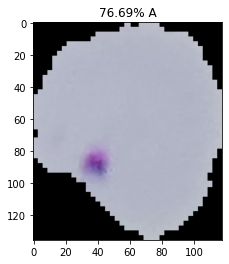

pos/pos4248.jpg


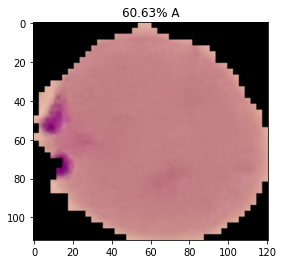

pos/pos4249.jpg


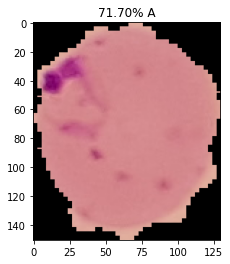

pos/pos4250.jpg


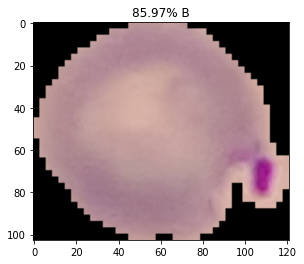

pos/pos4251.jpg


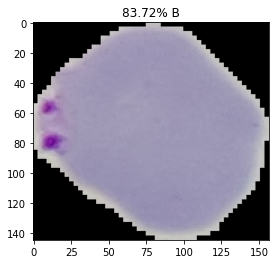

pos/pos4252.jpg


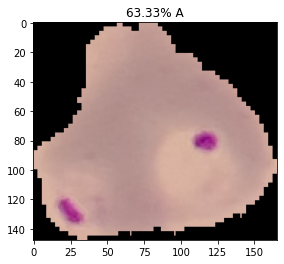

pos/pos4253.jpg


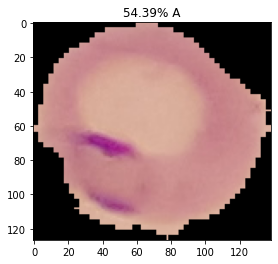

pos/pos4254.jpg


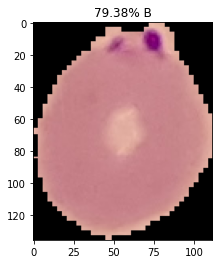

pos/pos4255.jpg


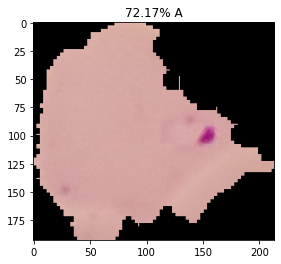

pos/pos4256.jpg


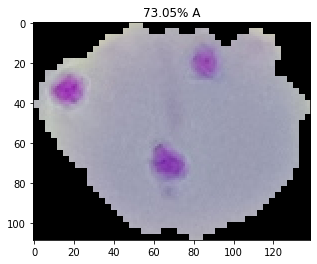

pos/pos4257.jpg


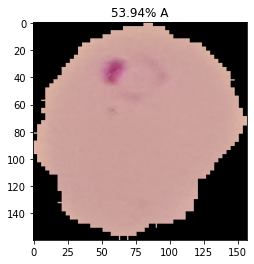

pos/pos4258.jpg


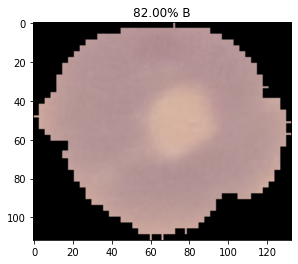

pos/pos4259.jpg


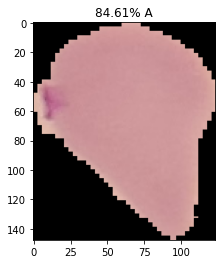

pos/pos4260.jpg


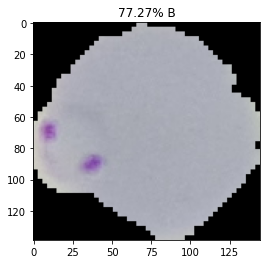

pos/pos4261.jpg


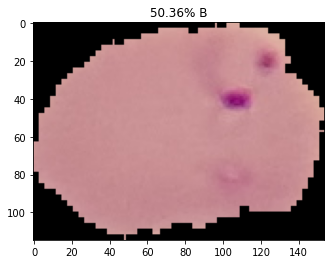

pos/pos4262.jpg


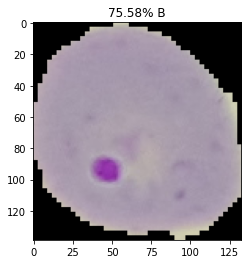

pos/pos4263.jpg


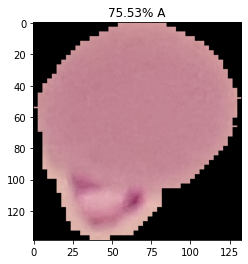

pos/pos4264.jpg


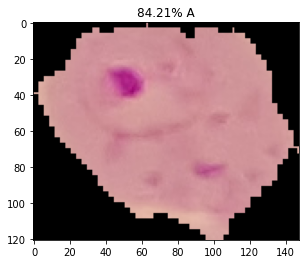

pos/pos4265.jpg


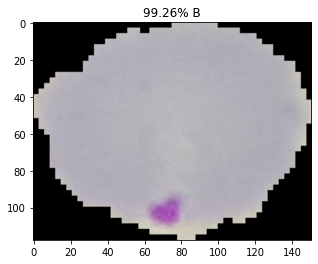

pos/pos4266.jpg


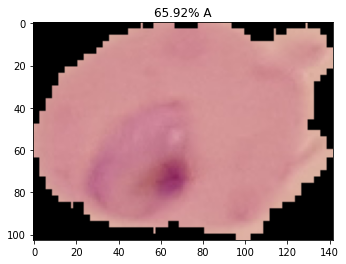

pos/pos4267.jpg


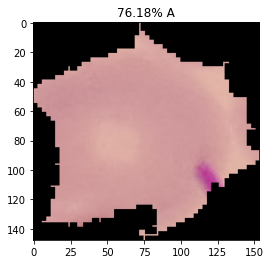

pos/pos4268.jpg


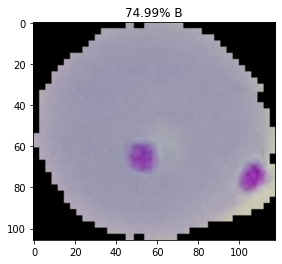

pos/pos4269.jpg


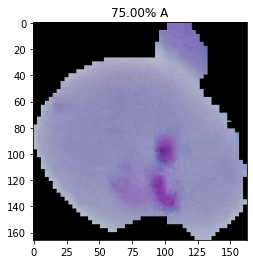

pos/pos4270.jpg


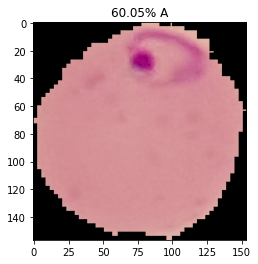

pos/pos4271.jpg


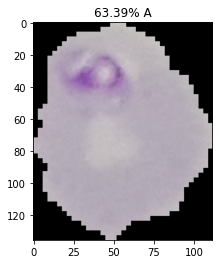

pos/pos4272.jpg


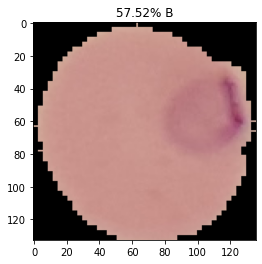

pos/pos4273.jpg


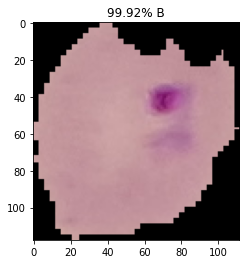

pos/pos4274.jpg


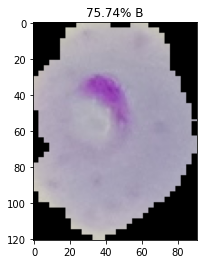

pos/pos4275.jpg


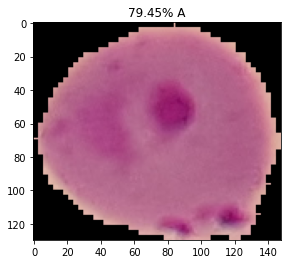

pos/pos4276.jpg


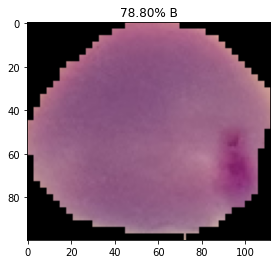

pos/pos4277.jpg


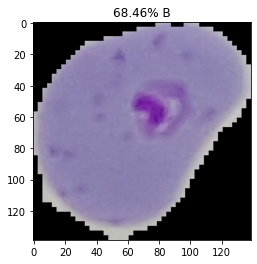

pos/pos4278.jpg


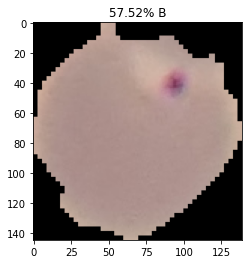

pos/pos4279.jpg


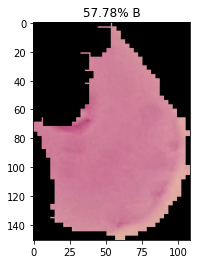

pos/pos4280.jpg


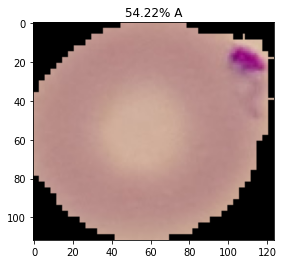

pos/pos4281.jpg


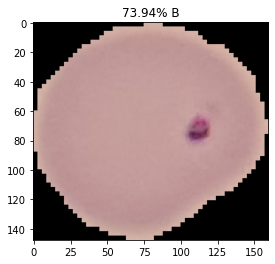

pos/pos4282.jpg


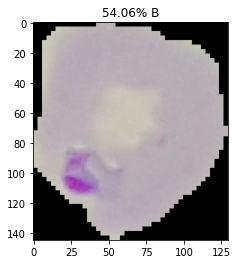

pos/pos4283.jpg


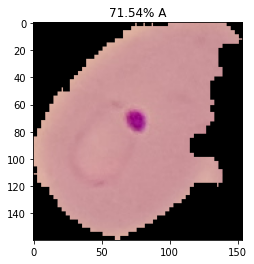

pos/pos4284.jpg


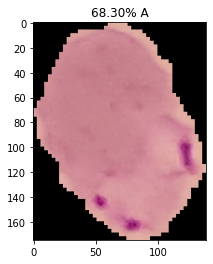

pos/pos4285.jpg


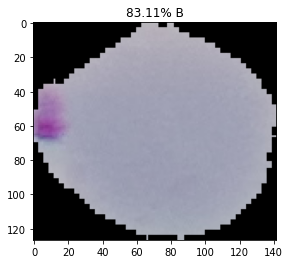

pos/pos4286.jpg


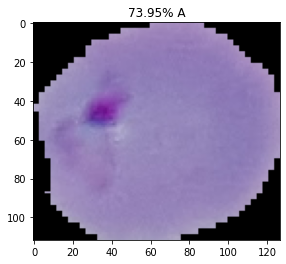

pos/pos4287.jpg


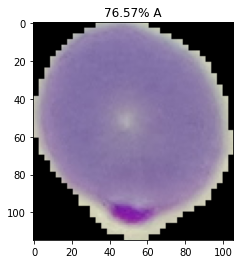

pos/pos4288.jpg


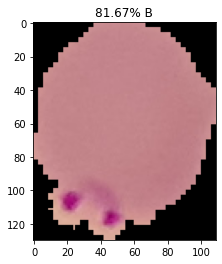

pos/pos4289.jpg


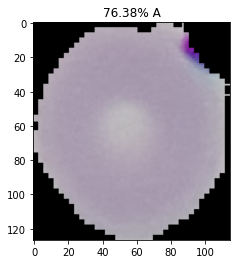

pos/pos4290.jpg


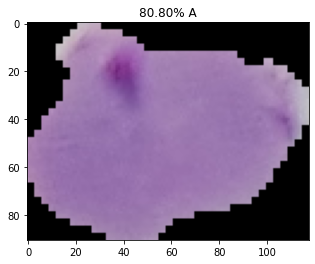

pos/pos4291.jpg


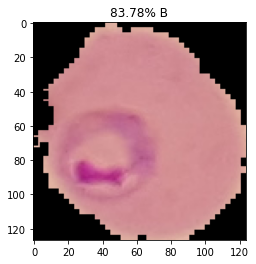

pos/pos4292.jpg


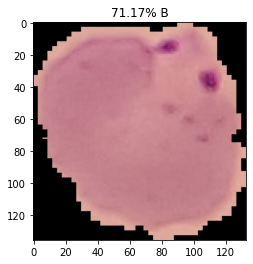

pos/pos4293.jpg


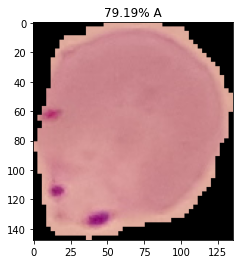

pos/pos4294.jpg


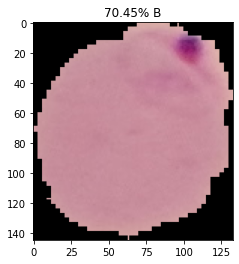

pos/pos4295.jpg


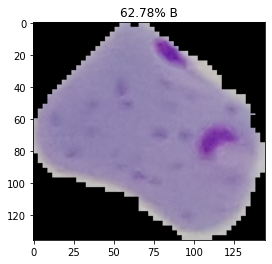

pos/pos4296.jpg


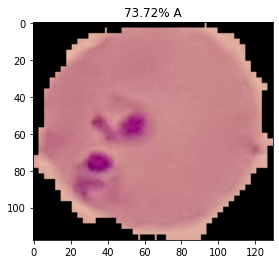

pos/pos4297.jpg


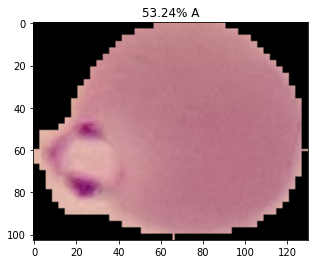

pos/pos4298.jpg


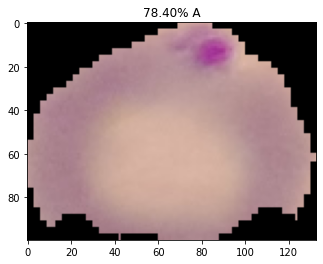

pos/pos4299.jpg


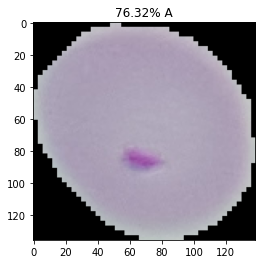

pos/pos4300.jpg


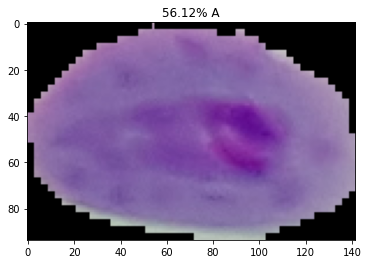

pos/pos4301.jpg


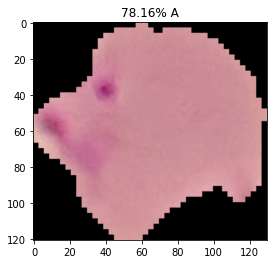

pos/pos4302.jpg


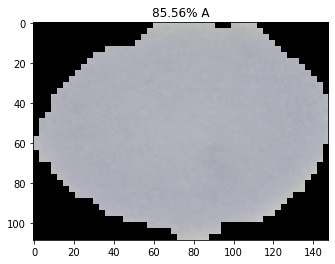

pos/pos4303.jpg


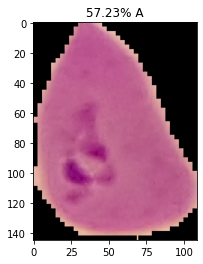

pos/pos4304.jpg


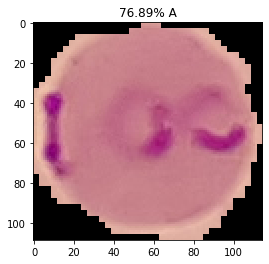

pos/pos4305.jpg


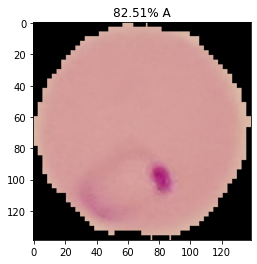

pos/pos4306.jpg


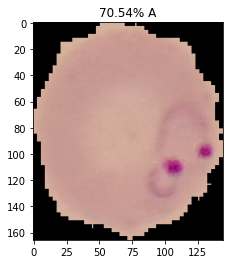

pos/pos4307.jpg


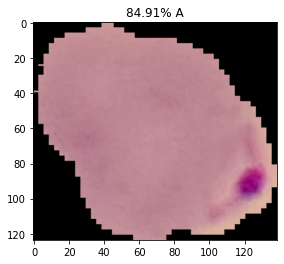

pos/pos4308.jpg


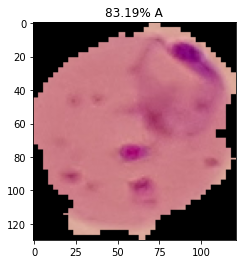

pos/pos4309.jpg


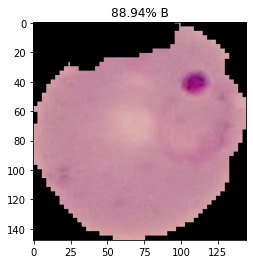

pos/pos4310.jpg


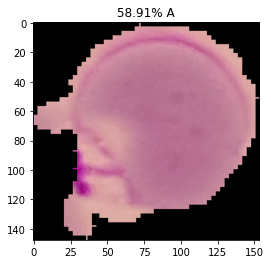

pos/pos4311.jpg


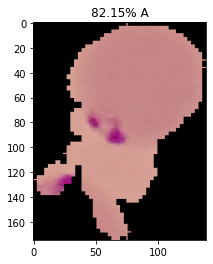

pos/pos4312.jpg


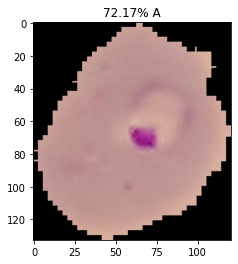

pos/pos4313.jpg


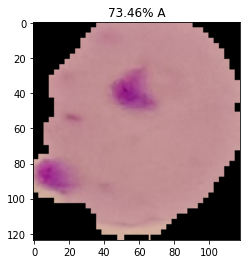

pos/pos4314.jpg


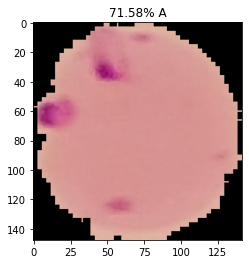

pos/pos4315.jpg


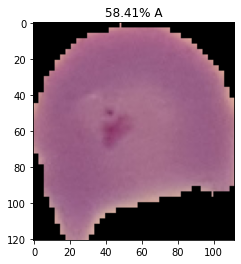

pos/pos4316.jpg


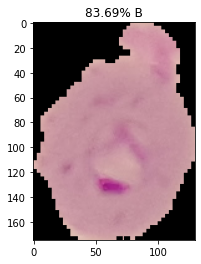

pos/pos4317.jpg


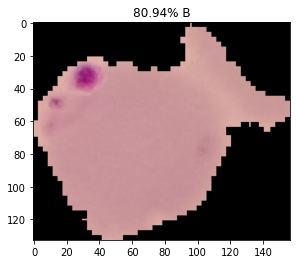

pos/pos4318.jpg


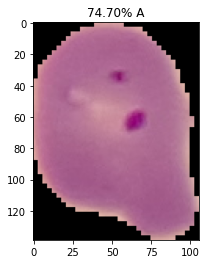

pos/pos4319.jpg


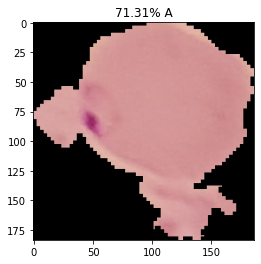

pos/pos4320.jpg


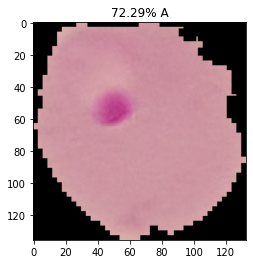

pos/pos4321.jpg


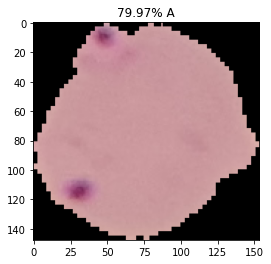

pos/pos4322.jpg


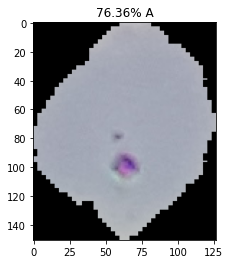

pos/pos4323.jpg


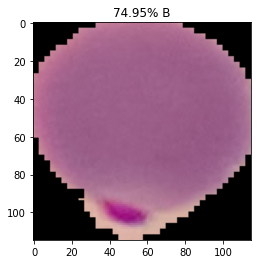

pos/pos4324.jpg


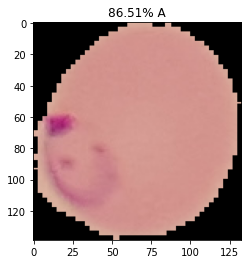

pos/pos4325.jpg


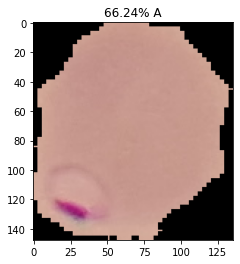

pos/pos4326.jpg


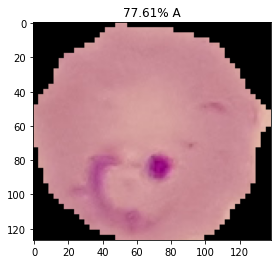

pos/pos4327.jpg


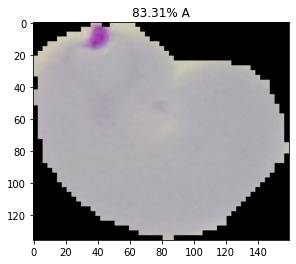

pos/pos4328.jpg


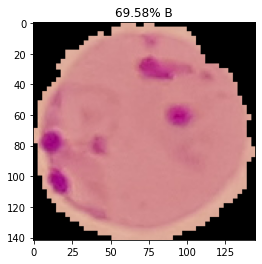

pos/pos4329.jpg


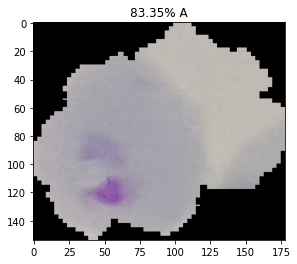

pos/pos4330.jpg


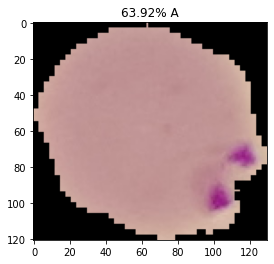

pos/pos4331.jpg


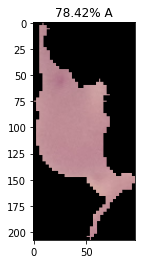

pos/pos4332.jpg


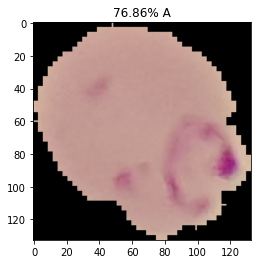

pos/pos4333.jpg


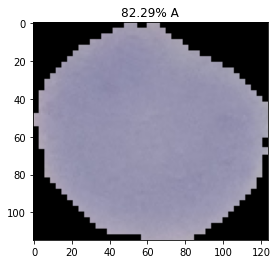

pos/pos4334.jpg


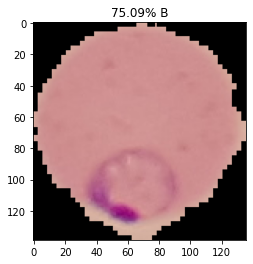

pos/pos4335.jpg


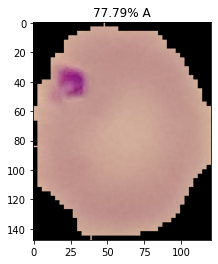

pos/pos4336.jpg


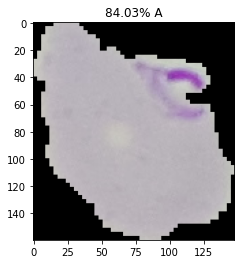

pos/pos4337.jpg


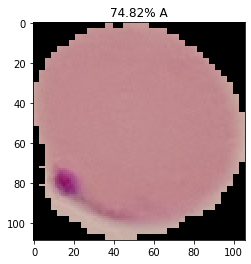

pos/pos4338.jpg


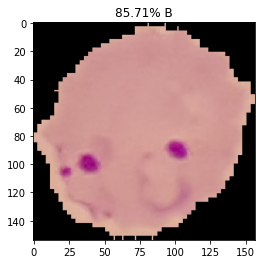

pos/pos4339.jpg


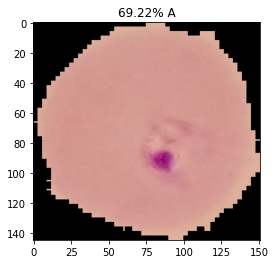

pos/pos4340.jpg


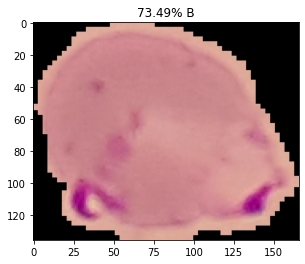

pos/pos4341.jpg


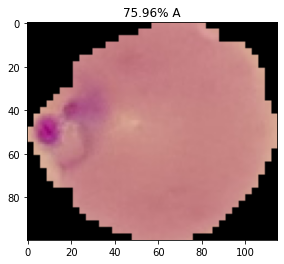

pos/pos4342.jpg


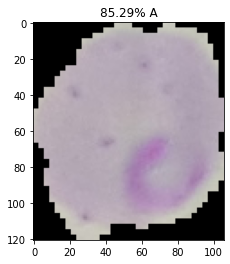

pos/pos4343.jpg


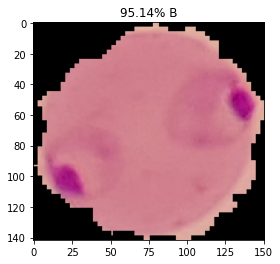

pos/pos4344.jpg


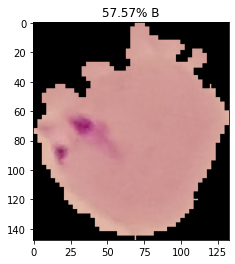

pos/pos4345.jpg


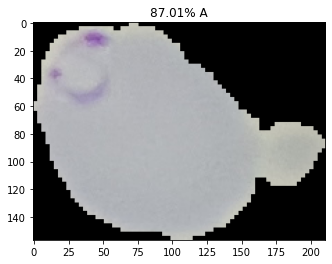

pos/pos4346.jpg


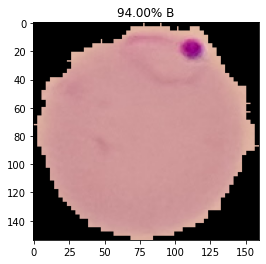

pos/pos4347.jpg


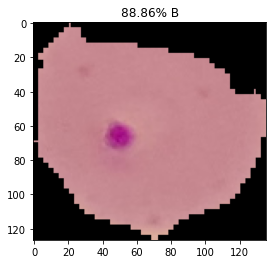

pos/pos4348.jpg


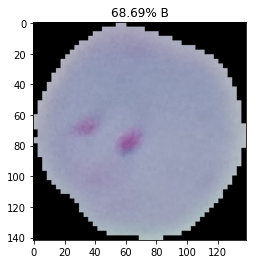

pos/pos4349.jpg


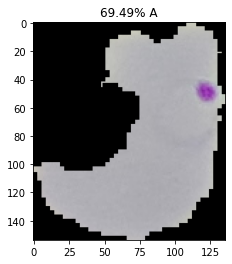

pos/pos4350.jpg


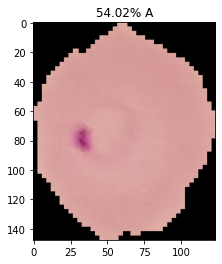

pos/pos4351.jpg


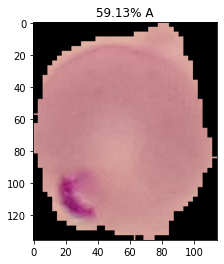

pos/pos4352.jpg


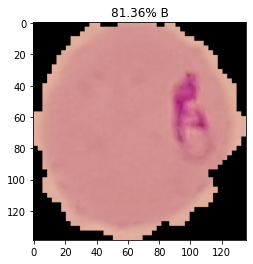

pos/pos4353.jpg


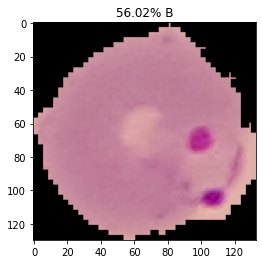

pos/pos4354.jpg


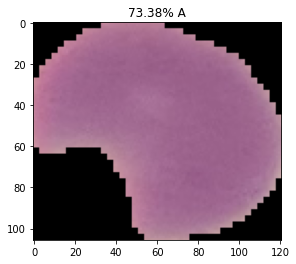

pos/pos4355.jpg


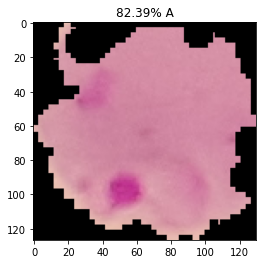

pos/pos4356.jpg


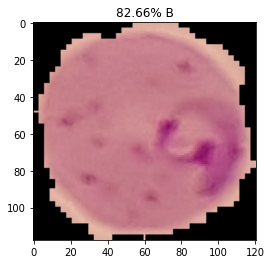

pos/pos4357.jpg


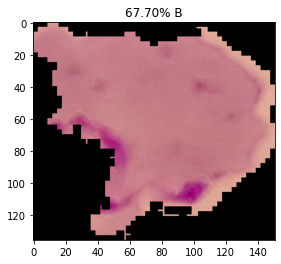

pos/pos4358.jpg


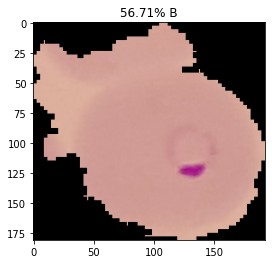

pos/pos4359.jpg


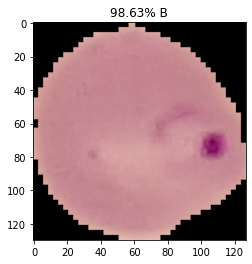

pos/pos4360.jpg


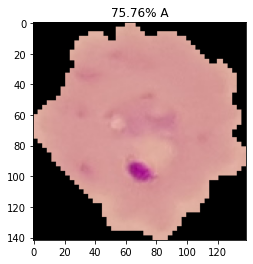

pos/pos4361.jpg


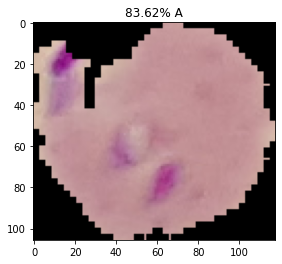

pos/pos4362.jpg


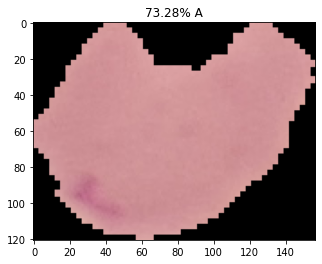

pos/pos4363.jpg


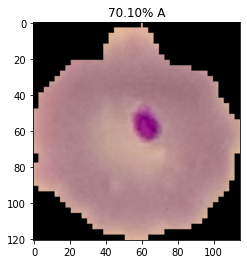

pos/pos4364.jpg


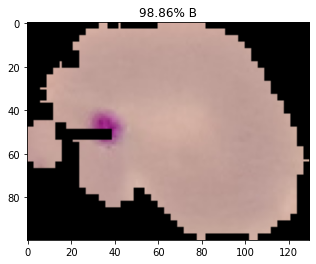

pos/pos4365.jpg


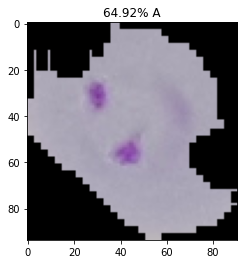

pos/pos4366.jpg


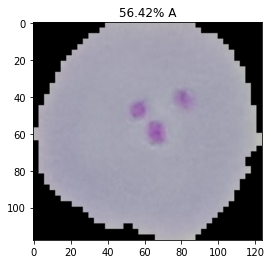

pos/pos4367.jpg


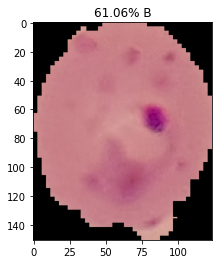

pos/pos4368.jpg


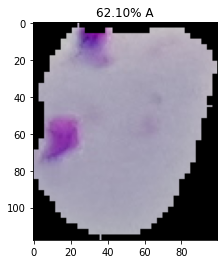

pos/pos4369.jpg


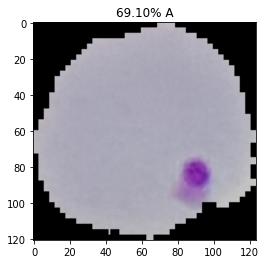

pos/pos4370.jpg


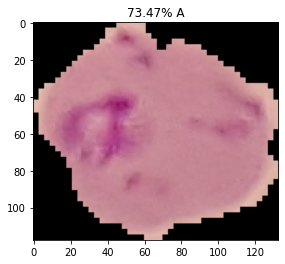

pos/pos4371.jpg


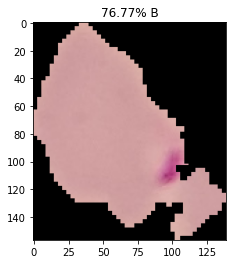

pos/pos4372.jpg


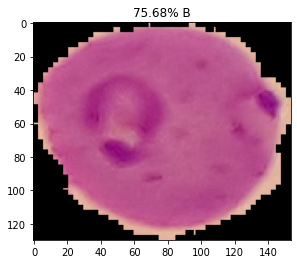

pos/pos4373.jpg


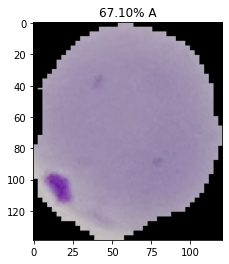

pos/pos4374.jpg


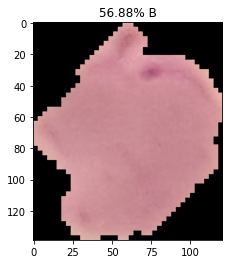

pos/pos4375.jpg


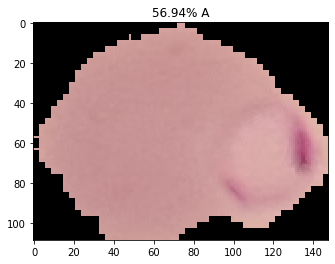

pos/pos4376.jpg


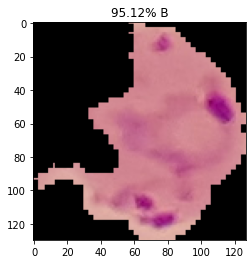

pos/pos4377.jpg


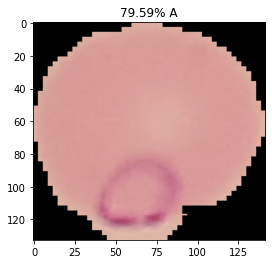

pos/pos4378.jpg


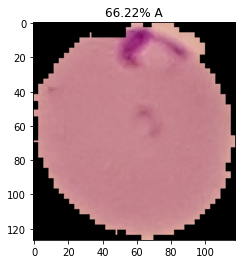

pos/pos4379.jpg


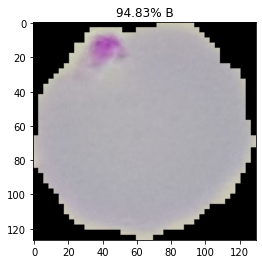

pos/pos4380.jpg


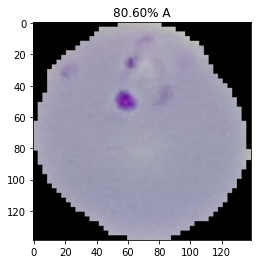

pos/pos4381.jpg


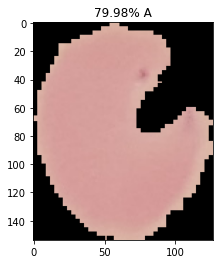

pos/pos4382.jpg


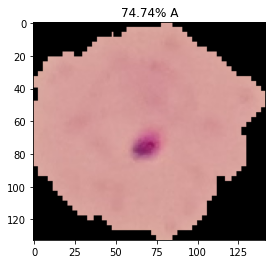

pos/pos4383.jpg


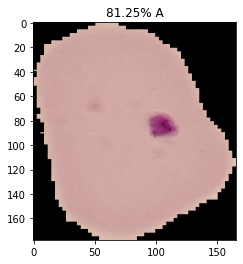

pos/pos4384.jpg


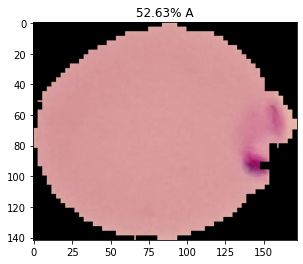

pos/pos4385.jpg


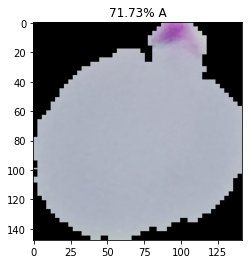

pos/pos4386.jpg


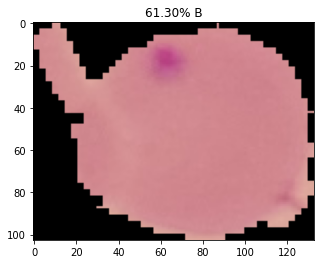

pos/pos4387.jpg


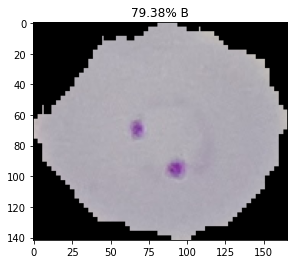

pos/pos4388.jpg


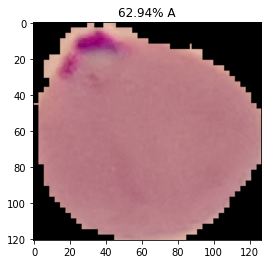

pos/pos4389.jpg


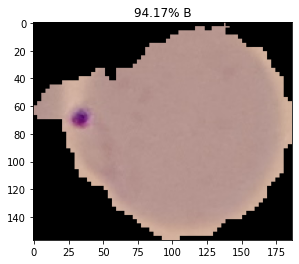

pos/pos4390.jpg


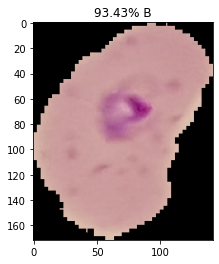

pos/pos4391.jpg


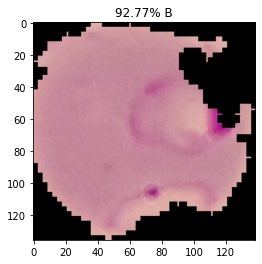

pos/pos4392.jpg


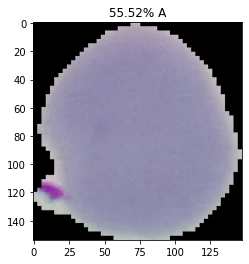

pos/pos4393.jpg


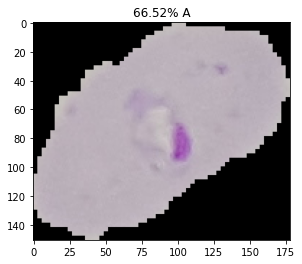

pos/pos4394.jpg


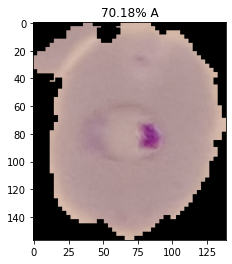

pos/pos4395.jpg


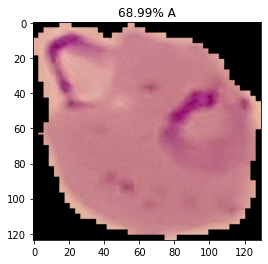

pos/pos4396.jpg


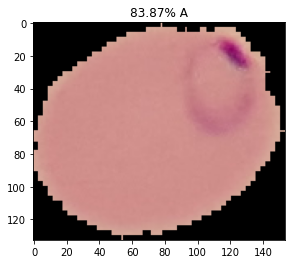

pos/pos4397.jpg


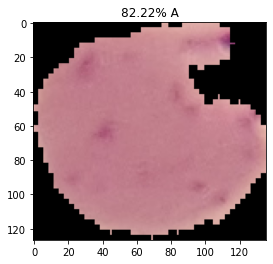

pos/pos4398.jpg


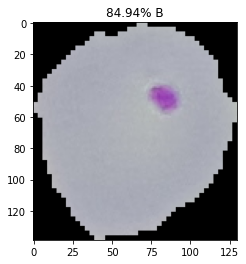

pos/pos4399.jpg


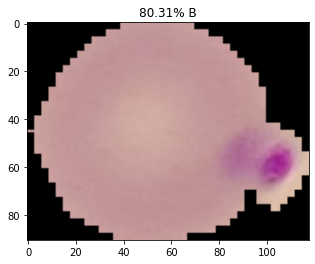

pos/pos4400.jpg


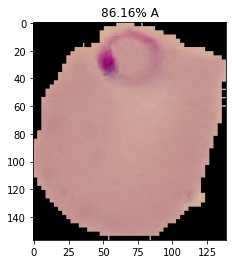

pos/pos4401.jpg


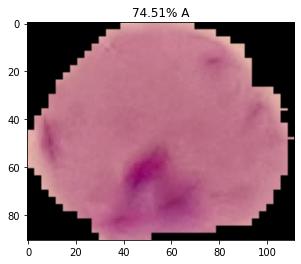

pos/pos4402.jpg


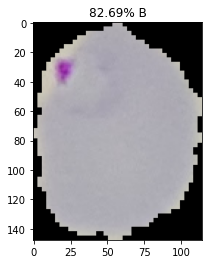

pos/pos4403.jpg


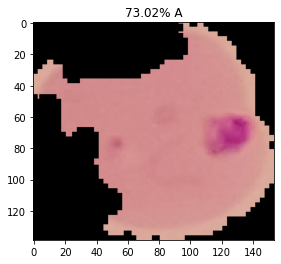

pos/pos4404.jpg


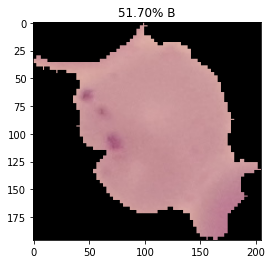

pos/pos4405.jpg


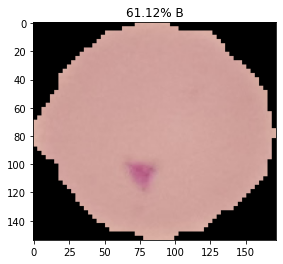

pos/pos4406.jpg


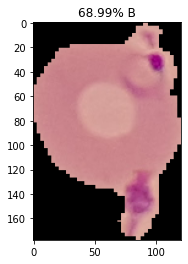

pos/pos4407.jpg


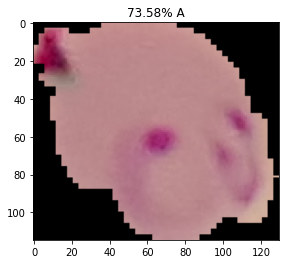

pos/pos4408.jpg


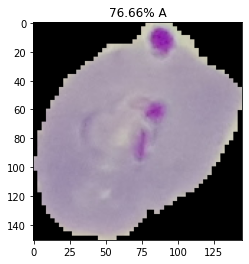

pos/pos4409.jpg


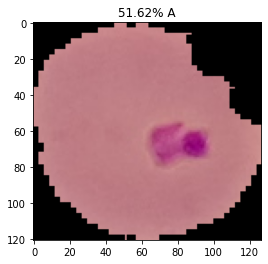

pos/pos4410.jpg


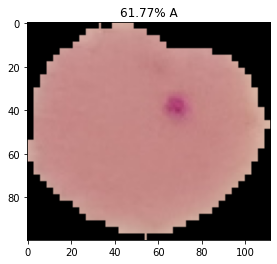

pos/pos4411.jpg


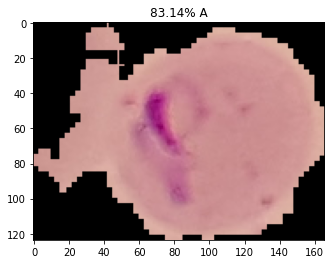

pos/pos4412.jpg


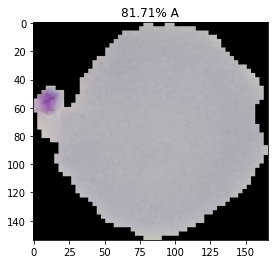

pos/pos4413.jpg


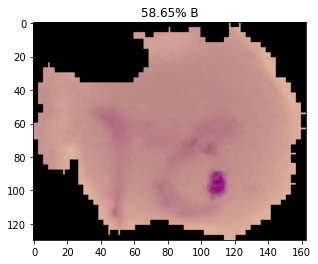

pos/pos4414.jpg


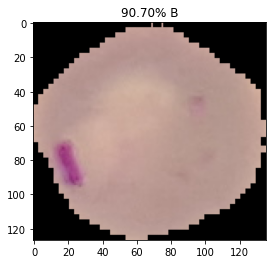

pos/pos4415.jpg


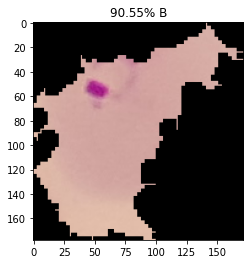

pos/pos4416.jpg


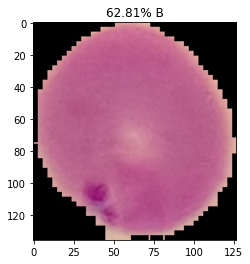

pos/pos4417.jpg


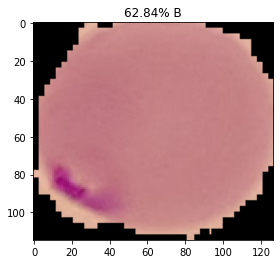

pos/pos4418.jpg


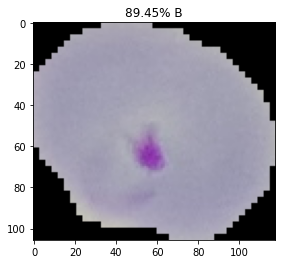

pos/pos4419.jpg


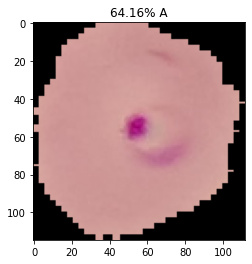

pos/pos4420.jpg


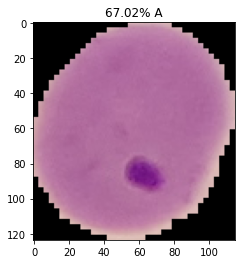

pos/pos4421.jpg


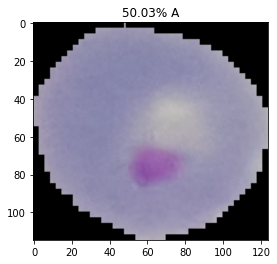

pos/pos4422.jpg


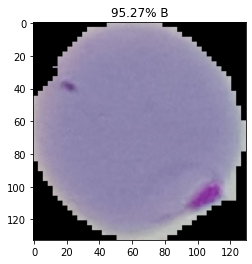

pos/pos4423.jpg


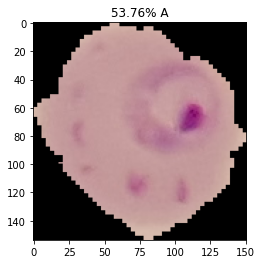

pos/pos4424.jpg


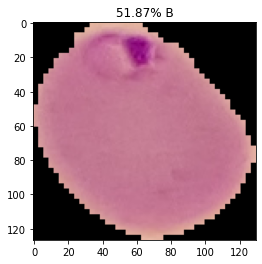

pos/pos4425.jpg


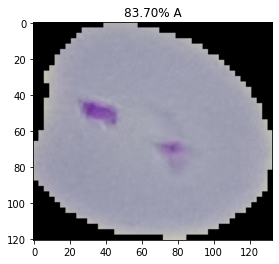

pos/pos4426.jpg


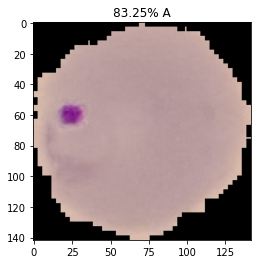

pos/pos4427.jpg


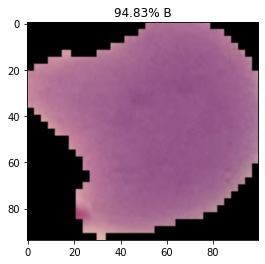

pos/pos4428.jpg


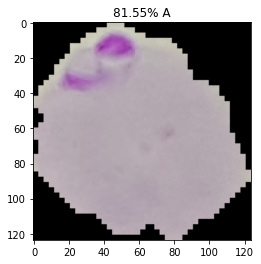

pos/pos4429.jpg


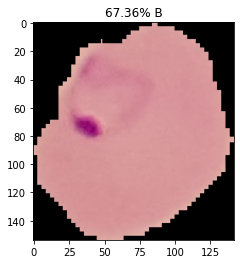

pos/pos4430.jpg


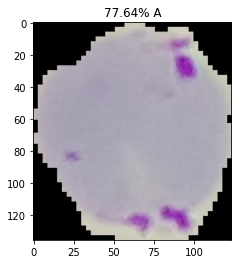

pos/pos4431.jpg


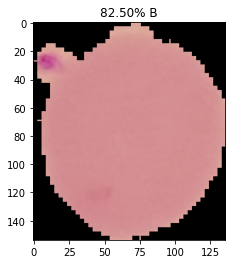

pos/pos4432.jpg


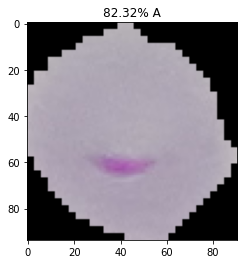

pos/pos4433.jpg


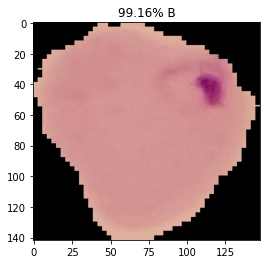

pos/pos4434.jpg


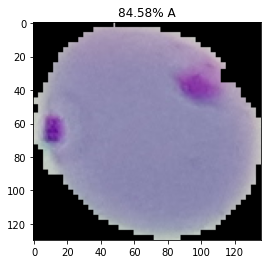

pos/pos4435.jpg


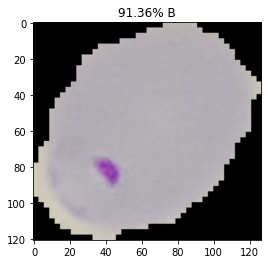

pos/pos4436.jpg


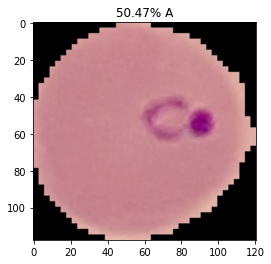

pos/pos4437.jpg


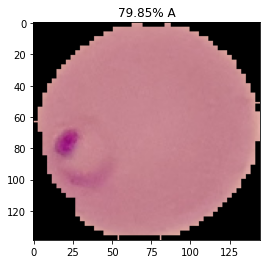

pos/pos4438.jpg


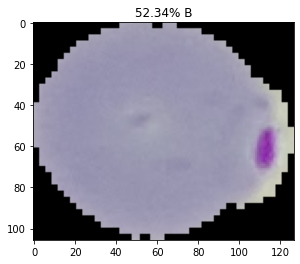

pos/pos4439.jpg


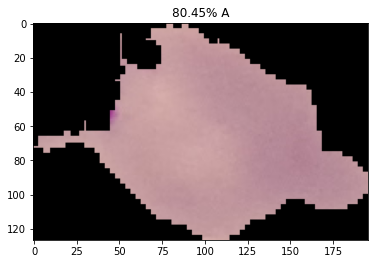

pos/pos4440.jpg


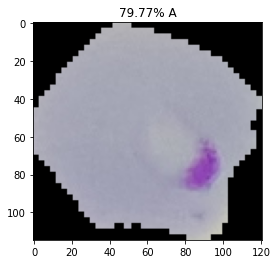

pos/pos4441.jpg


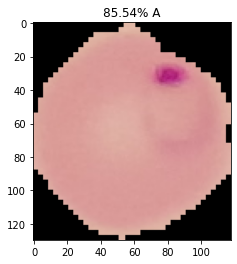

pos/pos4442.jpg


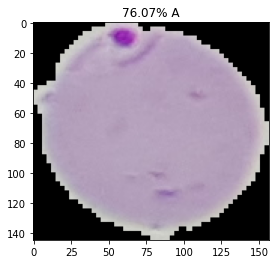

pos/pos4443.jpg


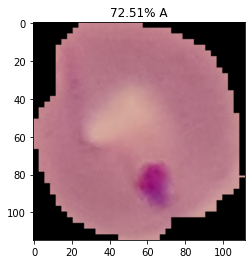

pos/pos4444.jpg


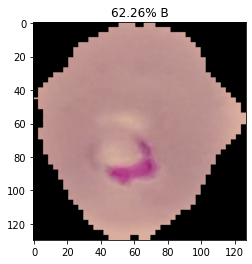

pos/pos4445.jpg


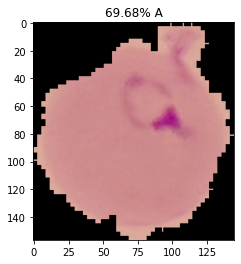

pos/pos4446.jpg


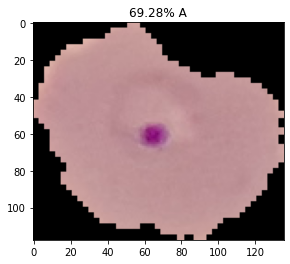

pos/pos4447.jpg


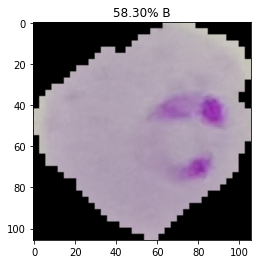

pos/pos4448.jpg


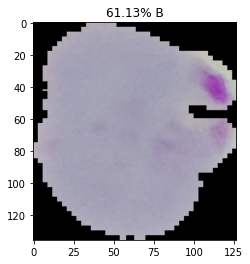

pos/pos4449.jpg


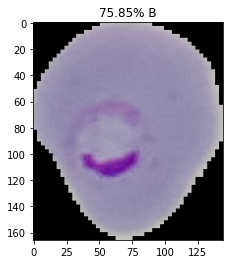

pos/pos4450.jpg


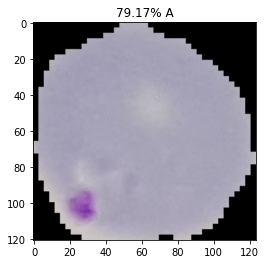

pos/pos4451.jpg


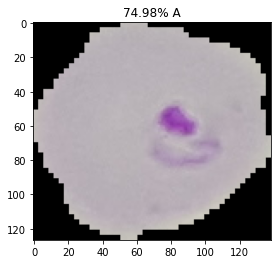

pos/pos4452.jpg


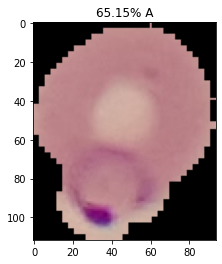

pos/pos4453.jpg


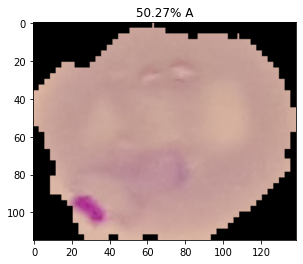

pos/pos4454.jpg


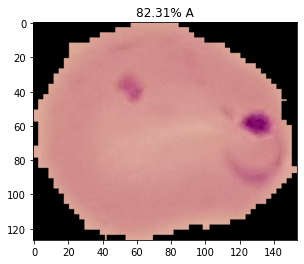

pos/pos4455.jpg


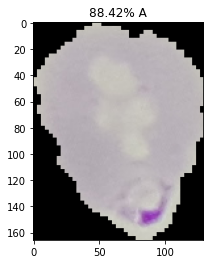

pos/pos4456.jpg


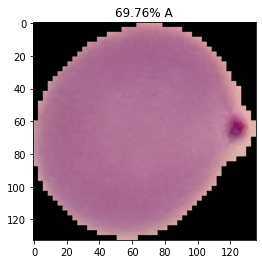

pos/pos4457.jpg


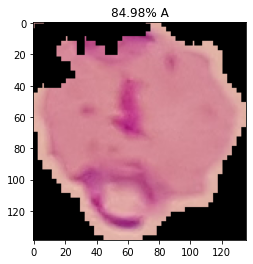

pos/pos4458.jpg


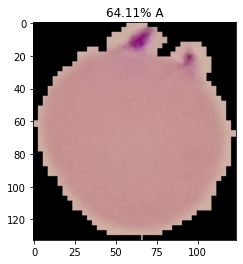

pos/pos4459.jpg


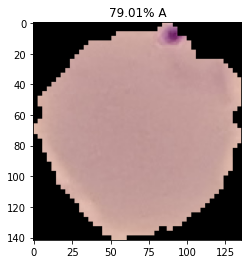

pos/pos4460.jpg


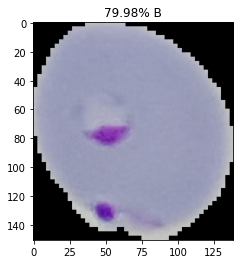

pos/pos4461.jpg


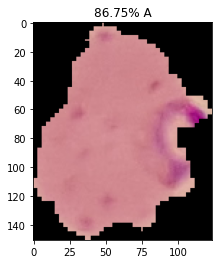

pos/pos4462.jpg


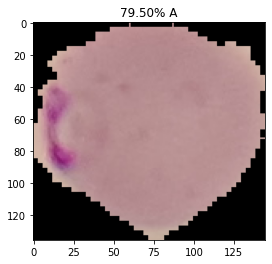

pos/pos4463.jpg


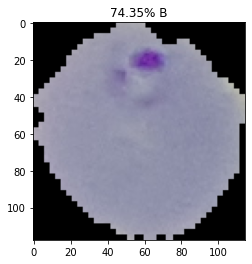

pos/pos4464.jpg


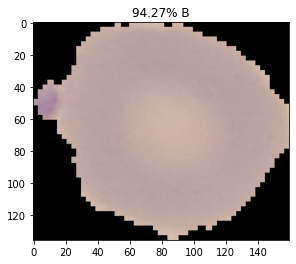

pos/pos4465.jpg


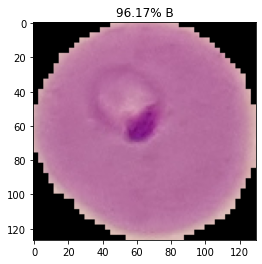

pos/pos4466.jpg


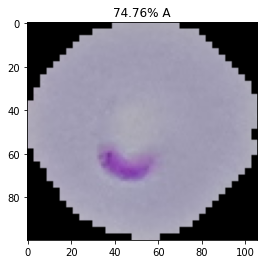

pos/pos4467.jpg


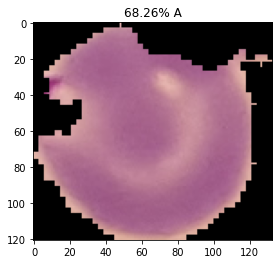

pos/pos4468.jpg


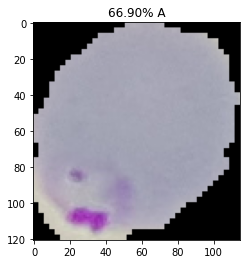

pos/pos4469.jpg


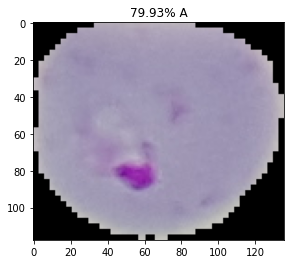

pos/pos4470.jpg


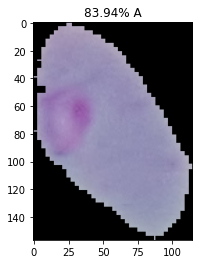

pos/pos4471.jpg


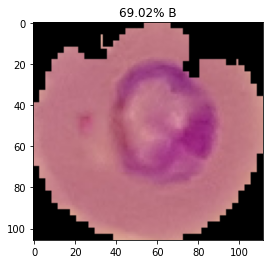

pos/pos4472.jpg


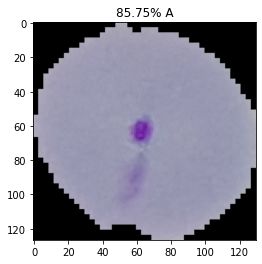

pos/pos4473.jpg


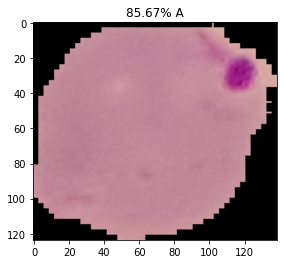

pos/pos4474.jpg


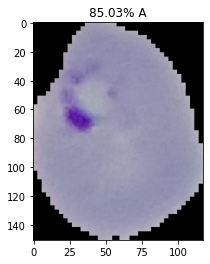

pos/pos4475.jpg


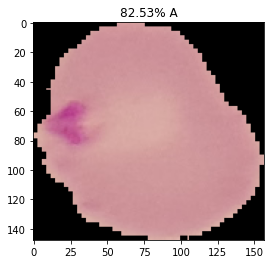

pos/pos4476.jpg


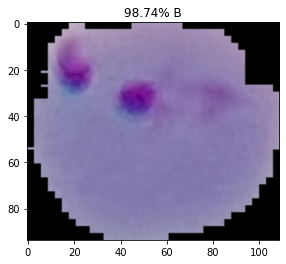

pos/pos4477.jpg


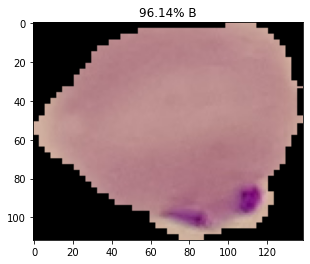

pos/pos4478.jpg


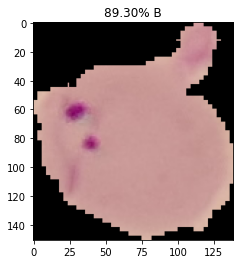

pos/pos4479.jpg


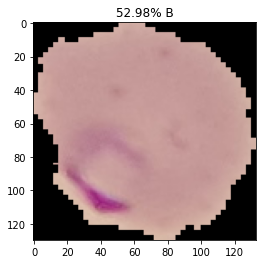

pos/pos4480.jpg


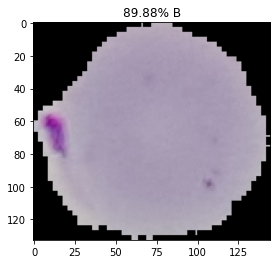

pos/pos4481.jpg


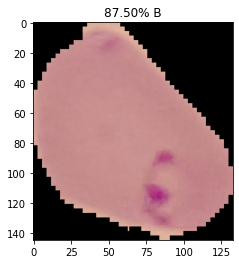

pos/pos4482.jpg


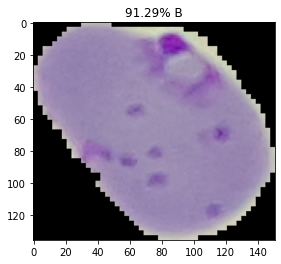

pos/pos4483.jpg


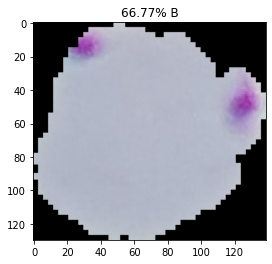

pos/pos4484.jpg


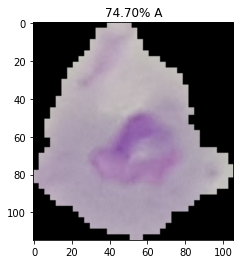

pos/pos4485.jpg


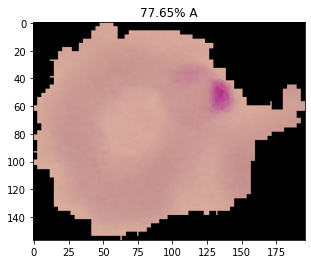

pos/pos4486.jpg


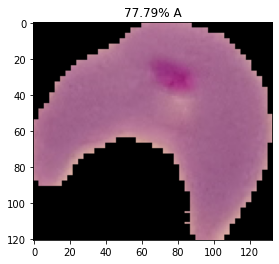

pos/pos4487.jpg


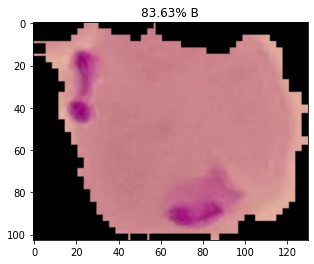

pos/pos4488.jpg


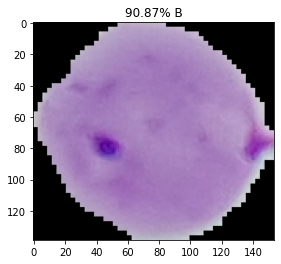

pos/pos4489.jpg


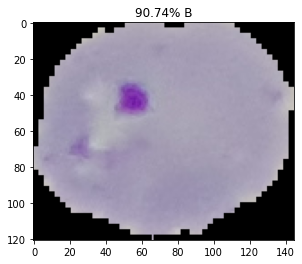

pos/pos4490.jpg


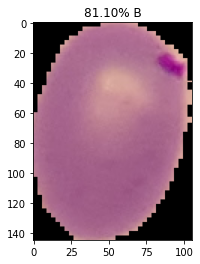

pos/pos4491.jpg


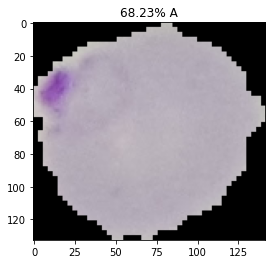

pos/pos4492.jpg


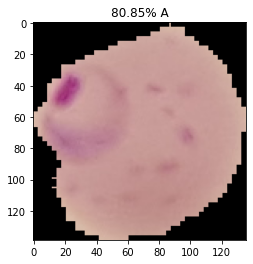

pos/pos4493.jpg


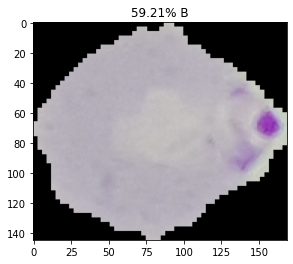

pos/pos4494.jpg


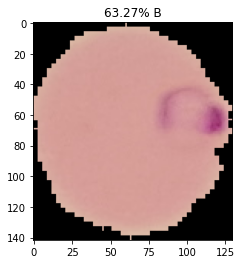

pos/pos4495.jpg


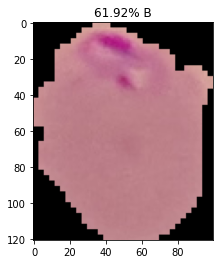

pos/pos4496.jpg


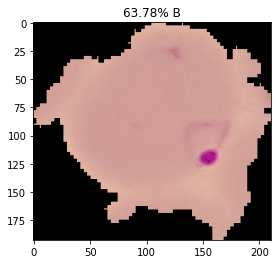

pos/pos4497.jpg


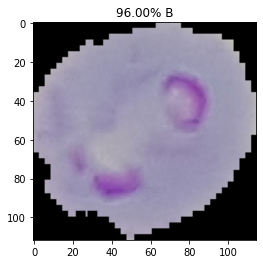

pos/pos4498.jpg


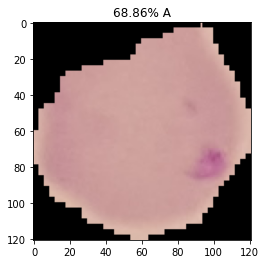

pos/pos4499.jpg


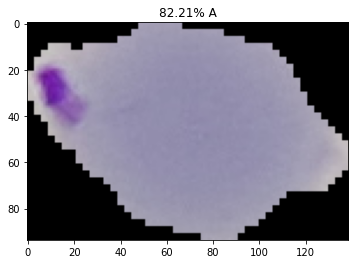

IndexError: list index out of range

In [13]:
eval_datagen = ImageDataGenerator(rescale=1./255)
eval_generator = eval_datagen.flow_from_directory(
        test_dir,target_size=(150, 150),
        batch_size=20,
        class_mode='binary')
eval_generator.reset()    
pred = model.predict_generator(eval_generator,1000,verbose=1)
print("Predictions finished")
  
import matplotlib.image as mpimg
for index, probability in enumerate(pred):
    image_path = test_dir + "/" +eval_generator.filenames[index]
    img = mpimg.imread(image_path)
    
    plt.imshow(img)
    print(eval_generator.filenames[index])
    if probability > 0.5:
        plt.title("%.2f" % (probability[0]*100) + "% B")
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% A")
    plt.show()